# Data Sets

Generating 500 'consistent_layers' images...


  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:00<00:00, 1036.44it/s]


Generating 500 'variable_layers' images...


100%|██████████| 500/500 [00:00<00:00, 905.14it/s] 



Layered pattern dataset generation complete.
Total images generated: 1000
Images saved to layered_geologic_patterns_dataset
Dataset info saved to layered_geologic_patterns_dataset\dataset_info.npy


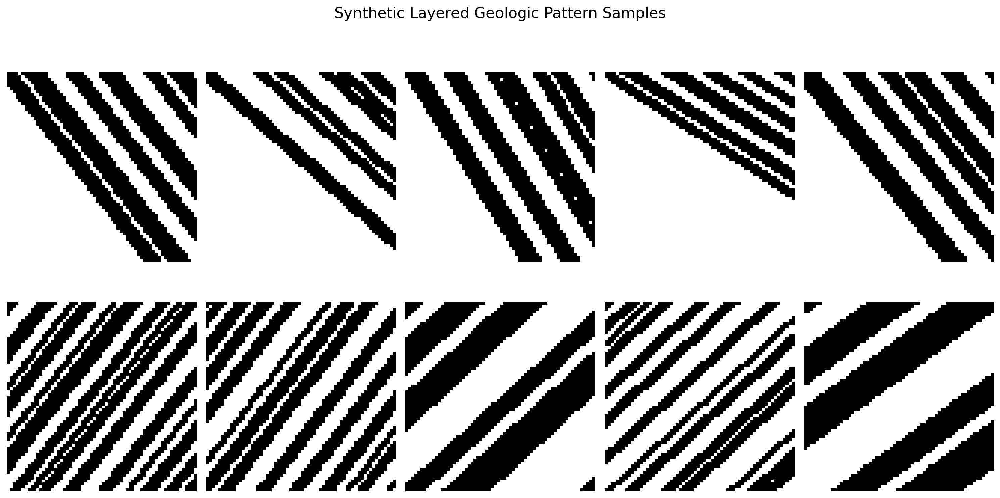

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import os
import random
import shutil
from tqdm import tqdm

def generate_layered_dataset(
    output_dir='layered_geologic_patterns_dataset',
    num_samples_per_class=500,
    image_size=64,
    force_regenerate=False
):
    """
    Generate a dataset of synthetic images with two distinct layered pattern classes:
    1. Consistent layers with moderate orientation and thickness
    2. Highly variable layers with perpendicular orientation and extreme thickness variations
    """
    # Check if dataset already exists
    info_path = os.path.join(output_dir, 'dataset_info.npy')
    if os.path.exists(output_dir) and os.path.exists(info_path) and not force_regenerate:
        print(f"Loading existing dataset from {info_path}")
        try:
            dataset_info = np.load(info_path, allow_pickle=True).item()
            print(f"Successfully loaded dataset with {len(dataset_info['filenames'])} images.")
            return dataset_info
        except Exception as e:
            print(f"Error loading existing dataset: {e}")
            if not force_regenerate:
                print("Set force_regenerate=True to create a new dataset.")
                return None

    # Create output directory structure
    try:
        os.makedirs(output_dir, exist_ok=True)
    except Exception as e:
        print(f"Error creating output directory: {e}")
        return None

    # Define pattern classes and create their directories
    pattern_classes = ['consistent_layers', 'variable_layers']
    for pattern_type in pattern_classes:
        try:
            os.makedirs(os.path.join(output_dir, pattern_type), exist_ok=True)
        except Exception as e:
            print(f"Error creating directory for {pattern_type}: {e}")
            return None

    # Dictionary to store file paths and labels
    dataset_info = {
        'filenames': [],
        'labels': [],
        'label_names': pattern_classes,
        'params': {
            'image_size': image_size,
            'num_samples_per_class': num_samples_per_class
        }
    }

    # Generate images for each pattern class
    for class_idx, pattern_type in enumerate(pattern_classes):
        class_dir = os.path.join(output_dir, pattern_type)
        print(f"Generating {num_samples_per_class} '{pattern_type}' images...")

        for i in tqdm(range(num_samples_per_class)):
            # Create a blank white image
            img = Image.new('L', (image_size, image_size), color=255)
            draw = ImageDraw.Draw(img)

            if pattern_type == 'consistent_layers':
                # Consistent layers: moderate orientation and thickness
                angle_deg = random.uniform(30, 60)
                num_layers = random.randint(5, 8)
                base_thickness = random.randint(max(1, image_size // 15), max(3, image_size // 10))
            else:  # 'variable_layers'
                # Highly variable layers: perpendicular orientation
                angle_deg = random.uniform(120, 150)
                num_layers = random.randint(3, 15)
                base_thickness = random.randint(1, max(5, image_size // 5))

            angle_rad = np.radians(angle_deg)
            current_pos = 0
            
            while current_pos < image_size * 1.5:  # Ensure coverage even for diagonal
                # Slight thickness variation within the same sample
                thickness = max(1, base_thickness + random.randint(-base_thickness//3, base_thickness//3))
                
                # Calculate line coords based on angle and current position offset
                offset_x = current_pos * np.sin(angle_rad)
                offset_y = -current_pos * np.cos(angle_rad)
                
                # Line endpoints extended beyond image boundaries
                x0 = offset_x - image_size * np.cos(angle_rad) * 2
                y0 = offset_y - image_size * np.sin(angle_rad) * 2
                x1 = offset_x + image_size * np.cos(angle_rad) * 2
                y1 = offset_y + image_size * np.sin(angle_rad) * 2
                
                # Draw layer: black lines on white background
                draw.line([(x0, y0), (x1, y1)], fill=0, width=thickness)
                
                # Move to next layer position
                gap_multiplier = 1.5 if pattern_type == 'variable_layers' else 1.0
                gap = random.randint(max(1, thickness // 2), int(thickness * gap_multiplier))
                current_pos += thickness + gap

            # Save the image
            filename = os.path.join(class_dir, f"{pattern_type}_{i:05d}.png")
            try:
                img.save(filename)
                dataset_info['filenames'].append(filename)
                dataset_info['labels'].append(class_idx)
            except Exception as e:
                print(f"Error saving image {filename}: {e}")
                continue

    # Save dataset info
    try:
        np.save(info_path, dataset_info)
        print(f"\nLayered pattern dataset generation complete.")
        print(f"Total images generated: {len(dataset_info['filenames'])}")
        print(f"Images saved to {output_dir}")
        print(f"Dataset info saved to {info_path}")
    except Exception as e:
        print(f"Error saving dataset info: {e}")

    return dataset_info

def visualize_dataset_samples(dataset_info, samples_per_class=5, figure_size=(15, 8)):
    """
    Visualize random samples from each class in the dataset.
    
    Parameters:
    -----------
    dataset_info : dict
        Dictionary containing dataset information
    samples_per_class : int
        Number of samples to display per class
    figure_size : tuple
        Size of the figure to display
    """
    if not dataset_info.get('filenames'):
        print("Error: No filenames found in dataset_info.")
        return

    unique_labels = sorted(list(set(dataset_info.get('labels', []))))
    label_names = dataset_info.get('label_names', [f"Class {i}" for i in unique_labels])
    
    num_classes = len(unique_labels)
    plt.figure(figsize=figure_size)
    
    # For each class
    for i, label in enumerate(unique_labels):
        # Get indices of this class
        indices = [j for j, l in enumerate(dataset_info['labels']) if l == label]
        
        # Select random samples
        sample_indices = random.sample(indices, min(samples_per_class, len(indices)))
        
        # Plot each sample
        for j, idx in enumerate(sample_indices):
            img_path = dataset_info['filenames'][idx]
            img = Image.open(img_path)
            
            ax = plt.subplot(num_classes, samples_per_class, i * samples_per_class + j + 1)
            ax.imshow(img, cmap='gray')
            
            # Add class label only to the first image of each row
            if j == 0:
                ax.set_ylabel(label_names[label], fontsize=12, rotation=0, labelpad=40, ha='right', va='center')

            ax.set_xticks([])
            ax.set_yticks([])
            ax.axis('off')

    plt.suptitle("Synthetic Layered Geologic Pattern Samples", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    plt.show()

# Example usage:
if __name__ == "__main__":
    output_dir = 'layered_geologic_patterns_dataset'
    
    # Generate dataset
    dataset_info = generate_layered_dataset(
        output_dir=output_dir,
        num_samples_per_class=500,  # Reduced for faster example run
        image_size=64,
        force_regenerate=True
    )
    
    # Visualize samples
    if dataset_info and dataset_info.get('filenames'):
        visualize_dataset_samples(dataset_info, samples_per_class=5)
    else:
        print("Dataset generation failed. No files to visualize.")

Loading dataset...
Dataset contains 2 classes: ['consistent_layers', 'variable_layers']
Preparing all 1000 images for t-SNE...
Running t-SNE on all 1000 images of dimension 4096...
This might take a while...


c:\Users\cjh5690.PSU\Anaconda3\envs\Hoydic2025b\Lib\site-packages\sklearn\manifold\_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE completed in 3.17 seconds
Silhouette score on t-SNE embedding: 0.5699


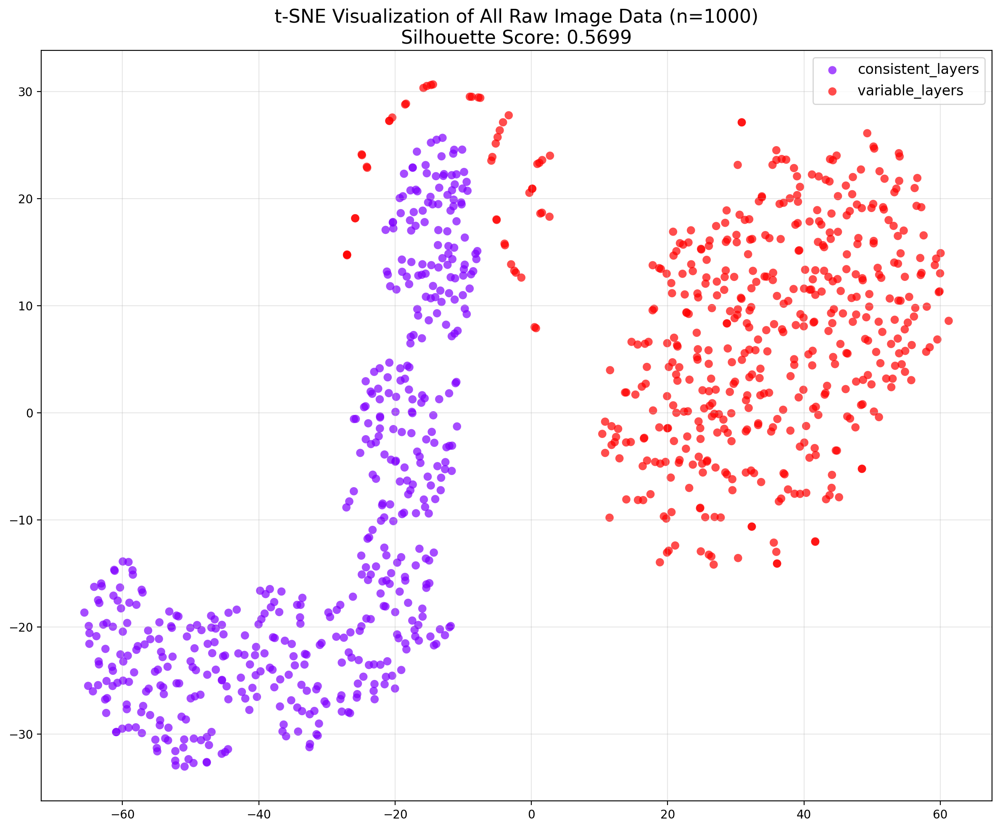

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from PIL import Image
import torch
import os
import time

def visualize_raw_data_tsne(dataset_path='layered_geologic_patterns_dataset/dataset_info.npy', random_state=42):
    """
    Create a t-SNE visualization of all raw image data (not latent representations).
    
    Args:
        dataset_path: Path to the dataset info file
        random_state: Random seed for reproducibility
    """
    print("Loading dataset...")
    if not os.path.exists(dataset_path):
        raise FileNotFoundError(f"Dataset not found at {dataset_path}")
    
    # Load dataset info
    dataset_info = np.load(dataset_path, allow_pickle=True).item()
    
    # Get class names
    class_names = dataset_info.get('label_names', [f"Class {i}" for i in range(len(np.unique(dataset_info['labels'])))])
    print(f"Dataset contains {len(class_names)} classes: {class_names}")
    
    # Use all available samples
    total_samples = len(dataset_info['filenames'])
    sample_indices = np.arange(total_samples)
    
    print(f"Preparing all {total_samples} images for t-SNE...")
    
    # Load images and flatten them
    images = []
    labels = []
    
    for idx in sample_indices:
        # Load image
        img_path = dataset_info['filenames'][idx]
        img = Image.open(img_path).convert('L')  # Convert to grayscale
        
        # Flatten the image to a 1D vector
        img_array = np.array(img).flatten() / 255.0  # Normalize to [0, 1]
        
        images.append(img_array)
        labels.append(dataset_info['labels'][idx])
    
    # Convert to numpy arrays
    X = np.array(images)
    y = np.array(labels)
    
    print(f"Running t-SNE on all {X.shape[0]} images of dimension {X.shape[1]}...")
    print("This might take a while...")
    
    # Apply t-SNE
    start_time = time.time()
    tsne = TSNE(n_components=2, perplexity=min(30, len(X)-1), n_iter=1000, random_state=random_state)
    X_tsne = tsne.fit_transform(X)
    elapsed = time.time() - start_time
    print(f"t-SNE completed in {elapsed:.2f} seconds")
    
    # Calculate silhouette score on t-SNE results
    silhouette = silhouette_score(X_tsne, y)
    print(f"Silhouette score on t-SNE embedding: {silhouette:.4f}")
    
    # Visualize the t-SNE embedding
    plt.figure(figsize=(12, 10))
    
    # Plot each class with a different color
    unique_labels = np.unique(y)
    colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_labels)))
    
    for i, label in enumerate(unique_labels):
        mask = y == label
        plt.scatter(
            X_tsne[mask, 0], X_tsne[mask, 1],
            c=[colors[i]],
            label=class_names[label],
            alpha=0.7,
            s=50,
            edgecolors='none'
        )
    
    # Add silhouette score to title
    title = f't-SNE Visualization of All Raw Image Data (n={len(X)})'
    title += f'\nSilhouette Score: {silhouette:.4f}'
    
    plt.title(title, fontsize=16)
    plt.legend(fontsize=12)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return X_tsne, y, silhouette

if __name__ == "__main__":
    # Run the visualization
    X_tsne, y, silhouette = visualize_raw_data_tsne()
    
    # You can save the result for later analysis if needed
    # np.save('raw_tsne_embedding.npy', {'embedding': X_tsne, 'labels': y, 'silhouette': silhouette})

# Auto Encoder Models

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from PIL import Image
import os
import time
import glob
import json

# ==============================================
# MODEL DEFINITIONS - Improved architectures
# ==============================================

class SimpleLinearAutoencoder(nn.Module):
    def __init__(self, input_size=64*64, latent_dim=10):
        super(SimpleLinearAutoencoder, self).__init__()
        # Encoder (simple linear layers)
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(input_size, 128),
            nn.ReLU(),
            nn.Linear(128, latent_dim)
        )
        
        # Decoder (simple linear layers)
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.ReLU(),
            nn.Linear(128, input_size),
            nn.Sigmoid(),
            nn.Unflatten(1, (1, 64, 64))  # Reshape back to image dimensions
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


class DeeperLinearAutoencoder(nn.Module):
    def __init__(self, input_size=64*64, latent_dim=10):
        super(DeeperLinearAutoencoder, self).__init__()
        # Encoder with more layers
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(input_size, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, latent_dim)
        )
        
        # Decoder with more layers
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, input_size),
            nn.Sigmoid(),
            nn.Unflatten(1, (1, 64, 64))
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


class ConvAutoencoder(nn.Module):
    def __init__(self, input_channels=1, latent_dim=10):
        super(ConvAutoencoder, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(input_channels, 16, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            # Second convolutional layer
            nn.Conv2d(16, 32, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            # Third convolutional layer
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
        )
        
        # Calculate the size of the flattened features after convolutions
        # For 64x64 input with 3 stride-2 convs: 64 -> 32 -> 16 -> 8
        # So the flattened size is 64 channels * 8 * 8 = 4096
        self.flatten_size = 64 * 8 * 8
        
        # Latent space mapping
        self.fc_encoder = nn.Linear(self.flatten_size, latent_dim)
        self.fc_decoder = nn.Linear(latent_dim, self.flatten_size)
        
        # Decoder
        self.decoder = nn.Sequential(
            # First transpose convolutional layer
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            # Second transpose convolutional layer
            nn.ConvTranspose2d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            # Third transpose convolutional layer
            nn.ConvTranspose2d(16, input_channels, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        # Encode
        x = self.encoder(x)
        
        # Flatten and project to latent space
        x_flattened = x.view(x.size(0), -1)
        encoded = self.fc_encoder(x_flattened)
        
        # Project from latent space and reshape
        x_projected = self.fc_decoder(encoded)
        x_reshaped = x_projected.view(x.size(0), 64, 8, 8)
        
        # Decode
        decoded = self.decoder(x_reshaped)
        
        return encoded, decoded


class DeeperConvAutoencoder(nn.Module):
    """
    An improved convolutional autoencoder with:
    1. An additional conv/deconv layer for deeper feature learning
    2. More channels per layer (32, 64, 128, 256 vs 16, 32, 64)
    3. Mixture of 3x3 and 5x5 kernels to capture different spatial contexts
    """
    def __init__(self, input_channels=1, latent_dim=32):
        super(DeeperConvAutoencoder, self).__init__()
        
        # Encoder with larger filters and more channels
        self.encoder = nn.Sequential(
            # First convolutional layer with larger 5x5 kernel to capture more spatial context
            nn.Conv2d(input_channels, 32, kernel_size=5, stride=2, padding=2),
            nn.ReLU(),
            
            # Second convolutional layer
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            
            # Third convolutional layer
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            
            # Fourth convolutional layer (new)
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
        )
        
        # Calculate the size of the flattened features after convolutions
        # For 64x64 input with 4 stride-2 convs: 64 -> 32 -> 16 -> 8 -> 4
        # So the flattened size is 256 channels * 4 * 4 = 4096
        self.flatten_size = 256 * 4 * 4
        
        # Latent space mapping with an additional non-linearity
        self.fc_encoder = nn.Sequential(
            nn.Linear(self.flatten_size, 512),
            nn.ReLU(),
            nn.Linear(512, latent_dim)
        )
        
        self.fc_decoder = nn.Sequential(
            nn.Linear(latent_dim, 512),
            nn.ReLU(),
            nn.Linear(512, self.flatten_size)
        )
        
        # Decoder with matching architecture
        self.decoder = nn.Sequential(
            # First transpose convolutional layer
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Second transpose convolutional layer
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Third transpose convolutional layer
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Fourth transpose convolutional layer with larger kernel to match the encoder
            nn.ConvTranspose2d(32, input_channels, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        # Encode
        x = self.encoder(x)
        
        # Flatten and project to latent space
        x_flattened = x.view(x.size(0), -1)
        encoded = self.fc_encoder(x_flattened)
        
        # Project from latent space and reshape
        x_projected = self.fc_decoder(encoded)
        x_reshaped = x_projected.view(x.size(0), 256, 4, 4)
        
        # Decode
        decoded = self.decoder(x_reshaped)
        
        return encoded, decoded


# Dictionary mapping architecture names to model classes
MODEL_ARCHITECTURES = {
    'simple_linear': SimpleLinearAutoencoder,
    'deeper_linear': DeeperLinearAutoencoder,
    'convolutional': ConvAutoencoder,
    'deeper_convolutional': DeeperConvAutoencoder  # Added the new deeper CNN model
}


# ==============================================
# DATASET HANDLER
# ==============================================

class ShapeDataset(Dataset):
    def __init__(self, dataset_info):
        """
        Initialize the dataset.
        
        Args:
            dataset_info: Either a path to the dataset directory or a dictionary
                         containing 'filenames' and 'labels'
        """
        # Check if dataset_info is a string (directory path) or a dictionary
        if isinstance(dataset_info, dict):
            # It's already a dictionary with filenames and labels
            self.filenames = dataset_info['filenames']
            self.labels = dataset_info['labels']
            self.from_directory = False
        else:
            # It's a directory path - load from there
            self.dataset_dir = dataset_info
            self.classes = self._get_classes()
            self.filenames = []
            self.labels = []
            self._load_from_directory()
            self.from_directory = True
    
    def _get_classes(self):
        """Get class folders in the dataset directory"""
        class_dirs = [d for d in os.listdir(self.dataset_dir) 
                if os.path.isdir(os.path.join(self.dataset_dir, d))]
        print(f"Found classes: {class_dirs}")
        return class_dirs
    
    def _load_from_directory(self):
        """Load all images from the directory structure"""
        for i, class_name in enumerate(self.classes):
            class_dir = os.path.join(self.dataset_dir, class_name)
            class_files = glob.glob(os.path.join(class_dir, '*.png'))
            
            for file in class_files:
                self.filenames.append(file)
                self.labels.append(i)
    
    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        img_path = self.filenames[idx]
        img = Image.open(img_path).convert('L')  # Convert to grayscale
        label = self.labels[idx]
        
        # Transform to tensor and normalize
        img = np.array(img)
        img = img / 255.0  # Normalize to [0, 1]
        img = torch.tensor(img).float().unsqueeze(0)  # Add channel dimension [1, H, W]
        
        return img, img, label  # Return (input, target, label)

# ==============================================
# DATA CONSISTENCY UTILITIES
# ==============================================

def seed_worker(worker_id):
    """
    Function to ensure DataLoader workers have deterministic behavior
    """
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)

def create_and_save_consistent_split(dataset_info, test_ratio=0.2, seed=42, split_path="data_split.json"):
    """
    Create and save a consistent train/test split for reproducibility
    
    Args:
        dataset_info: Dataset information dict with filenames and labels
        test_ratio: Proportion of data to use for testing
        seed: Random seed for reproducibility
        split_path: Path to save the split indices
        
    Returns:
        Dictionary with train and test indices
    """
    # Set random seed for reproducibility
    np.random.seed(seed)
    
    total_samples = len(dataset_info['filenames'])
    indices = np.random.permutation(total_samples)
    split_idx = int(total_samples * (1 - test_ratio))
    
    train_indices = indices[:split_idx].tolist()
    test_indices = indices[split_idx:].tolist()
    
    # Create split info dictionary
    split_info = {
        'train_indices': train_indices,
        'test_indices': test_indices,
        'seed': seed,
        'test_ratio': test_ratio,
        'created_at': time.strftime("%Y-%m-%d %H:%M:%S")
    }
    
    # Save to file
    with open(split_path, 'w') as f:
        json.dump(split_info, f)
    
    print(f"Data split saved to {split_path}: {len(train_indices)} training samples, {len(test_indices)} test samples")
    return split_info

def load_or_create_data_split(dataset_info, split_path="data_split.json", test_ratio=0.2, seed=42):
    """
    Load an existing data split or create a new one if it doesn't exist
    
    Args:
        dataset_info: Dataset information with filenames and labels
        split_path: Path to the split file
        test_ratio: Proportion of data to use for testing
        seed: Random seed for reproducibility
        
    Returns:
        Dictionary with train and test indices
    """
    if os.path.exists(split_path):
        with open(split_path, 'r') as f:
            split_info = json.load(f)
        print(f"Loaded existing data split from {split_path}")
        return split_info
    else:
        return create_and_save_consistent_split(dataset_info, test_ratio, seed, split_path)

def get_train_test_data(dataset_info, split_info):
    """
    Create train and test dataset info based on split indices
    
    Args:
        dataset_info: Dataset information with filenames and labels
        split_info: Dictionary with train and test indices
        
    Returns:
        Tuple of (train_info, test_info) dictionaries
    """
    train_indices = split_info['train_indices']
    test_indices = split_info['test_indices']
    
    train_info = {
        'filenames': [dataset_info['filenames'][i] for i in train_indices],
        'labels': [dataset_info['labels'][i] for i in train_indices]
    }
    
    test_info = {
        'filenames': [dataset_info['filenames'][i] for i in test_indices],
        'labels': [dataset_info['labels'][i] for i in test_indices]
    }
    
    return train_info, test_info

# ==============================================
# VISUALIZATION FUNCTIONS
# ==============================================

def plot_with_labels(low_dim_embs, labels, class_names=None, title="t-SNE Visualization", ax=None):
    """
    Plot t-SNE data with color-coded labels on a given axis
    
    Args:
        low_dim_embs: Low-dimensional embeddings from t-SNE
        labels: Class labels for each point
        class_names: List of class names for the legend
        title: Plot title
        ax: Matplotlib axis to plot on (if None, creates a new figure)
    """
    if ax is None:
        plt.figure(figsize=(10, 8))
        ax = plt.gca()
        
    unique_labels = np.unique(labels)
    # Use tab10 colormap for consistent visualization
    colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_labels)))#colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    
    for i, label in enumerate(unique_labels):
        mask = labels == label
        ax.scatter(
            low_dim_embs[mask, 0], 
            low_dim_embs[mask, 1],
            c=[colors[i]],
            label=class_names[label] if class_names is not None else f'Class {label}',
            alpha=0.7
        )
    
    ax.legend()
    ax.set_title(title, fontsize=14)
    ax.grid(alpha=0.3)
    return ax


def visualize_reconstructions(model, test_data, test_labels, class_names=None, n_samples=10, device='cpu', view_indices=None):
    """Visualize original images and their reconstructions"""
    model.eval()
    
    if view_indices is not None:
        # Use the same indices as during training
        view_data = test_data[view_indices].to(device)
        view_labels = test_labels[view_indices] if test_labels is not None else None
    else:
        # Fallback to first n_samples
        n_samples = min(n_samples, len(test_data))
        view_data = test_data[:n_samples].to(device)
        view_labels = test_labels[:n_samples] if test_labels is not None else None
    
    with torch.no_grad():
        _, decoded_data = model(view_data)
    
    # Use a simple two-row layout: original images on top, reconstructions on bottom
    n_images = len(view_data)
    f, a = plt.subplots(2, n_images, figsize=(n_images * 2, 4))
    plt.subplots_adjust(wspace=0.1, hspace=0.2)
    
    # Add a title to the figure
    plt.suptitle(f'Original (top) vs. Reconstructed (bottom)', fontsize=14)
    
    # Original images on top row
    for i in range(n_images):
        a[0][i].imshow(view_data[i, 0].cpu().numpy(), cmap='gray')
        a[0][i].set_xticks(())
        a[0][i].set_yticks(())
        
        # If available, add small class labels
        if class_names is not None and view_labels is not None and i < len(view_labels):
            class_idx = view_labels[i].item()
            if i == 0:
                a[0][i].set_ylabel("Original", fontsize=10)
            a[0][i].set_title(class_names[class_idx], fontsize=8)
    
    # Reconstructed images on bottom row
    for i in range(n_images):
        a[1][i].imshow(decoded_data[i, 0].cpu().numpy(), cmap='gray')
        a[1][i].set_xticks(())
        a[1][i].set_yticks(())
        if i == 0:
            a[1][i].set_ylabel("Reconstructed", fontsize=10)
    
    plt.tight_layout()
    plt.show()


def visualize_dual_reconstructions(model, train_data, train_labels, test_data, test_labels, 
                                 class_names=None, n_samples=5, device='cpu', view_indices=None):
    """
    Visualize reconstructions from both training and test data side by side
    
    Args:
        model: Trained autoencoder model
        train_data: Tensor of training data
        train_labels: Tensor of training labels
        test_data: Tensor of test data
        test_labels: Tensor of test labels
        class_names: List of class names for labels
        n_samples: Number of samples to show from each dataset
        device: Device to run model on
        view_indices: Specific indices to view (if None, uses first n_samples)
    """
    model.eval()
    
    # Process view indices or use defaults
    if view_indices is not None:
        train_view_indices = view_indices[:len(view_indices)//2]
        test_view_indices = view_indices[len(view_indices)//2:]
        
        train_view_data = train_data[train_view_indices].to(device)
        train_view_labels = train_labels[train_view_indices] if train_labels is not None else None
        
        test_view_data = test_data[test_view_indices].to(device)
        test_view_labels = test_labels[test_view_indices] if test_labels is not None else None
    else:
        # Use first n_samples from each dataset
        n_train = min(n_samples, len(train_data))
        n_test = min(n_samples, len(test_data))
        
        train_view_data = train_data[:n_train].to(device)
        train_view_labels = train_labels[:n_train] if train_labels is not None else None
        
        test_view_data = test_data[:n_test].to(device)
        test_view_labels = test_labels[:n_test] if test_labels is not None else None
    
    # Generate reconstructions
    with torch.no_grad():
        _, train_decoded = model(train_view_data)
        _, test_decoded = model(test_view_data)
    
    # Create figure with 4 rows: train original, train reconstructed, test original, test reconstructed
    n_train_images = len(train_view_data)
    n_test_images = len(test_view_data)
    max_images = max(n_train_images, n_test_images)
    
    # Create appropriate figure size
    fig_width = max_images * 2
    fig, axes = plt.subplots(4, max_images, figsize=(fig_width, 8))
    plt.subplots_adjust(wspace=0.1, hspace=0.3)
    
    # Add a title to the figure
    plt.suptitle(f'Train (top) vs. Test (bottom) Reconstructions', fontsize=14)
    
    # Train original images (row 0)
    for i in range(max_images):
        if i < n_train_images:
            axes[0][i].imshow(train_view_data[i, 0].cpu().numpy(), cmap='gray')
            
            # If available, add class labels as text below images
            if class_names is not None and train_view_labels is not None:
                class_idx = train_view_labels[i].item()
                class_text = class_names[class_idx] if class_idx < len(class_names) else f"Class {class_idx}"
                axes[0][i].text(32, 70, class_text, fontsize=8, ha="center")
        
        axes[0][i].set_xticks([])
        axes[0][i].set_yticks([])
        
        if i == 0:
            axes[0][i].set_ylabel("Train Original", fontsize=10)
    
    # Train reconstructed images (row 1)
    for i in range(max_images):
        if i < n_train_images:
            axes[1][i].imshow(train_decoded[i, 0].cpu().numpy(), cmap='gray')
        
        axes[1][i].set_xticks([])
        axes[1][i].set_yticks([])
        
        if i == 0:
            axes[1][i].set_ylabel("Train Recon", fontsize=10)
    
    # Test original images (row 2)
    for i in range(max_images):
        if i < n_test_images:
            axes[2][i].imshow(test_view_data[i, 0].cpu().numpy(), cmap='gray')
            
            # If available, add class labels as text below images
            if class_names is not None and test_view_labels is not None:
                class_idx = test_view_labels[i].item()
                class_text = class_names[class_idx] if class_idx < len(class_names) else f"Class {class_idx}"
                axes[2][i].text(32, 70, class_text, fontsize=8, ha="center")
        
        axes[2][i].set_xticks([])
        axes[2][i].set_yticks([])
        
        if i == 0:
            axes[2][i].set_ylabel("Test Original", fontsize=10)
    
    # Test reconstructed images (row 3)
    for i in range(max_images):
        if i < n_test_images:
            axes[3][i].imshow(test_decoded[i, 0].cpu().numpy(), cmap='gray')
        
        axes[3][i].set_xticks([])
        axes[3][i].set_yticks([])
        
        if i == 0:
            axes[3][i].set_ylabel("Test Recon", fontsize=10)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Make space for the suptitle
    plt.show()


def visualize_latent_space(model, train_data, train_labels, test_data, test_labels, 
                           class_names=None, device='cpu', max_samples=5000, perplexity=30):
    """
    Generate and visualize t-SNE projection of the latent space with silhouette scores
    for both train and test data side by side
    """
    model.eval()
    with torch.no_grad():
        # Process training data
        encoded_train, _ = model(train_data.to(device))
        encoded_train = encoded_train.view(encoded_train.size(0), -1).detach().cpu().numpy()
        
        # Process test data
        encoded_test, _ = model(test_data.to(device))
        encoded_test = encoded_test.view(encoded_test.size(0), -1).detach().cpu().numpy()
    
    # Set up figure with two subplots for train and test data
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
    
    # Process train data
    plot_only_train = min(max_samples, encoded_train.shape[0])
    tsne_train = TSNE(perplexity=perplexity, n_components=2, init='pca', max_iter=5000, random_state=42)
    low_dim_embs_train = tsne_train.fit_transform(encoded_train[:plot_only_train])
    train_labels_subset = train_labels.numpy()[:plot_only_train]
    
    # Calculate train silhouette score if there's more than one class
    train_title = "Train Data t-SNE"
    train_score = None
    if len(np.unique(train_labels_subset)) > 1:
        try:
            train_score = silhouette_score(low_dim_embs_train, train_labels_subset)
            print(f"Train t-SNE Silhouette Score: {train_score:.3f}")
            train_title = f"Train Data t-SNE (Silhouette: {train_score:.3f})"
        except Exception as e:
            print(f"Could not calculate train silhouette score: {e}")
    
    # Process test data
    plot_only_test = min(max_samples, encoded_test.shape[0])
    tsne_test = TSNE(perplexity=perplexity, n_components=2, init='pca', max_iter=5000, random_state=42)
    low_dim_embs_test = tsne_test.fit_transform(encoded_test[:plot_only_test])
    test_labels_subset = test_labels.numpy()[:plot_only_test]
    
    # Calculate test silhouette score if there's more than one class
    test_title = "Test Data t-SNE"
    test_score = None
    if len(np.unique(test_labels_subset)) > 1:
        try:
            test_score = silhouette_score(low_dim_embs_test, test_labels_subset)
            print(f"Test t-SNE Silhouette Score: {test_score:.3f}")
            test_title = f"Test Data t-SNE (Silhouette: {test_score:.3f})"
        except Exception as e:
            print(f"Could not calculate test silhouette score: {e}")
    
    # Plot both visualizations
    plot_with_labels(low_dim_embs_train, train_labels_subset, class_names, train_title, ax=ax1)
    plot_with_labels(low_dim_embs_test, test_labels_subset, class_names, test_title, ax=ax2)
    
    plt.tight_layout()
    plt.show()
    
    return {
        'train': (low_dim_embs_train, train_labels_subset, train_score),
        'test': (low_dim_embs_test, test_labels_subset, test_score)
    }
# Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Create experiment name if not provided
    if experiment_name is None:
        timestamp = time.strftime("%Y%m%d_%H%M%S")
        experiment_name = f"{architecture_name}_{latent_dim}d_{timestamp}"
    
    # Get the model architecture
    if architecture_name not in MODEL_ARCHITECTURES:
        raise ValueError(f"Unknown architecture: {architecture_name}. Available: {list(MODEL_ARCHITECTURES.keys())}")
    
    # Create the model
    model_class = MODEL_ARCHITECTURES[architecture_name]
    
    # Handle different model initializations
    if architecture_name in ['convolutional', 'deeper_convolutional']:
        model = model_class(input_channels=1, latent_dim=latent_dim)
    else:
        model = model_class(input_size=64*64, latent_dim=latent_dim)
    
    print(f"Created model: {model.__class__.__name__} with latent dimension {latent_dim}")
    
    # Check if we've been provided with pre-loaded data
    if train_loader is None or test_data is None or test_labels is None:
        # We need to load the data from dataset_info or dataset_path
        
        # Load dataset if needed
        if dataset_info is None and dataset_path is not None:
            if os.path.exists(dataset_path):
                print(f"Loading dataset from {dataset_path}")
                dataset_info = np.load(dataset_path, allow_pickle=True).item()
            else:
                raise FileNotFoundError(f"Dataset not found at {dataset_path} and no dataset_info provided")
        elif dataset_info is None and dataset_path is None:
            raise ValueError("Either dataset_info or dataset_path must be provided")
        
        # Create train/test split
        total_samples = len(dataset_info['filenames'])
        indices = np.random.permutation(total_samples)
        split_idx = int(total_samples * 0.8)  # 80% for training
        
        train_indices = indices[:split_idx]
        test_indices = indices[split_idx:]
        
        # Create separate dataset info for train and test
        train_info = {
            'filenames': [dataset_info['filenames'][i] for i in train_indices],
            'labels': [dataset_info['labels'][i] for i in train_indices]
        }
        
        test_info = {
            'filenames': [dataset_info['filenames'][i] for i in test_indices],
            'labels': [dataset_info['labels'][i] for i in test_indices]
        }
        
        # Get the class names for visualization if not provided
        if class_names is None:
            class_names = dataset_info.get('label_names', [f"Class {i}" for i in range(len(np.unique(dataset_info['labels'])))])
        
        print(f"Shape classes: {class_names}")
        
        # Create datasets and dataloaders
        train_dataset = ShapeDataset(train_info)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        
        # Load test data into memory for visualization
        test_dataset = ShapeDataset(test_info)
        all_test_data = []
        all_test_labels = []
        
        for i in range(len(test_dataset)):
            img, _, label = test_dataset[i]
            all_test_data.append(img)
            all_test_labels.append(label)
        
        test_data = torch.stack(all_test_data)
        test_labels = torch.tensor(all_test_labels)
    else:
        # We already have pre-loaded data
        print("Using pre-loaded data")
    
    # Train the model
    trained_model, history = train_autoencoder(
        model=model,
        train_loader=train_loader,
        test_data=test_data,
        test_labels=test_labels,
        epochs=epochs,
        learning_rate=learning_rate,
        device=device,
        class_names=class_names,
        experiment_name=experiment_name,
        output_dir=output_dir,
        calculate_train_silhouette=calculate_train_silhouette,
        calculate_test_silhouette=calculate_test_silhouette
    )
    
    # Visualize final results if requested
    if visualize_final:
        print("Generating final visualizations...")
        # Use the same view indices as used during training
        view_indices = history.get('view_indices')
        visualize_reconstructions(
            trained_model, test_data, test_labels, 
            class_names=class_names, device=device,
            view_indices=view_indices
        )
        
        # Collect some training data for visualization if not already available
        train_data_tensor = None
        train_labels_tensor = None
        
        if calculate_train_silhouette:
            for batch in train_loader:
                if len(batch) == 3:
                    x, _, labels = batch
                elif len(batch) == 2:
                    x, _ = batch
                    labels = None
                else:
                    continue
                    
                # Initialize or concatenate tensors
                if train_data_tensor is None:
                    train_data_tensor = x.clone()
                    train_labels_tensor = labels.clone() if labels is not None else None
                else:
                    train_data_tensor = torch.cat((train_data_tensor, x), 0)
                    if labels is not None and train_labels_tensor is not None:
                        train_labels_tensor = torch.cat((train_labels_tensor, labels), 0)
                
                # Limit to max_samples to prevent memory issues
                if train_data_tensor.size(0) >= 500:
                    break
        
        # Visualize latent space
        results = visualize_latent_space(
            trained_model, 
            train_data_tensor if train_data_tensor is not None else test_data, 
            train_labels_tensor if train_labels_tensor is not None else test_labels,
            test_data, 
            test_labels,
            class_names=class_names, 
            device=device
        )
    
    return trained_model, history


# ==============================================
# EVALUATION UTILITIES
# ==============================================

def memory_efficient_evaluation(model, test_data, loss_func, batch_size=64, device='cpu'):
    """Evaluate model on test data in a memory-efficient way"""
    model.eval()
    n_samples = test_data.size(0)
    total_loss = 0.0
    
    with torch.no_grad():
        for i in range(0, n_samples, batch_size):
            batch = test_data[i:i+batch_size].to(device)
            encoded, decoded = model(batch)
            loss = loss_func(decoded, batch)
            total_loss += loss.item() * batch.size(0)
    
    avg_loss = total_loss / n_samples
    return avg_loss, None, None  # Return placeholders for compatibility

# ==============================================
# TRAINER FUNCTION
# ==============================================
def train_autoencoder(model, train_loader, test_data, test_labels, 
                      epochs=10, 
                      learning_rate=0.001,
                      loss_func=nn.MSELoss(),
                      device='cpu',
                      class_names=None,
                      visualization_interval=500,
                      num_visualizations=5,  # Default to 5 equally spaced visualizations
                      save_model=True,
                      experiment_name=None,
                      output_dir=None,
                      calculate_train_silhouette=True,
                      calculate_test_silhouette=True):
    """
    Train an autoencoder model with the specified parameters.
    
    Args:
        model: The autoencoder model to train
        train_loader: DataLoader for training data
        test_data: Tensor of test data
        test_labels: Tensor of test labels
        epochs: Number of training epochs
        learning_rate: Learning rate for optimizer
        loss_func: Loss function to use (default: MSELoss)
        device: Device to train on ('cpu' or 'cuda')
        class_names: List of class names for visualization
        visualization_interval: Steps between visualizations
        save_model: Whether to save the model after training
        experiment_name: Name for this experiment (for saving)
        output_dir: Directory to save models and results
        calculate_train_silhouette: Whether to calculate train silhouette scores
        calculate_test_silhouette: Whether to calculate test silhouette scores
        
    Returns:
        Tuple of (model, history) containing the trained model and training history
    """
    print(f"Training {model.__class__.__name__} for {epochs} epochs on {device}")
    print(f"Learning rate: {learning_rate}")
    
    # If no experiment name provided, create one based on model and timestamp
    if experiment_name is None:
        timestamp = time.strftime("%Y%m%d_%H%M%S")
        experiment_name = f"{model.__class__.__name__}_{timestamp}"
    
    # Move model to device
    model = model.to(device)
    
    # Setup optimizer with weight decay for regularization
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
    
    # Learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='min', factor=0.5, patience=3
    )
    
    # Select a subset of test data for visualization
    n_test_img = min(10, len(test_data))
    
    # Select representative samples from each class for visualization
    if class_names is not None:
        # Find 2 examples of each class in the test data
        class_samples = {}
        samples_per_class = 2  # Number of samples to show for each class
        
        for i in range(len(test_labels)):
            label = test_labels[i].item()
            if label not in class_samples:
                class_samples[label] = []
            
            if len(class_samples[label]) < samples_per_class:
                class_samples[label].append(i)
        
        # Create view data with selected samples
        view_indices = []
        for label in sorted(class_samples.keys()):
            view_indices.extend(class_samples[label])
        
        view_data = test_data[view_indices].to(device)
        view_labels = test_labels[view_indices]  # Store labels for reference
    else:
        view_data = test_data[:n_test_img].to(device)
        view_labels = test_labels[:n_test_img]
    
    # Training history
    history = {
        'train_loss': [],
        'test_loss': [],
        'epochs': epochs,
        'learning_rate': learning_rate,
        'model_name': model.__class__.__name__,
        'experiment_name': experiment_name,
        'train_silhouette_scores': [],  # Track train silhouette scores
        'test_silhouette_scores': []    # Track test silhouette scores
    }
    
    # Calculate the epochs where we should visualize
    # Always include first and last epochs, with others equally spaced
    num_visualizations = min(num_visualizations, epochs)  # Can't have more visualizations than epochs
    key_epochs = []
    
    if num_visualizations == 1:
        key_epochs = [epochs - 1]  # Just show the last epoch
    elif num_visualizations == 2:
        key_epochs = [0, epochs - 1]  # Show first and last epochs
    else:
        # Calculate step size for equally spaced epochs
        step = (epochs - 1) / (num_visualizations - 1)
        for i in range(num_visualizations):
            key_epoch = min(round(i * step), epochs - 1)
            if key_epoch not in key_epochs:  # Avoid duplicates
                key_epochs.append(key_epoch)
    
    print(f"Visualizing at epochs: {key_epochs}")
    
    # Collect training data for t-SNE visualization
    train_data_tensor = None
    train_labels_tensor = None
    
    for batch in train_loader:
        if len(batch) == 3:
            x, _, labels = batch
        elif len(batch) == 2:
            x, _ = batch
            labels = None
        else:
            raise ValueError(f"Unexpected batch size: {len(batch)}")
        
        # Initialize or concatenate tensors
        if train_data_tensor is None:
            train_data_tensor = x.clone()
            train_labels_tensor = labels.clone() if labels is not None else None
        else:
            train_data_tensor = torch.cat((train_data_tensor, x), 0)
            if labels is not None and train_labels_tensor is not None:
                train_labels_tensor = torch.cat((train_labels_tensor, labels), 0)
        
        # Limit to max_samples to prevent memory issues
        if train_data_tensor.size(0) >= 500:
            break
    
    # Get a subset of training data for visualization
    train_view_data = train_data_tensor[:min(len(view_data), len(train_data_tensor))].to(device)
    train_view_labels = train_labels_tensor[:len(train_view_data)] if train_labels_tensor is not None else None
    
    # Training loop
    start_time = time.time()
    total_steps = 0  # Track total steps for ensuring final step visualization
    
    # Flag to ensure final visualization happens
    final_visualization_done = False
    
    for epoch in range(epochs):
        model.train()
        epoch_loss = 0.0
        batches = 0
        
        for step, batch in enumerate(train_loader):
            # Unpack the batch
            if len(batch) == 3:
                x, y, label = batch
            elif len(batch) == 2:
                x, y = batch
                label = None
            else:
                raise ValueError(f"Unexpected batch size: {len(batch)}")

            b_x = x.float().to(device)

            # Forward pass
            encoded, decoded = model(b_x)
            loss = loss_func(decoded, b_x)
            
            # Backward pass and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # Track loss
            epoch_loss += loss.item()
            batches += 1
            total_steps += 1
            
            is_final_step = (epoch == epochs - 1) and (step == len(train_loader) - 1)
            
            # Do visualization on scheduled steps or at final step
            should_visualize = (step % visualization_interval == 0 and epoch in key_epochs) or is_final_step
            
            if should_visualize:
                if is_final_step:
                    print(f"Performing final visualization at epoch {epoch}, step {step}")
                    final_visualization_done = True
                
                model.eval()
                test_loss, _, _ = memory_efficient_evaluation(model, test_data, loss_func, device=device)
                print(f'Epoch: {epoch}, Step: {step} | train loss: {loss.item():.4f} | test loss: {test_loss:.4f}')
                
                # Record metrics
                history['train_loss'].append(loss.item())
                history['test_loss'].append(test_loss)
                
                # Visualizations
                with torch.no_grad():
                    # Get reconstructions for both train and test data
                    _, train_decoded = model(train_view_data)
                    _, test_decoded = model(view_data)
                    
                    # Plot training reconstructions
                    n_train_images = len(train_view_data)
                    f_train, a_train = plt.subplots(2, n_train_images, figsize=(n_train_images * 2, 4))
                    plt.subplots_adjust(wspace=0.1, hspace=0.2)
                    
                    plt.suptitle(f'Epoch {epoch}, Step {step} - Train: Original vs. Reconstructed', fontsize=14)
                    
                    # Original training images on top row
                    for i in range(n_train_images):
                        a_train[0][i].imshow(train_view_data[i, 0].cpu().numpy(), cmap='gray')
                        a_train[0][i].set_xticks(())
                        a_train[0][i].set_yticks(())
                        
                        if class_names is not None and train_view_labels is not None and i < len(train_view_labels):
                            class_idx = train_view_labels[i].item()
                            if i == 0:
                                a_train[0][i].set_ylabel("Original", fontsize=10)
                            a_train[0][i].set_title(class_names[class_idx], fontsize=8)
                    
                    # Reconstructed training images on bottom row
                    for i in range(n_train_images):
                        a_train[1][i].imshow(train_decoded[i, 0].cpu().numpy(), cmap='gray')
                        a_train[1][i].set_xticks(())
                        a_train[1][i].set_yticks(())
                        if i == 0:
                            a_train[1][i].set_ylabel("Reconstructed", fontsize=10)
                    
                    plt.tight_layout()
                    plt.show()
                    
                    # Plot test reconstructions
                    n_test_images = len(view_data)
                    f_test, a_test = plt.subplots(2, n_test_images, figsize=(n_test_images * 2, 4))
                    plt.subplots_adjust(wspace=0.1, hspace=0.2)
                    
                    plt.suptitle(f'Epoch {epoch}, Step {step} - Test: Original vs. Reconstructed', fontsize=14)
                    
                    # Original test images on top row
                    for i in range(n_test_images):
                        a_test[0][i].imshow(view_data[i, 0].cpu().numpy(), cmap='gray')
                        a_test[0][i].set_xticks(())
                        a_test[0][i].set_yticks(())
                        
                        if class_names is not None and i < len(view_labels):
                            class_idx = view_labels[i].item()
                            if i == 0:
                                a_test[0][i].set_ylabel("Original", fontsize=10)
                            a_test[0][i].set_title(class_names[class_idx], fontsize=8)
                    
                    # Reconstructed test images on bottom row
                    for i in range(n_test_images):
                        a_test[1][i].imshow(test_decoded[i, 0].cpu().numpy(), cmap='gray')
                        a_test[1][i].set_xticks(())
                        a_test[1][i].set_yticks(())
                        if i == 0:
                            a_test[1][i].set_ylabel("Reconstructed", fontsize=10)
                    
                    plt.tight_layout()
                    plt.show()
                    
                    # Only do t-SNE visualization during training for key epochs that aren't the final step
                    # The final visualization will be done once at the end to avoid duplication
                    if not is_final_step:
                        # Visualize latent space for both train and test data
                        results = visualize_latent_space(
                            model, 
                            train_data_tensor, 
                            train_labels_tensor,
                            test_data, 
                            test_labels,
                            class_names=class_names, 
                            device=device, 
                            max_samples=500,
                            perplexity=30
                        )
                        
                        # Extract and store silhouette scores
                        if calculate_train_silhouette and 'train' in results and len(results['train']) >= 3:
                            _, _, train_score = results['train']
                            if train_score is not None:
                                history['train_silhouette_scores'].append(train_score)
                        
                        if calculate_test_silhouette and 'test' in results and len(results['test']) >= 3:
                            _, _, test_score = results['test']
                            if test_score is not None:
                                history['test_silhouette_scores'].append(test_score)
                
                model.train()
        
        # End of epoch - evaluate on full test set
        model.eval()
        test_loss, _, _ = memory_efficient_evaluation(model, test_data, loss_func, device=device)
        avg_train_loss = epoch_loss / batches
        
        # Update history
        history['train_loss'].append(avg_train_loss)
        history['test_loss'].append(test_loss)
        
        # Update learning rate scheduler
        scheduler.step(test_loss)
        
        print(f'Epoch {epoch}/{epochs} completed | '
              f'Train loss: {avg_train_loss:.4f} | '
              f'Test loss: {test_loss:.4f}')
    
    # Skip redundant visualization - we'll do final analysis below
    # No need to duplicate the plots if final visualization was already done
    if not final_visualization_done:
        print("Note: Final visualization will be performed after gathering metrics.")
    
    # Training complete
    train_time = time.time() - start_time
    print(f"Training completed in {train_time:.2f} seconds")
    
    # Final evaluation
    # Calculate final train loss
    if train_data_tensor is not None:
        train_data_tensor = train_data_tensor.to(device)
        _, decoded_train = model(train_data_tensor)
        final_train_loss = loss_func(decoded_train, train_data_tensor).item()
        print(f"Final train loss: {final_train_loss:.4f}")
    else:
        final_train_loss = None

    model.eval()
    final_test_loss, _, _ = memory_efficient_evaluation(model, test_data, loss_func, device=device)
    print(f"Final test loss: {final_test_loss:.4f}")
    
    # Calculate final silhouette scores and visualize final latent space only once
    # We'll do this regardless of whether visualization happened during training
    print("Generating final latent space visualization and metrics")
    with torch.no_grad():
        # Show final reconstructions if not already done during training
        if not final_visualization_done:
            # Get reconstructions for both train and test data
            _, train_decoded = model(train_view_data)
            _, test_decoded = model(view_data)
            
            # Plot training reconstructions
            n_train_images = len(train_view_data)
            f_train, a_train = plt.subplots(2, n_train_images, figsize=(n_train_images * 2, 4))
            plt.subplots_adjust(wspace=0.1, hspace=0.2)
            
            plt.suptitle(f'Final Results - Train: Original vs. Reconstructed', fontsize=14)
            
            # Original training images on top row
            for i in range(n_train_images):
                a_train[0][i].imshow(train_view_data[i, 0].cpu().numpy(), cmap='gray')
                a_train[0][i].set_xticks(())
                a_train[0][i].set_yticks(())
                
                if class_names is not None and train_view_labels is not None and i < len(train_view_labels):
                    class_idx = train_view_labels[i].item()
                    if i == 0:
                        a_train[0][i].set_ylabel("Original", fontsize=10)
                    a_train[0][i].set_title(class_names[class_idx], fontsize=8)
            
            # Reconstructed training images on bottom row
            for i in range(n_train_images):
                a_train[1][i].imshow(train_decoded[i, 0].cpu().numpy(), cmap='gray')
                a_train[1][i].set_xticks(())
                a_train[1][i].set_yticks(())
                if i == 0:
                    a_train[1][i].set_ylabel("Reconstructed", fontsize=10)
            
            plt.tight_layout()
            plt.show()
            
            # Plot test reconstructions
            n_test_images = len(view_data)
            f_test, a_test = plt.subplots(2, n_test_images, figsize=(n_test_images * 2, 4))
            plt.subplots_adjust(wspace=0.1, hspace=0.2)
            
            plt.suptitle(f'Final Results - Test: Original vs. Reconstructed', fontsize=14)
            
            # Original test images on top row
            for i in range(n_test_images):
                a_test[0][i].imshow(view_data[i, 0].cpu().numpy(), cmap='gray')
                a_test[0][i].set_xticks(())
                a_test[0][i].set_yticks(())
                
                if class_names is not None and i < len(view_labels):
                    class_idx = view_labels[i].item()
                    if i == 0:
                        a_test[0][i].set_ylabel("Original", fontsize=10)
                    a_test[0][i].set_title(class_names[class_idx], fontsize=8)
            
            # Reconstructed test images on bottom row
            for i in range(n_test_images):
                a_test[1][i].imshow(test_decoded[i, 0].cpu().numpy(), cmap='gray')
                a_test[1][i].set_xticks(())
                a_test[1][i].set_yticks(())
                if i == 0:
                    a_test[1][i].set_ylabel("Reconstructed", fontsize=10)
            
            plt.tight_layout()
            plt.show()
        
        # We only need to do t-SNE visualization if it wasn't already done in the final step
        # This prevents duplicate plots while ensuring the metrics are calculated
        if not final_visualization_done:
            # Visualize latent space for both train and test data
            results = visualize_latent_space(
                model, 
                train_data_tensor, 
                train_labels_tensor,
                test_data, 
                test_labels,
                class_names=class_names, 
                device=device, 
                max_samples=500,
                perplexity=30
            )
            
            # Extract final silhouette scores if available
            final_train_silhouette = None
            final_test_silhouette = None
            
            if calculate_train_silhouette and 'train' in results and len(results['train']) >= 3:
                _, _, final_train_silhouette = results['train']
            
            if calculate_test_silhouette and 'test' in results and len(results['test']) >= 3:
                _, _, final_test_silhouette = results['test']
        else:
            # If we already visualized, just calculate metrics without showing plots again
            # Calculate final silhouette scores directly from encoded data
            final_train_silhouette = None
            final_test_silhouette = None
            
            # Extract test silhouette if requested
            if calculate_test_silhouette:
                encoded_test, _ = model(test_data.to(device))
                encoded_test_features = encoded_test.view(encoded_test.size(0), -1).cpu().numpy()
                test_labels_np = test_labels.numpy()
                
                if len(np.unique(test_labels_np)) > 1:
                    try:
                        final_test_silhouette = silhouette_score(encoded_test_features, test_labels_np)
                        print(f"Final Test Silhouette Score: {final_test_silhouette:.3f}")
                    except Exception as e:
                        print(f"Could not calculate final test silhouette: {e}")
            
            # Extract train silhouette if requested and train data is available
            if calculate_train_silhouette and train_data_tensor is not None and train_labels_tensor is not None:
                encoded_train, _ = model(train_data_tensor.to(device))
                encoded_train_features = encoded_train.view(encoded_train.size(0), -1).cpu().numpy()
                train_labels_np = train_labels_tensor.numpy()
                
                if len(np.unique(train_labels_np)) > 1:
                    try:
                        final_train_silhouette = silhouette_score(encoded_train_features, train_labels_np)
                        print(f"Final Train Silhouette Score: {final_train_silhouette:.3f}")
                    except Exception as e:
                        print(f"Could not calculate final train silhouette: {e}")
    
    # Save training results
    history['final_train_loss'] = final_train_loss
    history['final_test_loss'] = final_test_loss
    history['training_time'] = train_time
    history['final_train_silhouette'] = final_train_silhouette
    history['final_test_silhouette'] = final_test_silhouette
    history['final_silhouette'] = final_test_silhouette  # For backward compatibility
    
    # Store latent dimension
    if hasattr(model, 'fc_encoder'):
        if isinstance(model.fc_encoder, nn.Sequential):
            # For models with sequential fc_encoder, get last layer's out_features
            history['latent_dim'] = model.fc_encoder[-1].out_features
        else:
            # For models with single fc_encoder layer
            history['latent_dim'] = model.fc_encoder.out_features
    elif hasattr(model.encoder[-1], 'out_features'):
        history['latent_dim'] = model.encoder[-1].out_features
    
    # Save view indices in history for consistent visualization later
    history['view_indices'] = view_indices
    
    # Save model if requested
    if save_model:
        # Use output_dir if provided, otherwise use current directory
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            save_path = os.path.join(output_dir, f"{experiment_name}_model.pth")
        else:
            save_path = f"{experiment_name}_model.pth"
            
        torch.save({
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'history': history,
        }, save_path)
        print(f"Model saved to {save_path}")
    
    return model, history
    
# ==============================================
# EXPERIMENT RUNNER
# ==============================================

def run_autoencoder_experiment(architecture_name, dataset_info=None, 
                             dataset_path='shape_dataset/dataset_info.npy',
                             latent_dim=10,
                             epochs=10,
                             batch_size=32, 
                             learning_rate=0.001,
                             experiment_name=None,
                             output_dir=None,
                             visualize_final=True,
                             train_loader=None,
                             test_data=None,
                             test_labels=None,
                             class_names=None,
                             calculate_train_silhouette=True,
                             calculate_test_silhouette=True):
    """
    Run an autoencoder experiment with the specified architecture and parameters.
    
    Args:
        architecture_name: Name of the model architecture to use
        dataset_info: Pre-loaded dataset info (if None, will load from dataset_path)
        dataset_path: Path to the dataset info file
        latent_dim: Dimension of the latent space
        epochs: Number of training epochs
        batch_size: Batch size for training
        learning_rate: Learning rate for optimizer
        experiment_name: Name for this experiment (for saving)
        output_dir: Directory to save models and results (if None, uses current directory)
        visualize_final: Whether to visualize results after training
        train_loader: Pre-created DataLoader for training data (overrides dataset loading)
        test_data: Pre-loaded test data tensor (overrides dataset loading)
        test_labels: Pre-loaded test labels tensor (overrides dataset loading)
        class_names: List of class names for visualization
        calculate_train_silhouette: Whether to calculate train silhouette scores
        calculate_test_silhouette: Whether to calculate test silhouette scores
        
    Returns:
        Trained model and training history
    """
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Create experiment name if not provided
    if experiment_name is None:
        timestamp = time.strftime("%Y%m%d_%H%M%S")
        experiment_name = f"{architecture_name}_{latent_dim}d_{timestamp}"
    
    # Get the model architecture
    if architecture_name not in MODEL_ARCHITECTURES:
        raise ValueError(f"Unknown architecture: {architecture_name}. Available: {list(MODEL_ARCHITECTURES.keys())}")
    
    # Create the model
    model_class = MODEL_ARCHITECTURES[architecture_name]
    
    # Handle different model initializations
    if architecture_name in ['convolutional', 'deeper_convolutional']:
        model = model_class(input_channels=1, latent_dim=latent_dim)
    else:
        model = model_class(input_size=64*64, latent_dim=latent_dim)
    
    print(f"Created model: {model.__class__.__name__} with latent dimension {latent_dim}")
    
    # Check if we've been provided with pre-loaded data
    if train_loader is None or test_data is None or test_labels is None:
        # We need to load the data from dataset_info or dataset_path
        
        # Load dataset if needed
        if dataset_info is None and dataset_path is not None:
            if os.path.exists(dataset_path):
                print(f"Loading dataset from {dataset_path}")
                dataset_info = np.load(dataset_path, allow_pickle=True).item()
            else:
                raise FileNotFoundError(f"Dataset not found at {dataset_path} and no dataset_info provided")
        elif dataset_info is None and dataset_path is None:
            raise ValueError("Either dataset_info or dataset_path must be provided")
        
        # Create train/test split
        total_samples = len(dataset_info['filenames'])
        indices = np.random.permutation(total_samples)
        split_idx = int(total_samples * 0.8)  # 80% for training
        
        train_indices = indices[:split_idx]
        test_indices = indices[split_idx:]
        
        # Create separate dataset info for train and test
        train_info = {
            'filenames': [dataset_info['filenames'][i] for i in train_indices],
            'labels': [dataset_info['labels'][i] for i in train_indices]
        }
        
        test_info = {
            'filenames': [dataset_info['filenames'][i] for i in test_indices],
            'labels': [dataset_info['labels'][i] for i in test_indices]
        }
        
        # Get the class names for visualization if not provided
        if class_names is None:
            class_names = dataset_info.get('label_names', [f"Class {i}" for i in range(len(np.unique(dataset_info['labels'])))])
        
        print(f"Shape classes: {class_names}")
        
        # Create datasets and dataloaders
        train_dataset = ShapeDataset(train_info)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        
        # Load test data into memory for visualization
        test_dataset = ShapeDataset(test_info)
        all_test_data = []
        all_test_labels = []
        
        for i in range(len(test_dataset)):
            img, _, label = test_dataset[i]
            all_test_data.append(img)
            all_test_labels.append(label)
        
        test_data = torch.stack(all_test_data)
        test_labels = torch.tensor(all_test_labels)
    else:
        # We already have pre-loaded data
        print("Using pre-loaded data")
    
    # Train the model
    trained_model, history = train_autoencoder(
        model=model,
        train_loader=train_loader,
        test_data=test_data,
        test_labels=test_labels,
        epochs=epochs,
        learning_rate=learning_rate,
        device=device,
        class_names=class_names,
        experiment_name=experiment_name,
        output_dir=output_dir,
        calculate_train_silhouette=calculate_train_silhouette,
        calculate_test_silhouette=calculate_test_silhouette
    )
    
    # Visualize final results if requested
    if visualize_final:
        print("Generating final visualizations...")
        # Use the same view indices as used during training
        view_indices = history.get('view_indices')
        visualize_reconstructions(
            trained_model, test_data, test_labels, 
            class_names=class_names, device=device,
            view_indices=view_indices
        )
        
        # Collect some training data for visualization if not already available
        train_data_tensor = None
        train_labels_tensor = None
        
        if calculate_train_silhouette:
            for batch in train_loader:
                if len(batch) == 3:
                    x, _, labels = batch
                elif len(batch) == 2:
                    x, _ = batch
                    labels = None
                else:
                    continue
                    
                # Initialize or concatenate tensors
                if train_data_tensor is None:
                    train_data_tensor = x.clone()
                    train_labels_tensor = labels.clone() if labels is not None else None
                else:
                    train_data_tensor = torch.cat((train_data_tensor, x), 0)
                    if labels is not None and train_labels_tensor is not None:
                        train_labels_tensor = torch.cat((train_labels_tensor, labels), 0)
                
                # Limit to max_samples to prevent memory issues
                if train_data_tensor.size(0) >= 500:
                    break
        
        # Visualize latent space
        results = visualize_latent_space(
            trained_model, 
            train_data_tensor if train_data_tensor is not None else test_data, 
            train_labels_tensor if train_labels_tensor is not None else test_labels,
            test_data, 
            test_labels,
            class_names=class_names, 
            device=device
        )
    
    return trained_model, history

# ==============================================
# COMPARISON UTILITIES
# ==============================================

def compare_models(models, metric='final_test_loss', top_n=None, ascending=None):
    """
    Compare multiple models based on a specified metric.
    
    Args:
        models: List of (model, history) tuples to compare
        metric: Metric to sort by
        top_n: Number of top models to display (None for all)
        ascending: Sort order (True for ascending, False for descending, None for automatic based on metric)
    """
    if ascending is None:
        # Default: ascending=True for loss metrics (lower is better), False otherwise (higher is better)
        ascending = 'loss' in metric.lower()
    
    # Filter out models that don't have the metric
    filtered_models = [(model, history) for model, history in models if metric in history]
    
    if not filtered_models:
        print(f"No models found with metric: {metric}")
        return
    
    # Sort by the specified metric
    sorted_models = sorted(filtered_models, key=lambda x: x[1][metric], reverse=not ascending)
    
    if top_n is not None:
        sorted_models = sorted_models[:top_n]
    
    # Print the comparison table header
    print(f"Model Comparison by {metric}:")
    print("-" * 80)
    print(f"{'Model':<25} {'Latent Dim':<12} {'Epochs':<8} {'Final Loss':<12} {'Train Silh.':<12} {'Test Silh.':<12} {'Train Time':<12}")
    print("-" * 80)
    
    # Print each model's metrics
    for model, history in sorted_models:
        model_name = history.get('model_name', 'Unknown')
        latent_dim = history.get('latent_dim', 'N/A')
        epochs = history.get('epochs', 'N/A')
        final_loss = history.get('final_test_loss', 'N/A')
        train_silhouette = history.get('final_train_silhouette', 'N/A')
        test_silhouette = history.get('final_silhouette', 'N/A')
        train_time = history.get('training_time', 'N/A')
        
        # Format values to consistent decimal places
        if isinstance(final_loss, (int, float)):
            final_loss = f"{final_loss:.4f}"
        if isinstance(train_silhouette, (int, float)):
            train_silhouette = f"{train_silhouette:.4f}"
        if isinstance(test_silhouette, (int, float)):
            test_silhouette = f"{test_silhouette:.4f}"
        if isinstance(train_time, (int, float)):
            train_time = f"{train_time:.2f}s"
        
        print(f"{model_name:<25} {latent_dim:<12} {epochs:<8} {final_loss:<12} {train_silhouette:<12} {test_silhouette:<12} {train_time:<12}")

Using session timestamp for all models: 20250513_222913
Using consistent data split: latent_dim_exploration_results_layered_geology\data_split.npy
Starting systematic latent dimension exploration...
Testing architectures: ['simple_linear', 'deeper_linear', 'convolutional', 'deeper_convolutional']
Testing latent dimensions: [8, 16]
Using dataset: layered_geologic_patterns_dataset/dataset_info.npy
Using random seed: 42
Using consistent data split: latent_dim_exploration_results_layered_geology\data_split.npy
Saved data split to latent_dim_exploration_results_layered_geology\data_split.npy

==================== Running simple_linear with latent_dim=8 ====================
Using device: cpu
Created model: SimpleLinearAutoencoder with latent dimension 8
Using pre-loaded data
Training SimpleLinearAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2509 | test loss: 0.2571


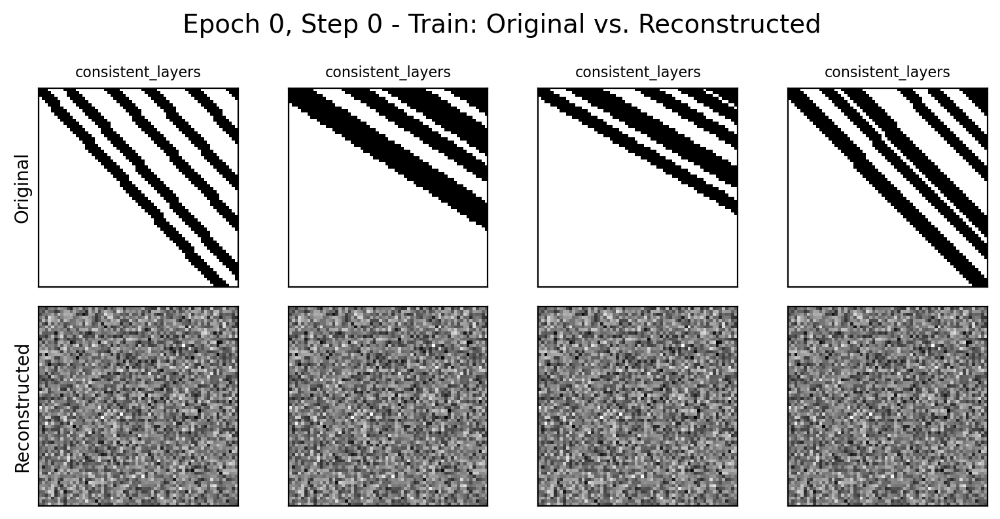

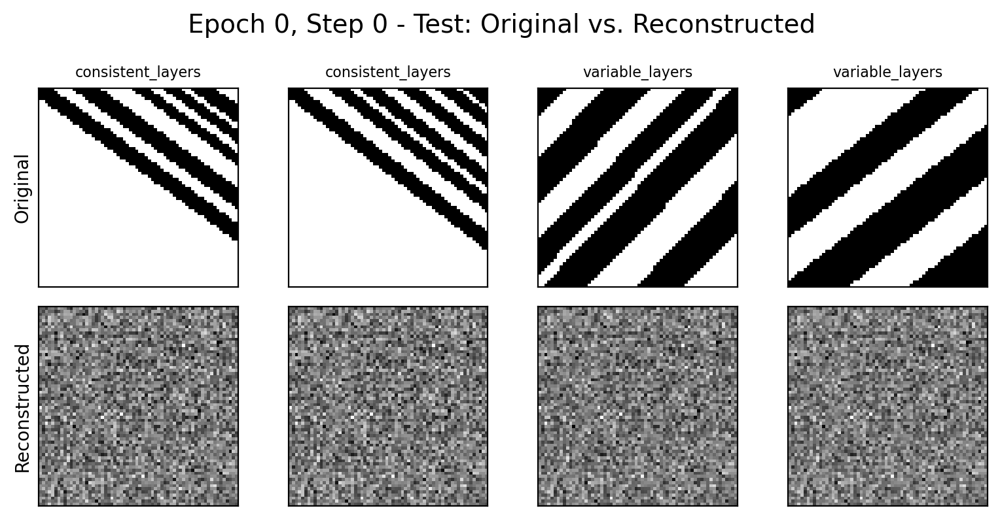

Train t-SNE Silhouette Score: 0.514
Test t-SNE Silhouette Score: 0.565


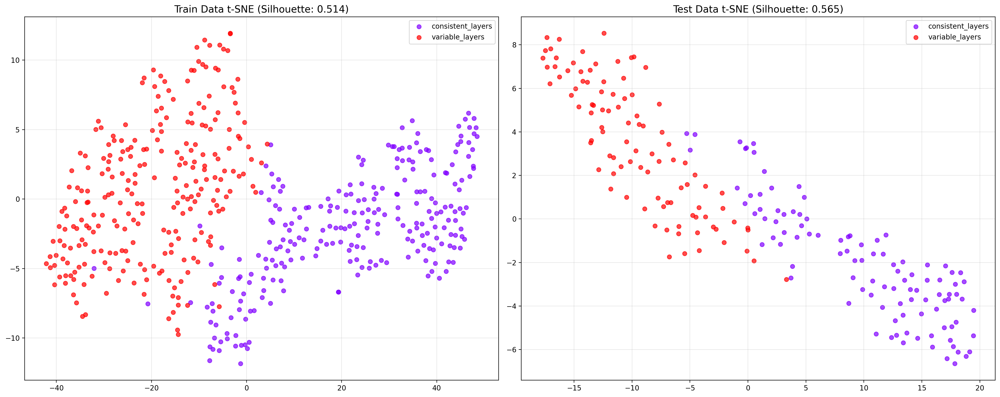

Epoch 0/2 completed | Train loss: 0.2304 | Test loss: 0.2072
Epoch: 1, Step: 0 | train loss: 0.2173 | test loss: 0.2068


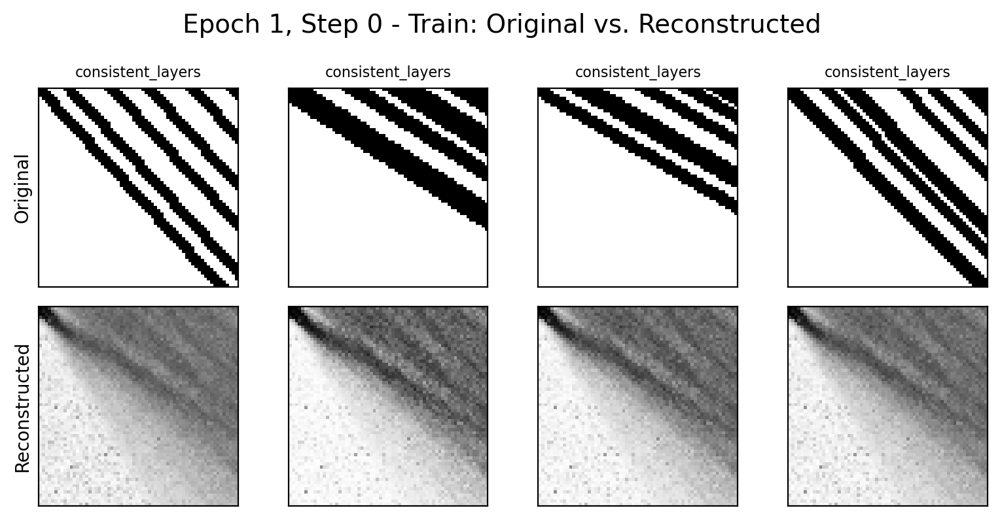

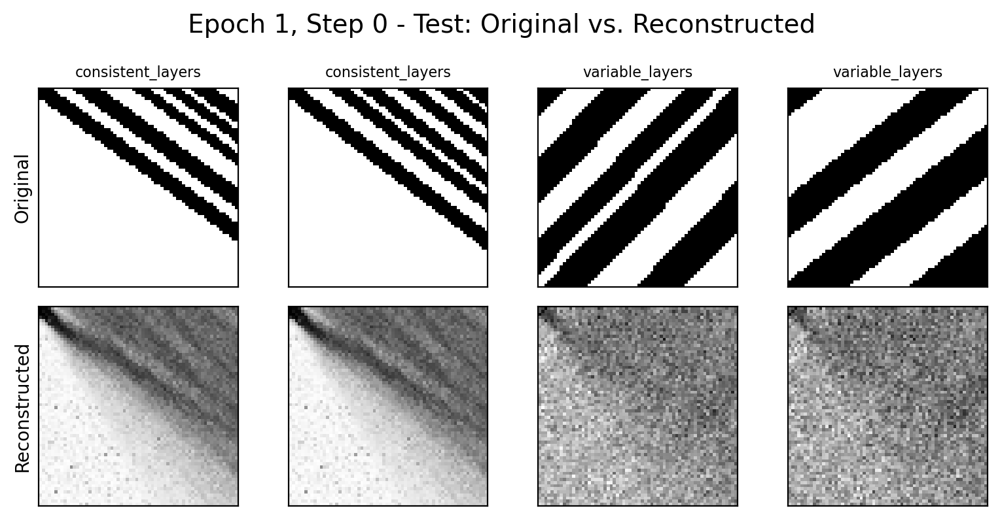

Train t-SNE Silhouette Score: 0.748
Test t-SNE Silhouette Score: 0.854


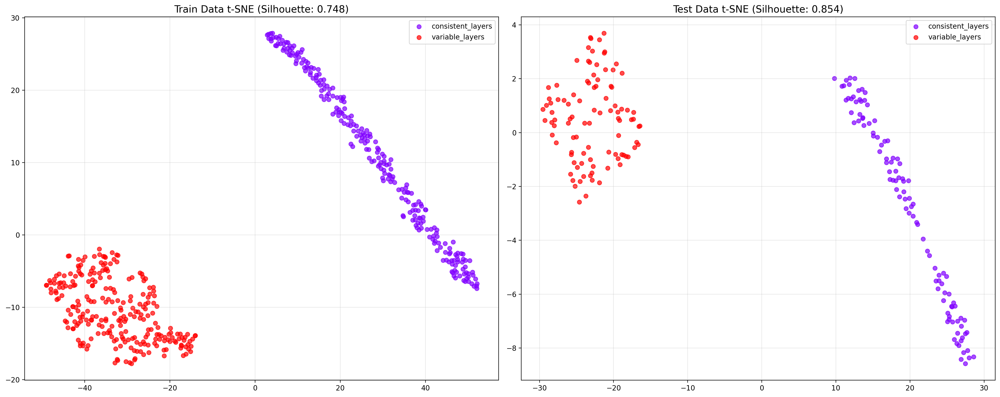

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2045 | test loss: 0.2017


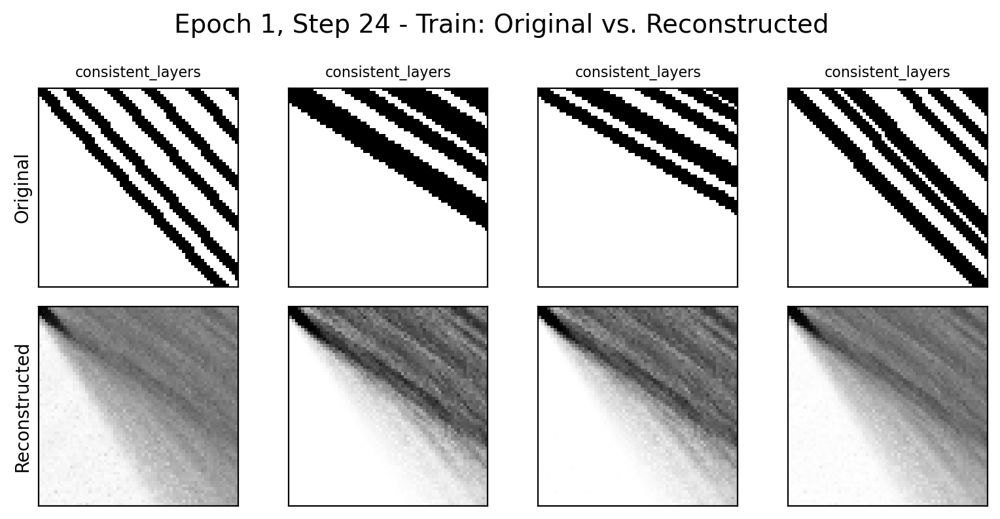

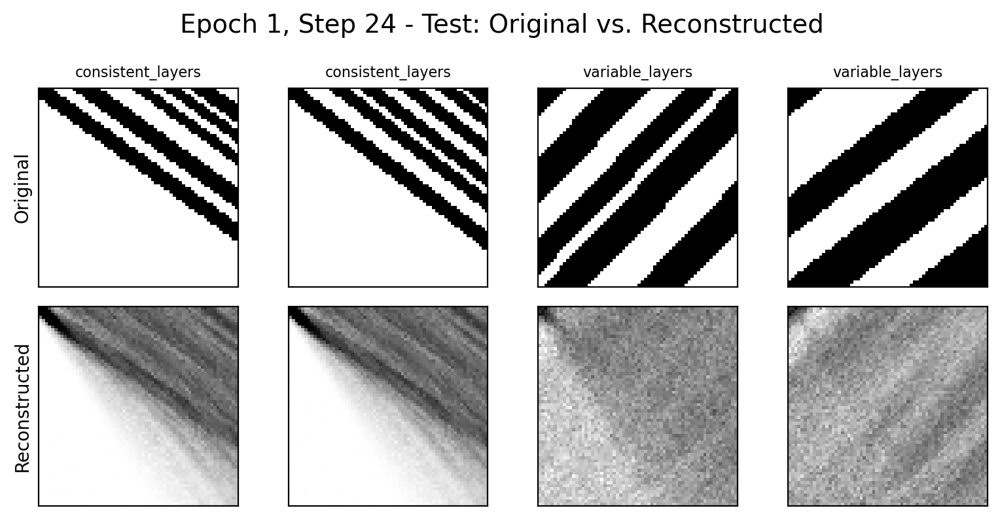

Epoch 1/2 completed | Train loss: 0.2050 | Test loss: 0.2017
Training completed in 16.51 seconds
Final train loss: 0.2019
Final test loss: 0.2017
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.688
Final Train Silhouette Score: 0.695
Model saved to latent_dim_exploration_results_layered_geology\simple_linear_8d_20250513_222913_model.pth

==================== Running simple_linear with latent_dim=16 ====================
Using device: cpu
Created model: SimpleLinearAutoencoder with latent dimension 16
Using pre-loaded data
Training SimpleLinearAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2504 | test loss: 0.2507


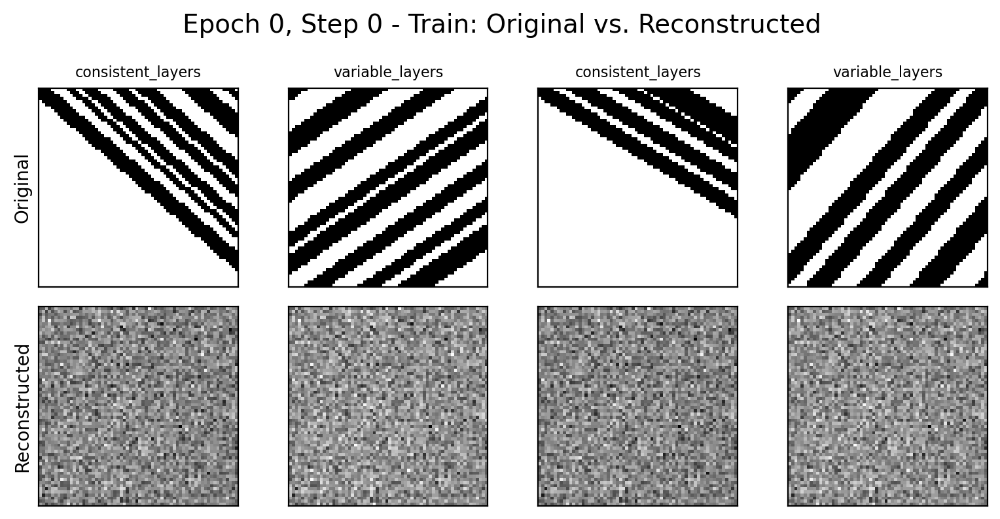

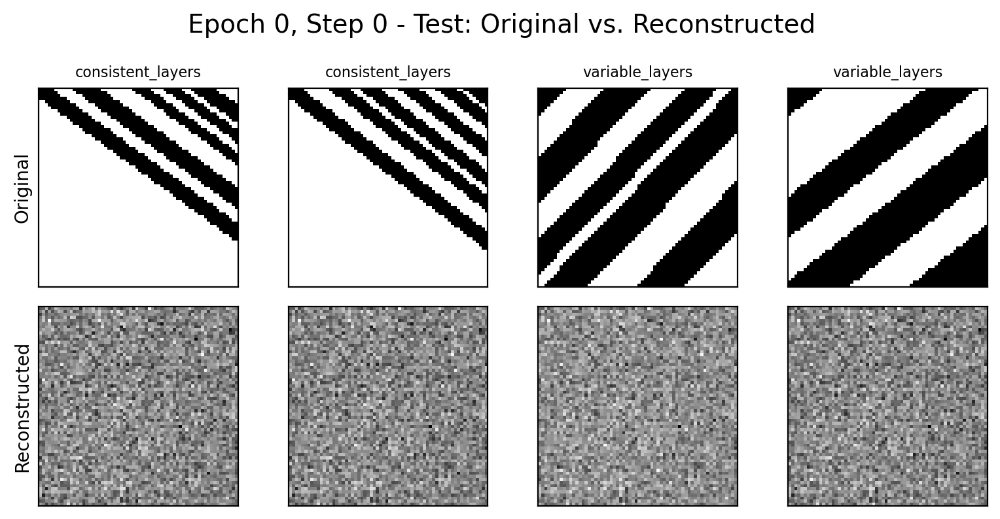

Train t-SNE Silhouette Score: 0.408
Test t-SNE Silhouette Score: 0.466


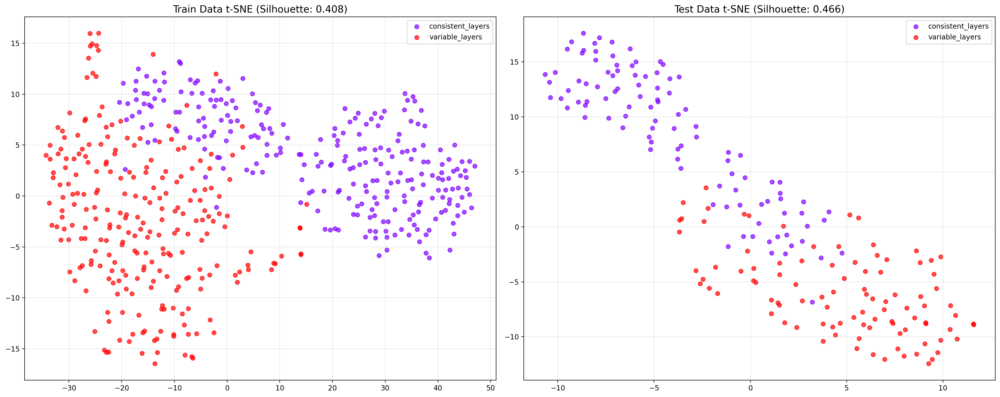

Epoch 0/2 completed | Train loss: 0.2282 | Test loss: 0.2051
Epoch: 1, Step: 0 | train loss: 0.2012 | test loss: 0.2046


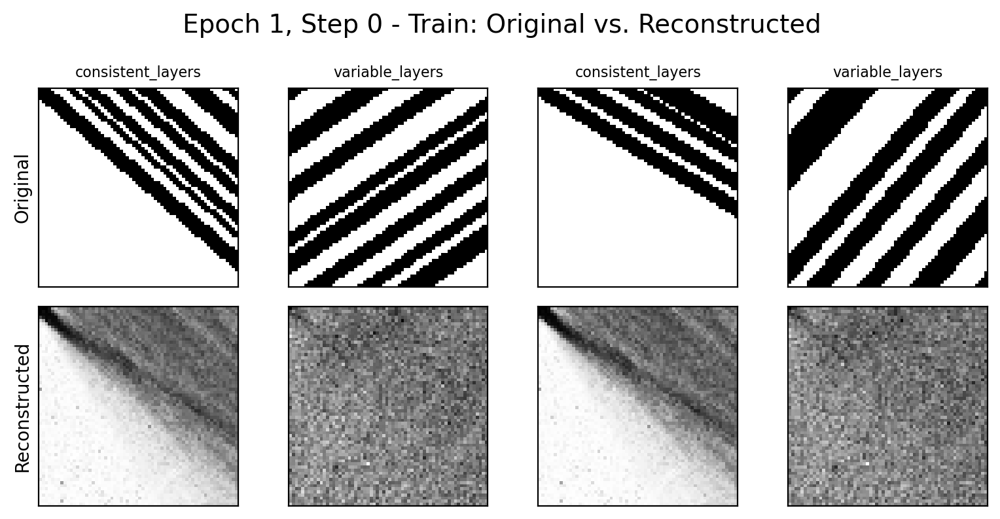

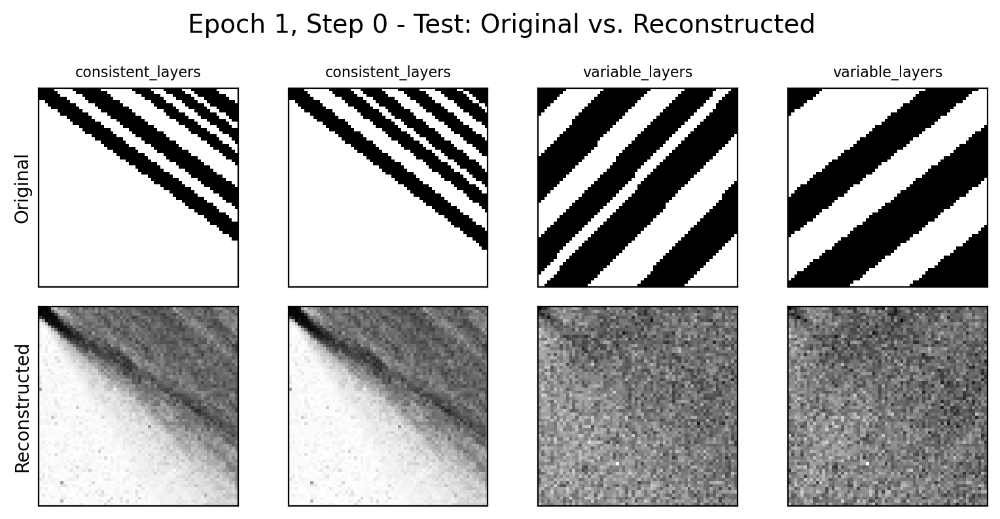

Train t-SNE Silhouette Score: 0.757
Test t-SNE Silhouette Score: 0.881


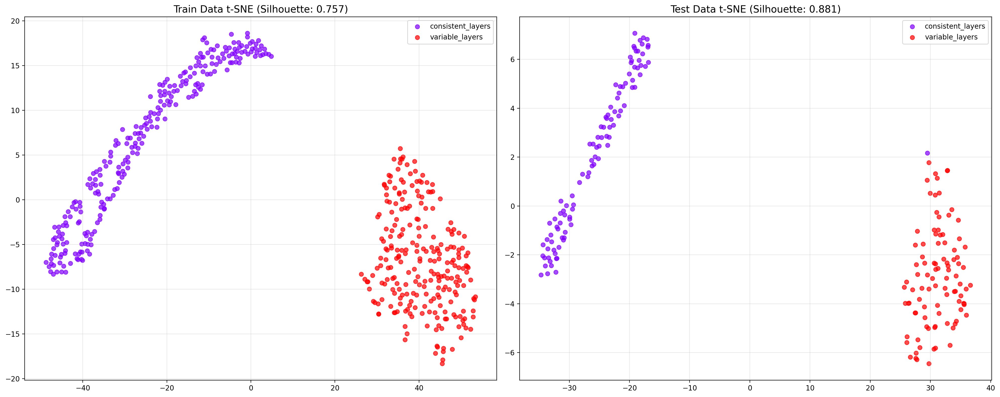

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2053 | test loss: 0.1973


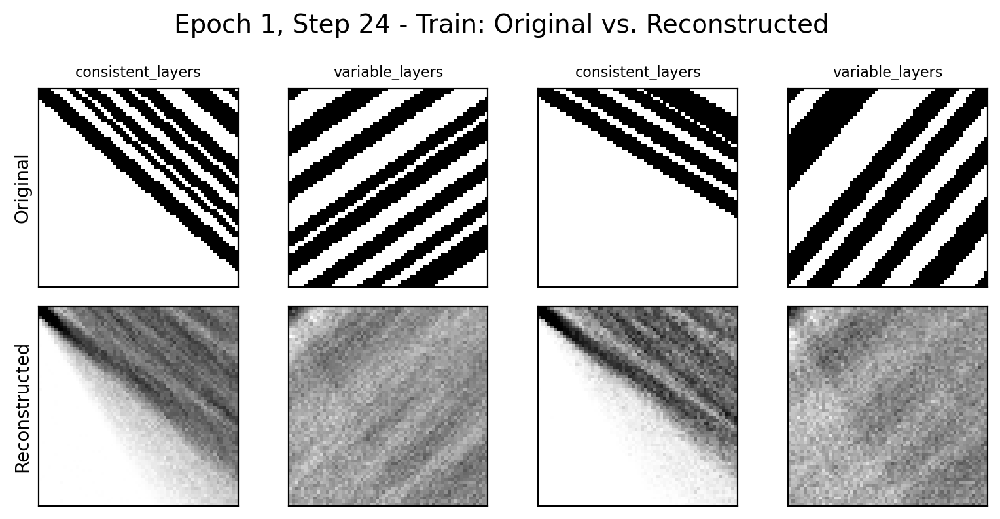

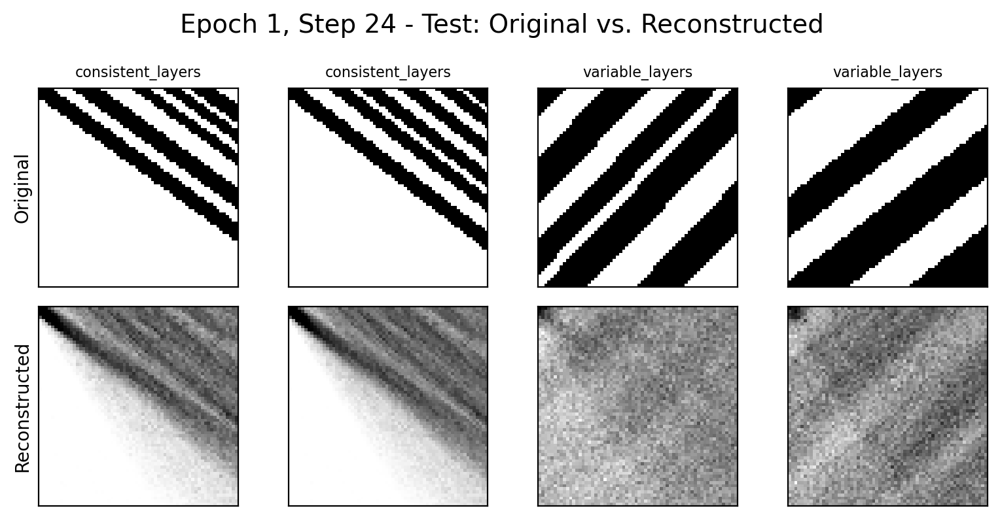

Epoch 1/2 completed | Train loss: 0.2024 | Test loss: 0.1973
Training completed in 14.33 seconds
Final train loss: 0.1962
Final test loss: 0.1973
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.596
Final Train Silhouette Score: 0.588
Model saved to latent_dim_exploration_results_layered_geology\simple_linear_16d_20250513_222913_model.pth

==================== Running deeper_linear with latent_dim=8 ====================
Using device: cpu
Created model: DeeperLinearAutoencoder with latent dimension 8
Using pre-loaded data
Training DeeperLinearAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2502 | test loss: 0.2496


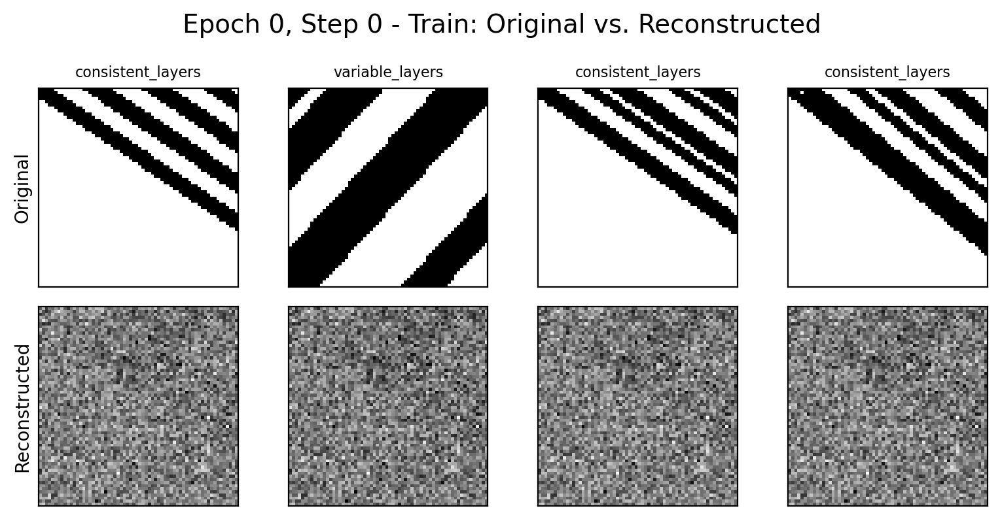

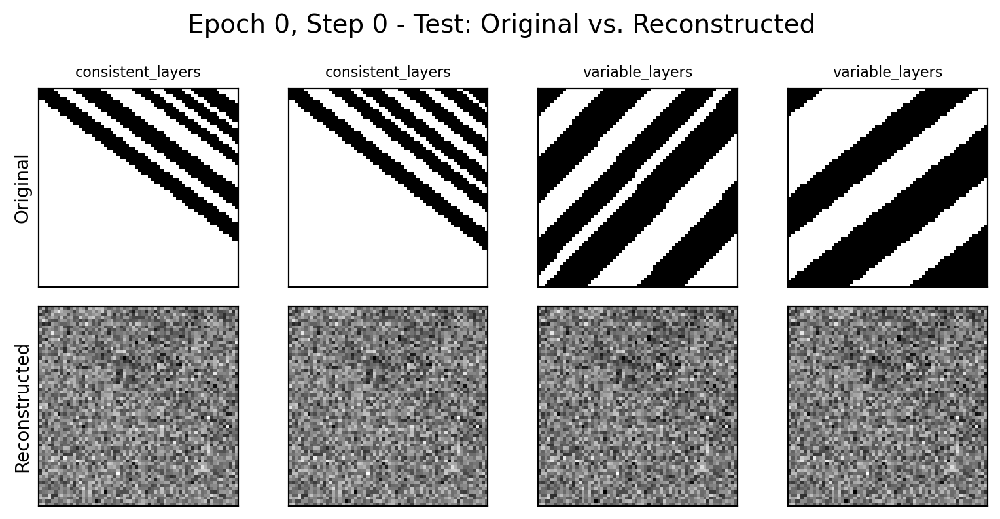

Train t-SNE Silhouette Score: 0.419
Test t-SNE Silhouette Score: 0.491


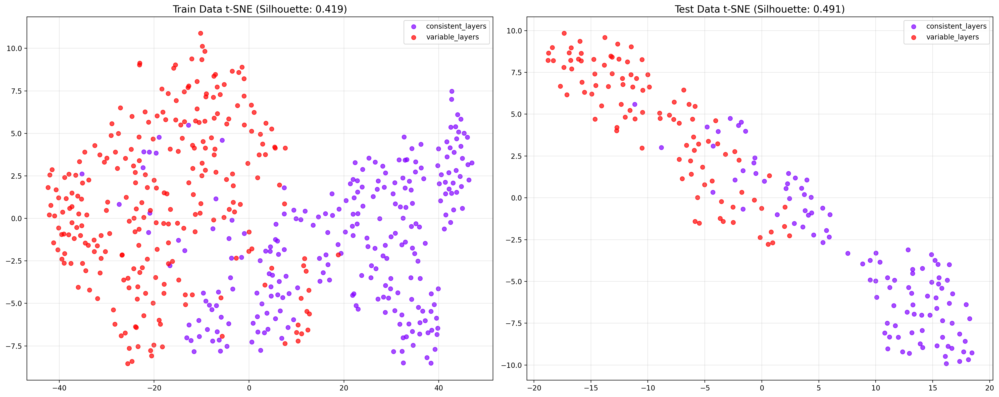

Epoch 0/2 completed | Train loss: 0.2283 | Test loss: 0.2090
Epoch: 1, Step: 0 | train loss: 0.2094 | test loss: 0.2076


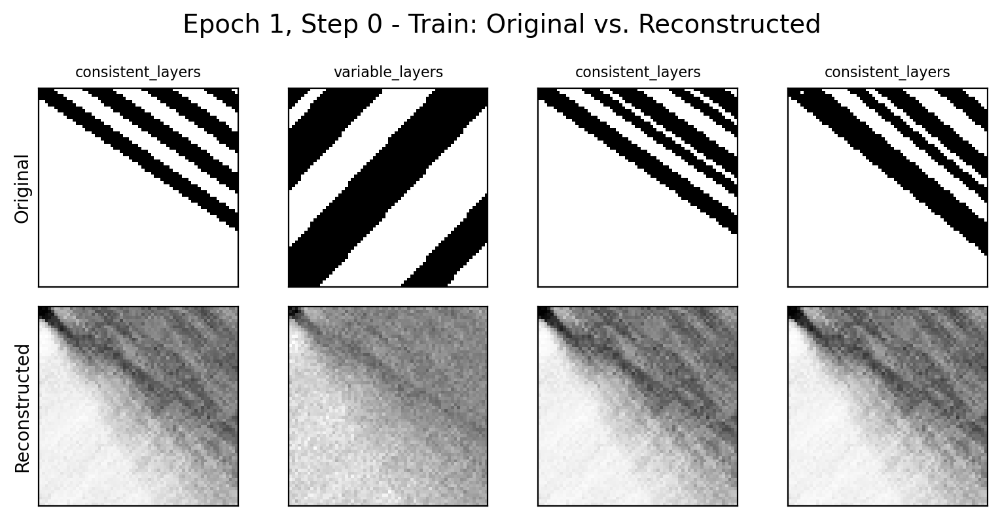

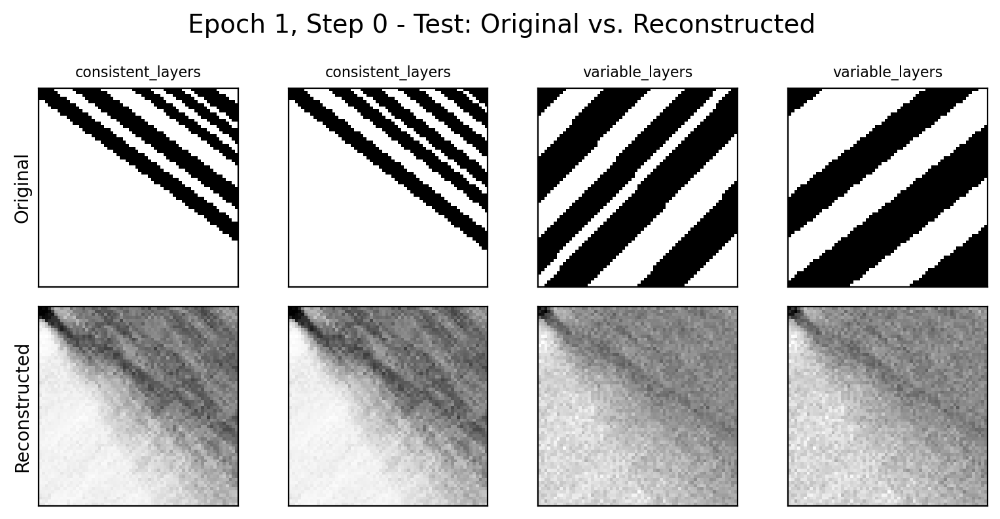

Train t-SNE Silhouette Score: 0.656
Test t-SNE Silhouette Score: 0.884


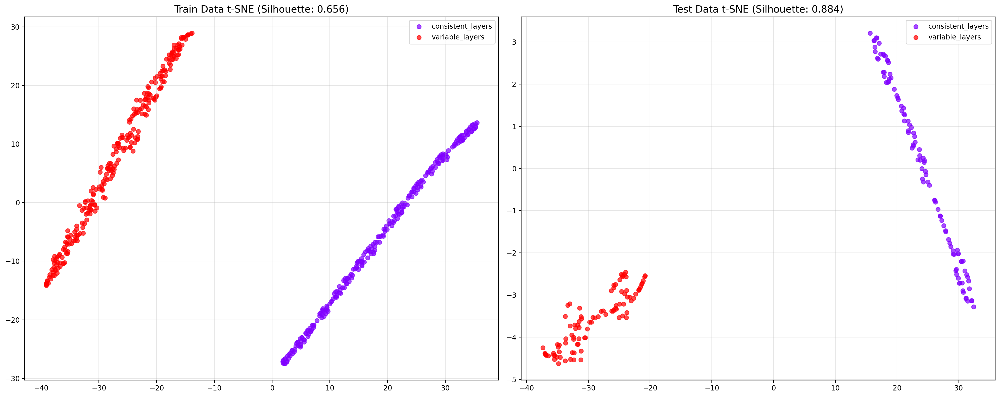

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2007 | test loss: 0.2027


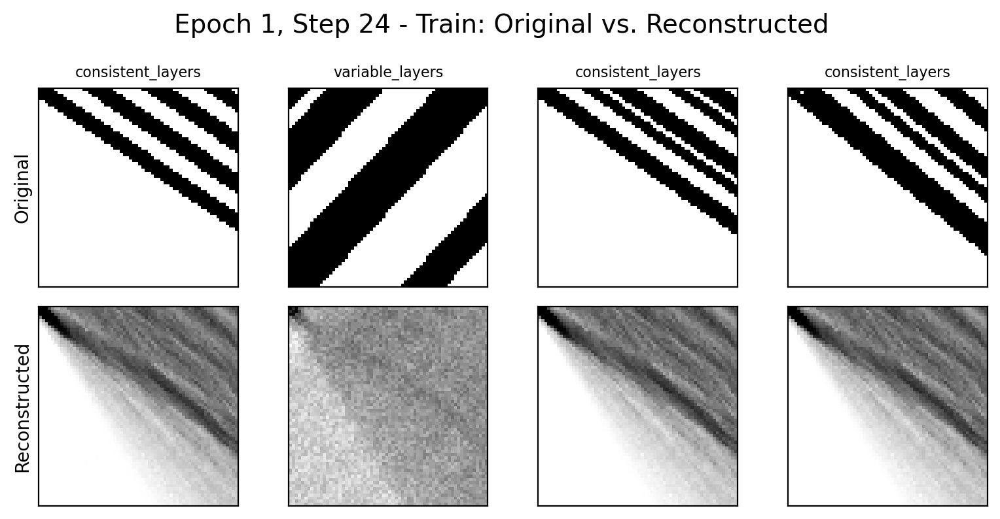

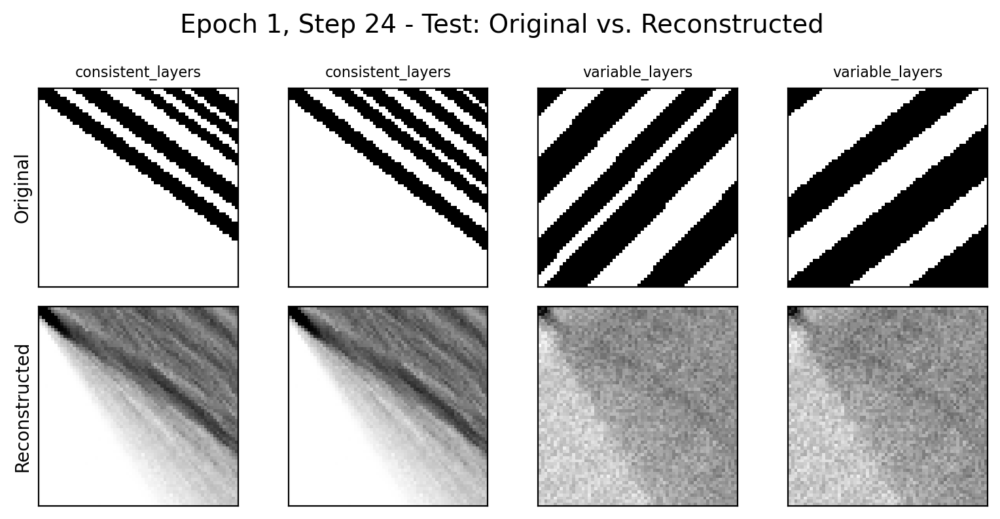

Epoch 1/2 completed | Train loss: 0.2059 | Test loss: 0.2027
Training completed in 15.65 seconds
Final train loss: 0.2047
Final test loss: 0.2027
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.702
Final Train Silhouette Score: 0.701
Model saved to latent_dim_exploration_results_layered_geology\deeper_linear_8d_20250513_222913_model.pth

==================== Running deeper_linear with latent_dim=16 ====================
Using device: cpu
Created model: DeeperLinearAutoencoder with latent dimension 16
Using pre-loaded data
Training DeeperLinearAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2501 | test loss: 0.2497


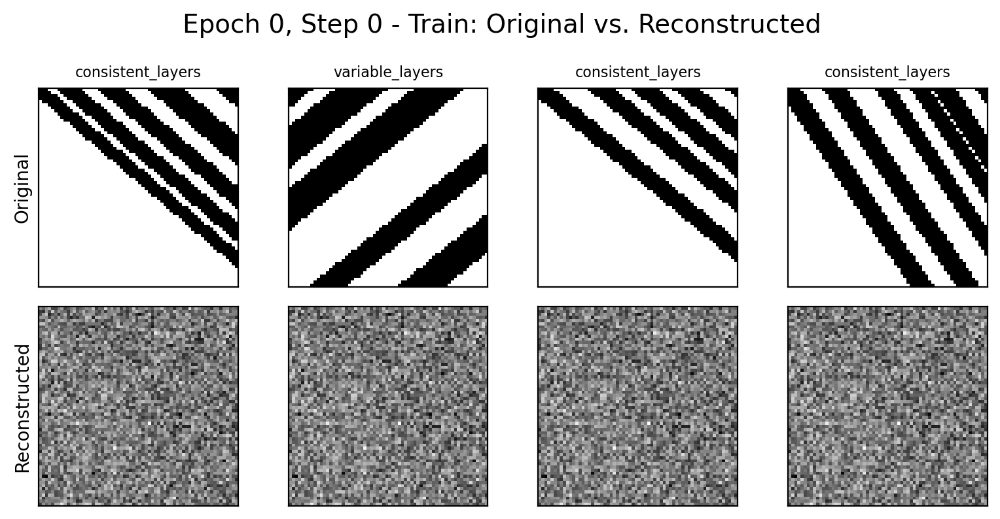

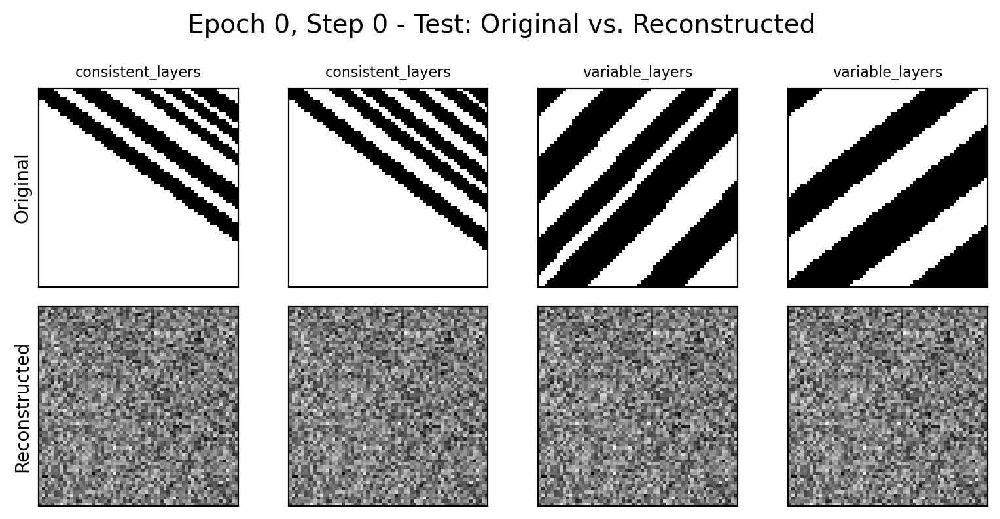

Train t-SNE Silhouette Score: 0.463
Test t-SNE Silhouette Score: 0.517


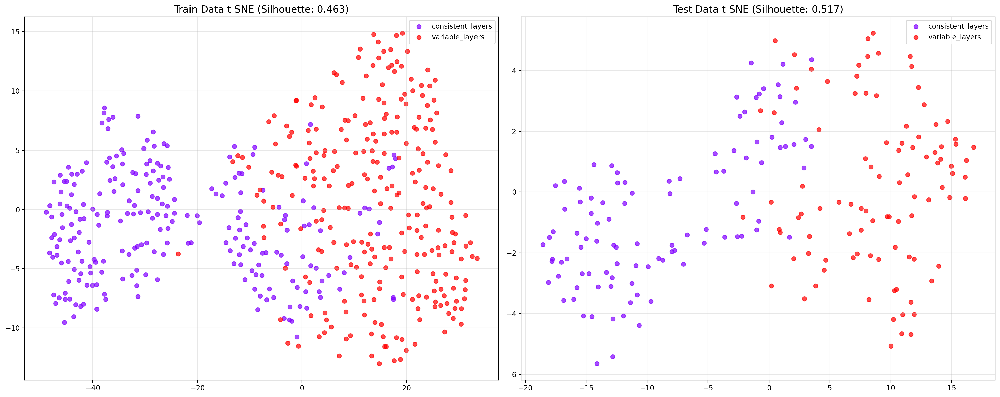

Epoch 0/2 completed | Train loss: 0.2294 | Test loss: 0.2147
Epoch: 1, Step: 0 | train loss: 0.2135 | test loss: 0.2146


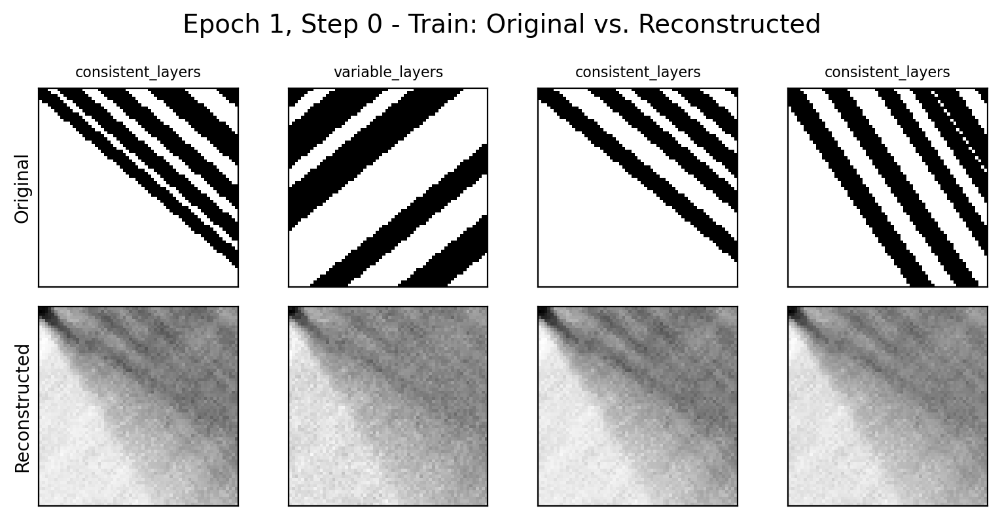

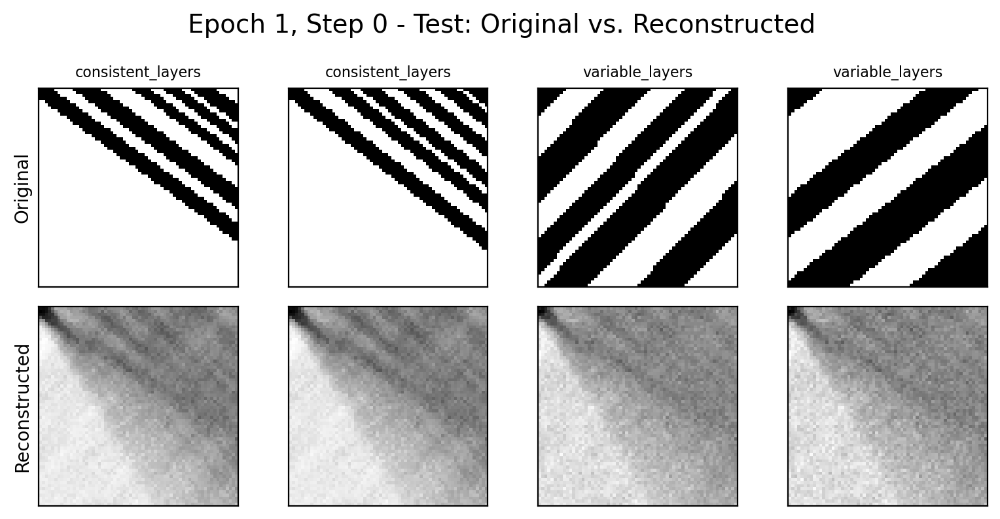

Train t-SNE Silhouette Score: 0.654
Test t-SNE Silhouette Score: 0.833


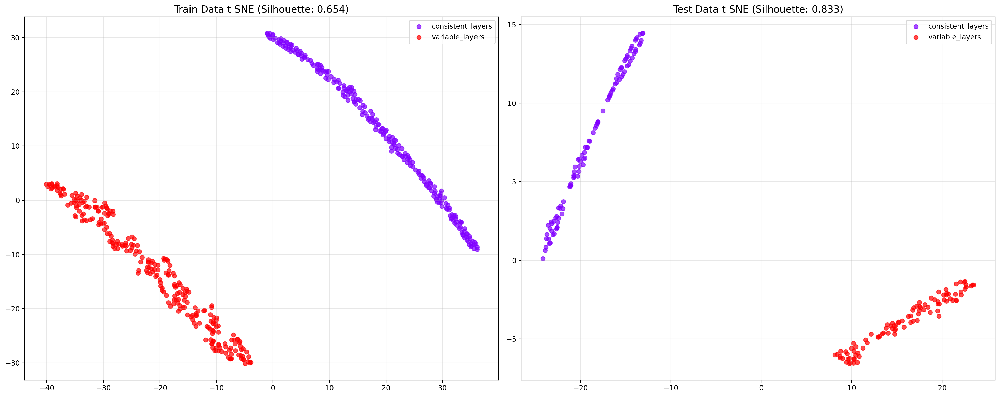

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2084 | test loss: 0.2023


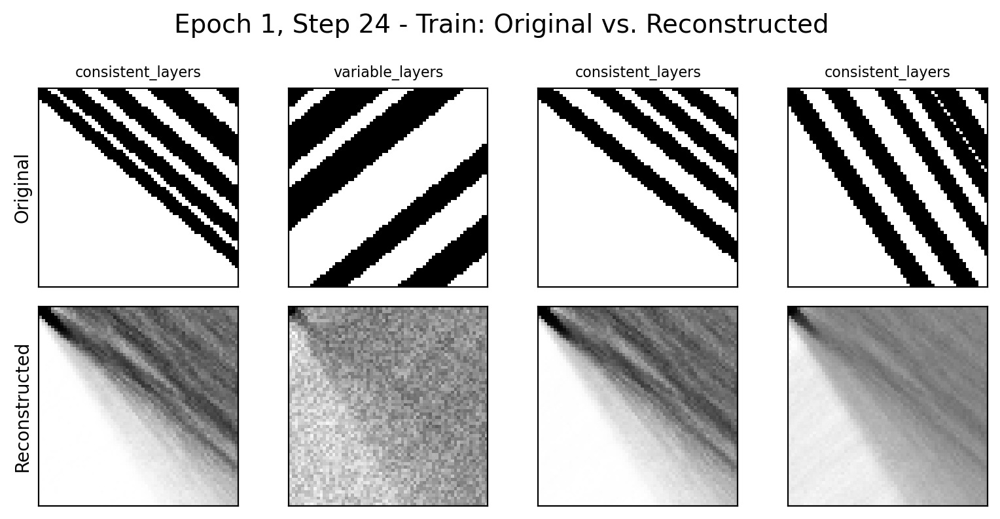

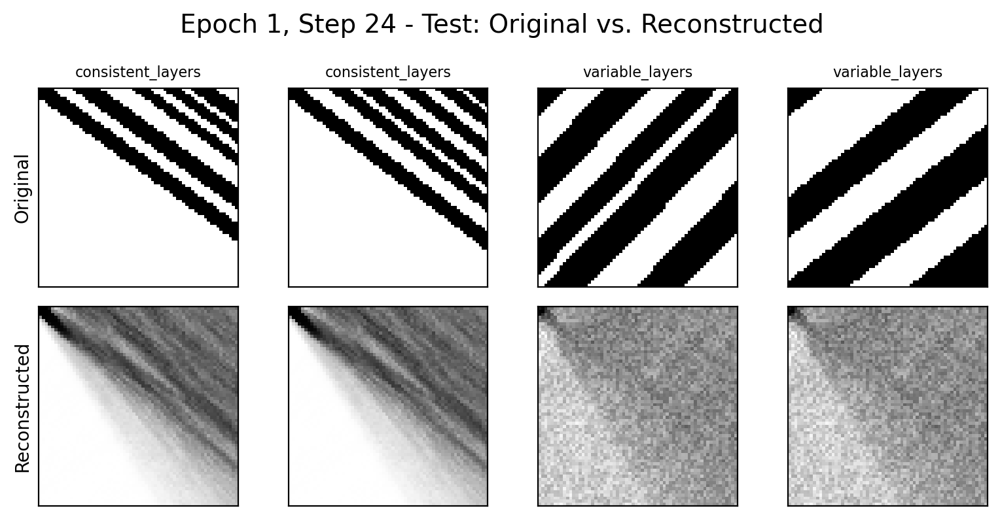

Epoch 1/2 completed | Train loss: 0.2079 | Test loss: 0.2023
Training completed in 12.53 seconds
Final train loss: 0.2046
Final test loss: 0.2023
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.757
Final Train Silhouette Score: 0.756
Model saved to latent_dim_exploration_results_layered_geology\deeper_linear_16d_20250513_222913_model.pth

==================== Running convolutional with latent_dim=8 ====================
Using device: cpu
Created model: ConvAutoencoder with latent dimension 8
Using pre-loaded data
Training ConvAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2527 | test loss: 0.2522


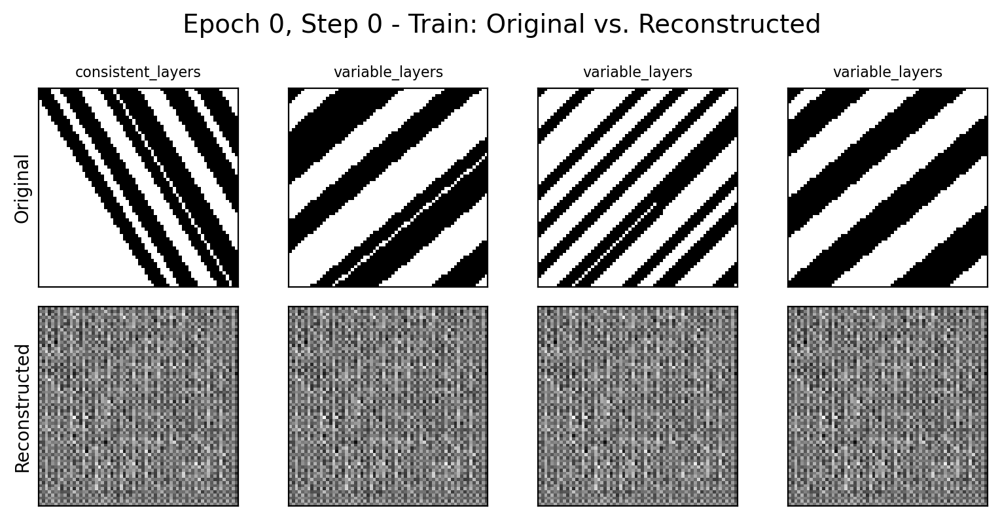

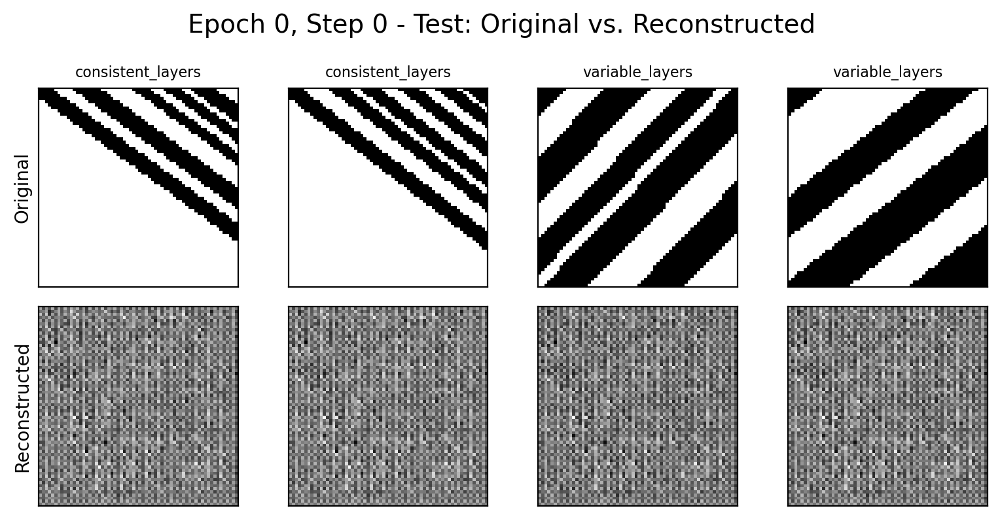

Train t-SNE Silhouette Score: 0.424
Test t-SNE Silhouette Score: 0.497


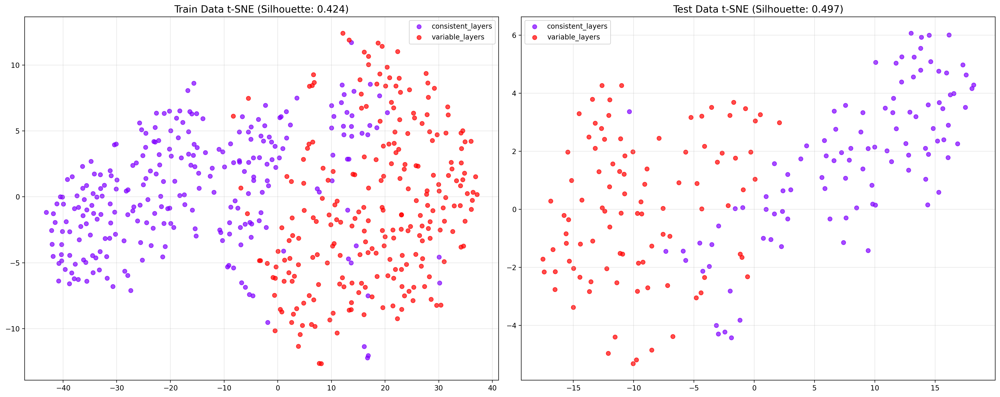

Epoch 0/2 completed | Train loss: 0.2371 | Test loss: 0.2195
Epoch: 1, Step: 0 | train loss: 0.2181 | test loss: 0.2191


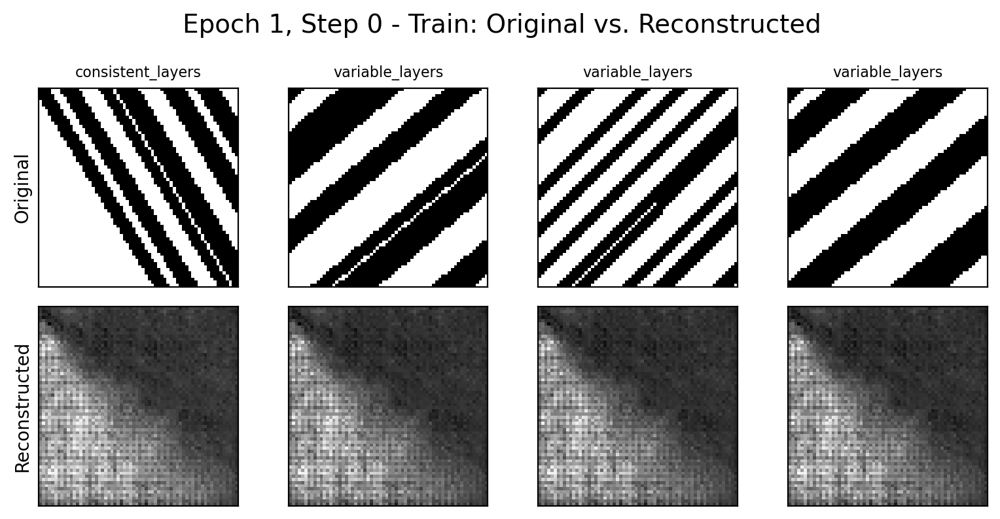

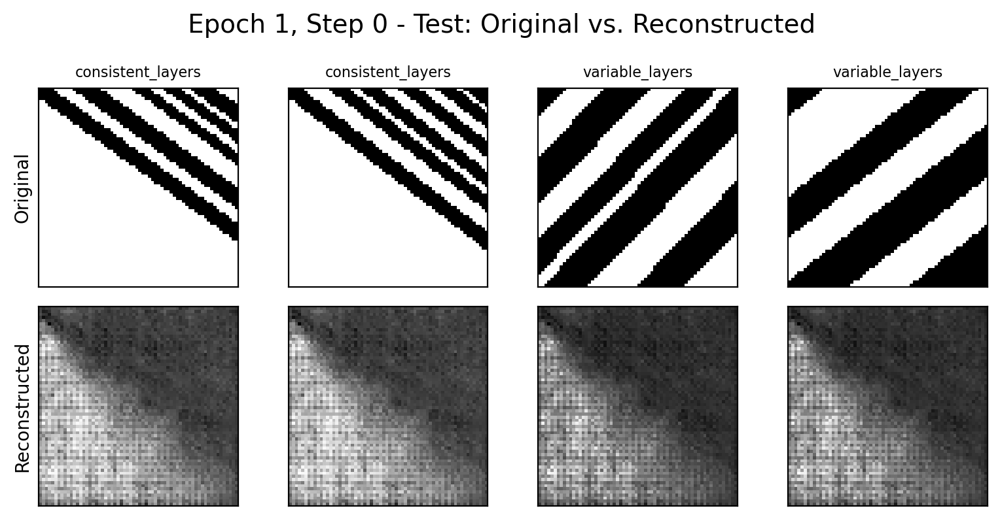

Train t-SNE Silhouette Score: 0.629
Test t-SNE Silhouette Score: 0.794


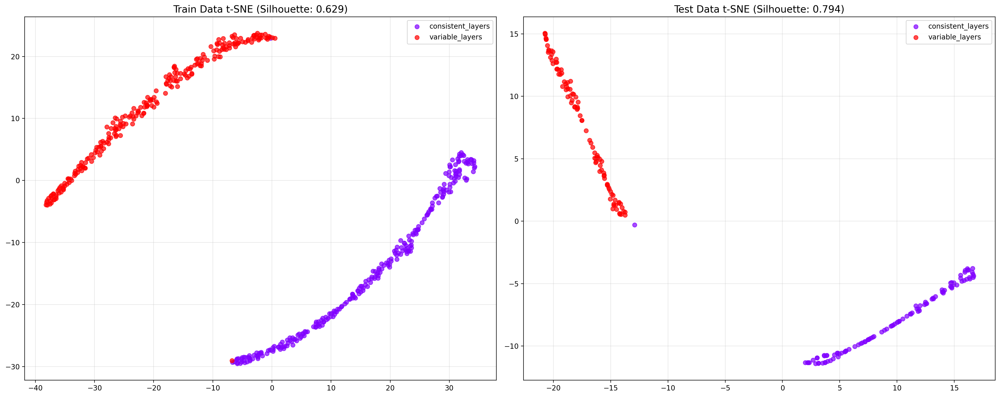

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2132 | test loss: 0.2024


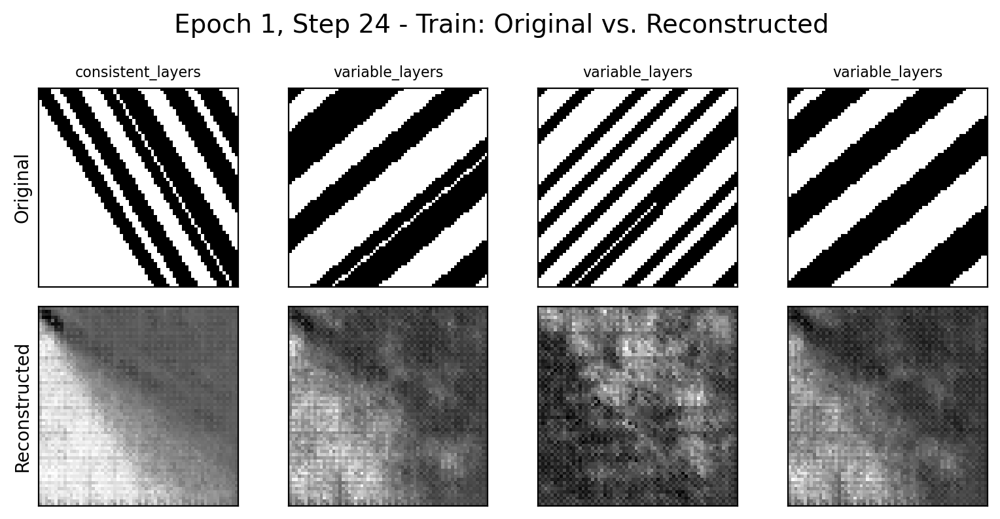

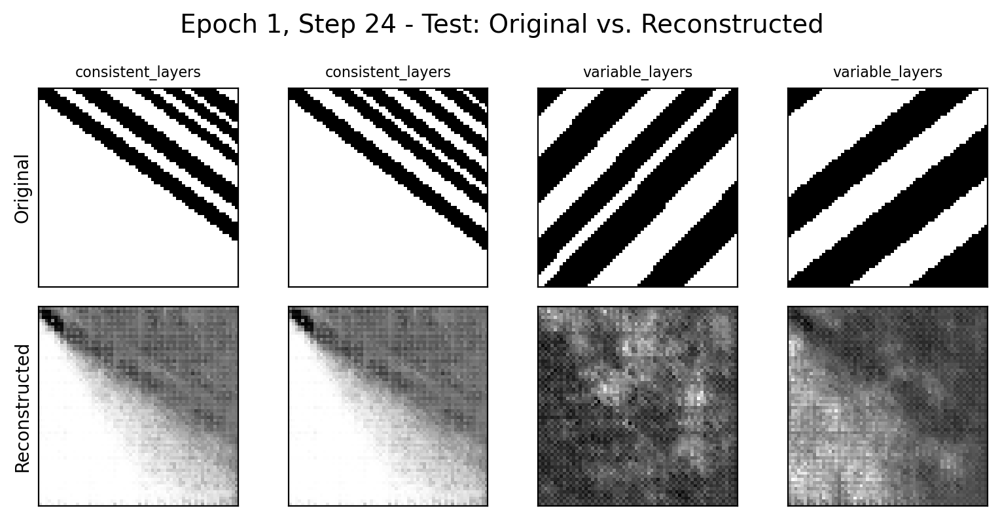

Epoch 1/2 completed | Train loss: 0.2098 | Test loss: 0.2024
Training completed in 12.24 seconds
Final train loss: 0.2012
Final test loss: 0.2024
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.744
Final Train Silhouette Score: 0.695
Model saved to latent_dim_exploration_results_layered_geology\convolutional_8d_20250513_222913_model.pth

==================== Running convolutional with latent_dim=16 ====================
Using device: cpu
Created model: ConvAutoencoder with latent dimension 16
Using pre-loaded data
Training ConvAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2476 | test loss: 0.2472


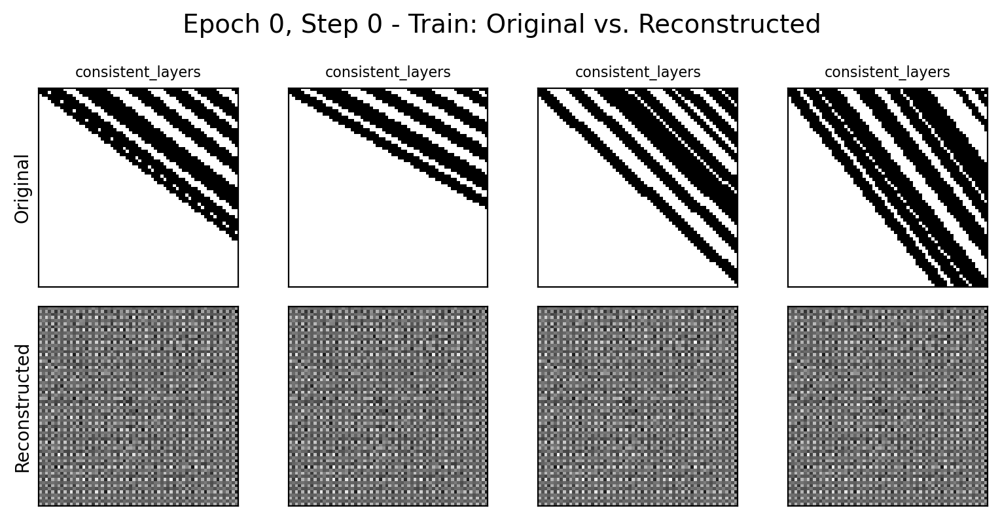

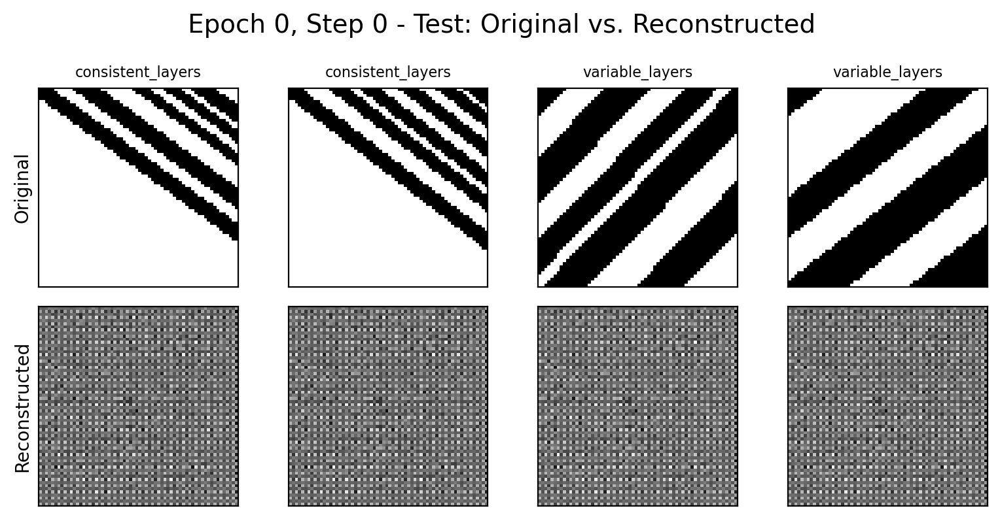

Train t-SNE Silhouette Score: 0.535
Test t-SNE Silhouette Score: 0.513


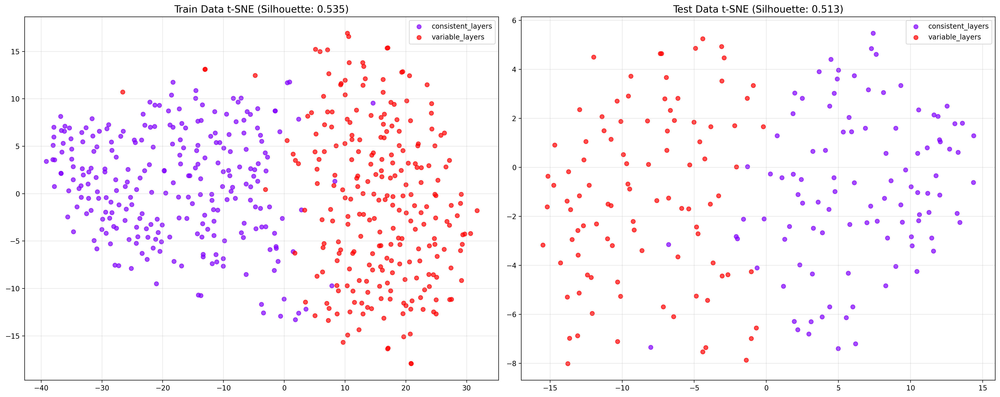

Epoch 0/2 completed | Train loss: 0.2370 | Test loss: 0.2128
Epoch: 1, Step: 0 | train loss: 0.2241 | test loss: 0.2112


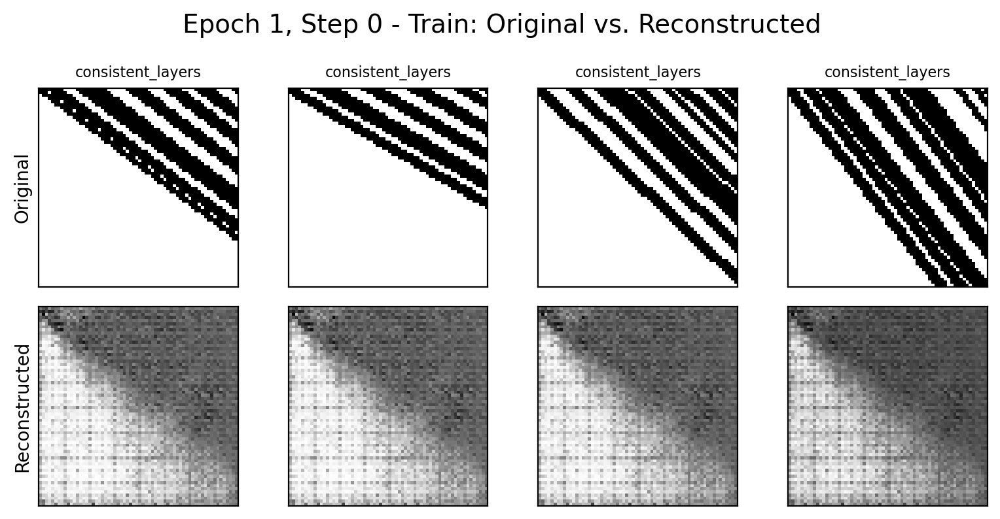

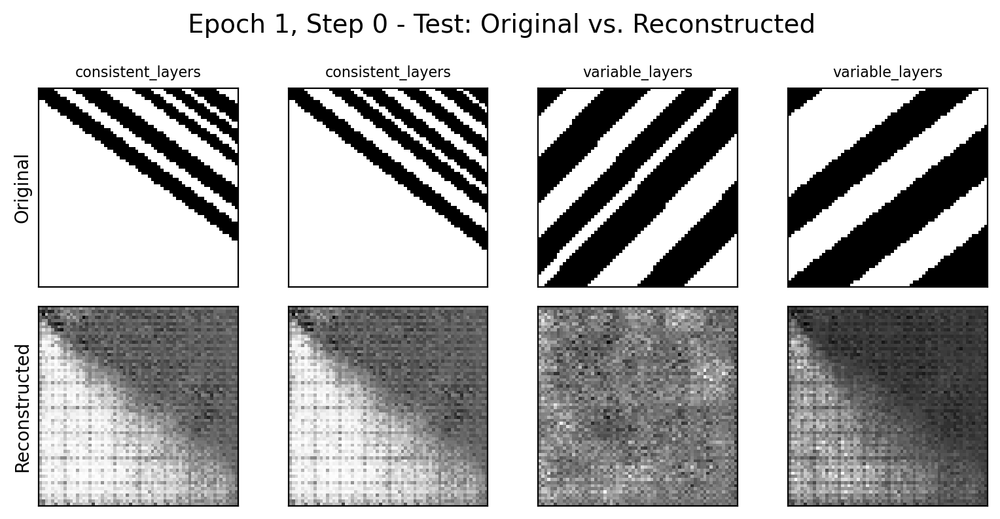

Train t-SNE Silhouette Score: 0.620
Test t-SNE Silhouette Score: 0.808


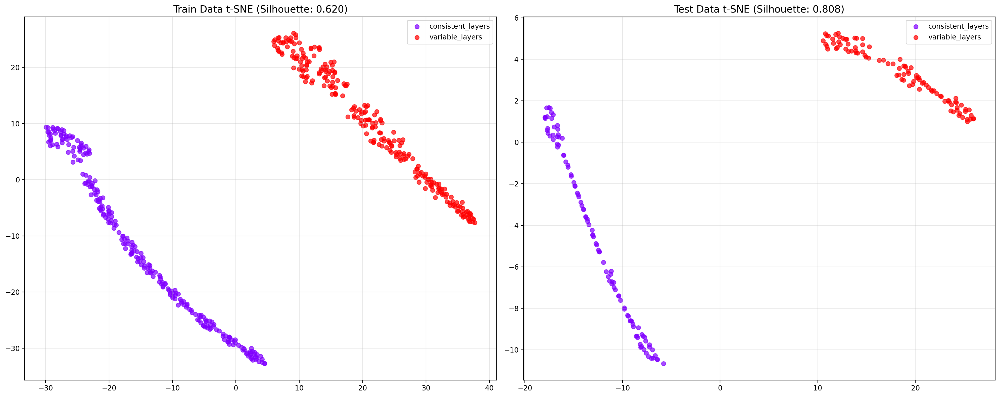

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.1882 | test loss: 0.1940


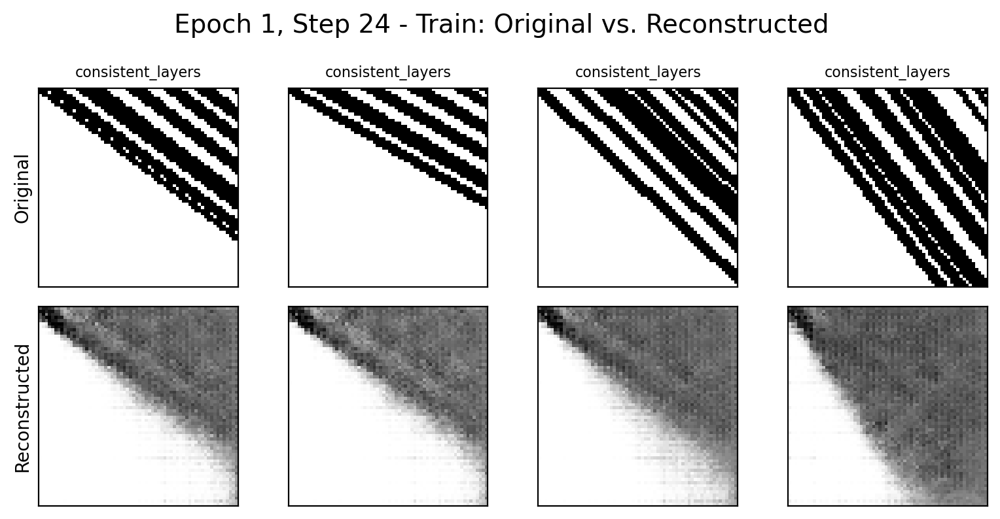

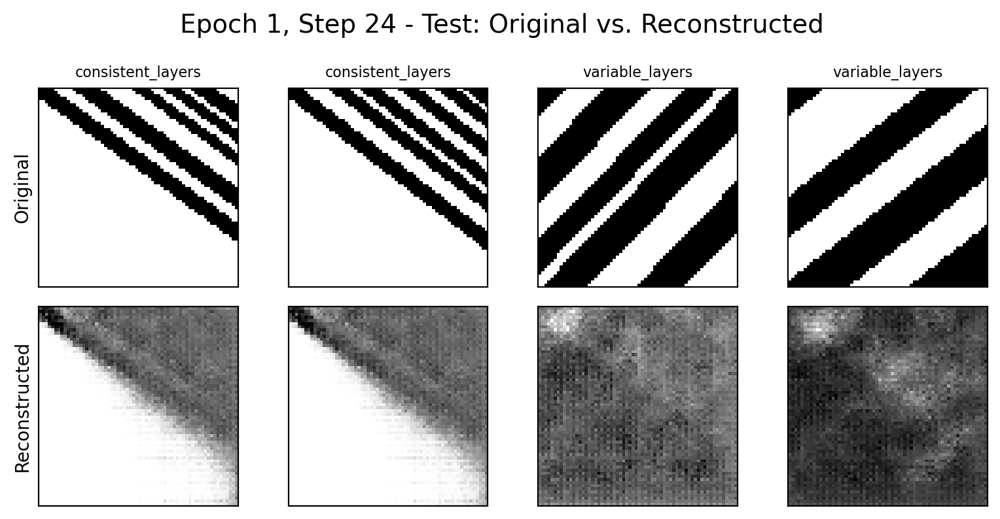

Epoch 1/2 completed | Train loss: 0.2043 | Test loss: 0.1940
Training completed in 12.56 seconds
Final train loss: 0.1929
Final test loss: 0.1940
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.666
Final Train Silhouette Score: 0.641
Model saved to latent_dim_exploration_results_layered_geology\convolutional_16d_20250513_222913_model.pth

==================== Running deeper_convolutional with latent_dim=8 ====================
Using device: cpu
Created model: DeeperConvAutoencoder with latent dimension 8
Using pre-loaded data
Training DeeperConvAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2549 | test loss: 0.2538


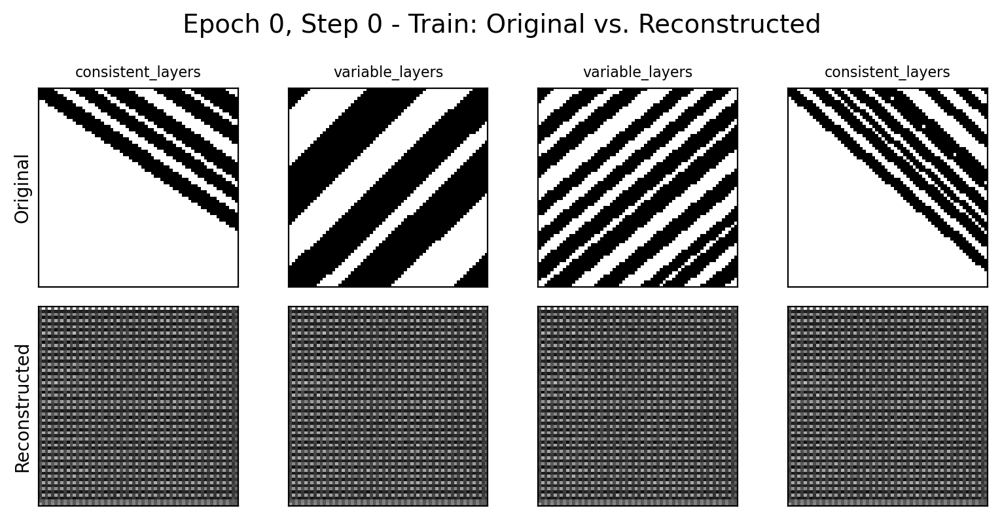

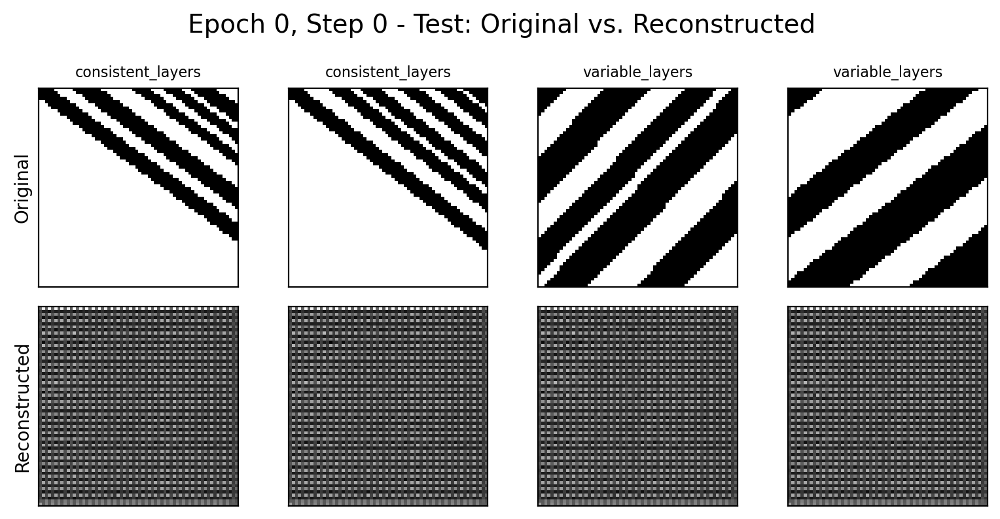

Train t-SNE Silhouette Score: 0.295
Test t-SNE Silhouette Score: 0.369


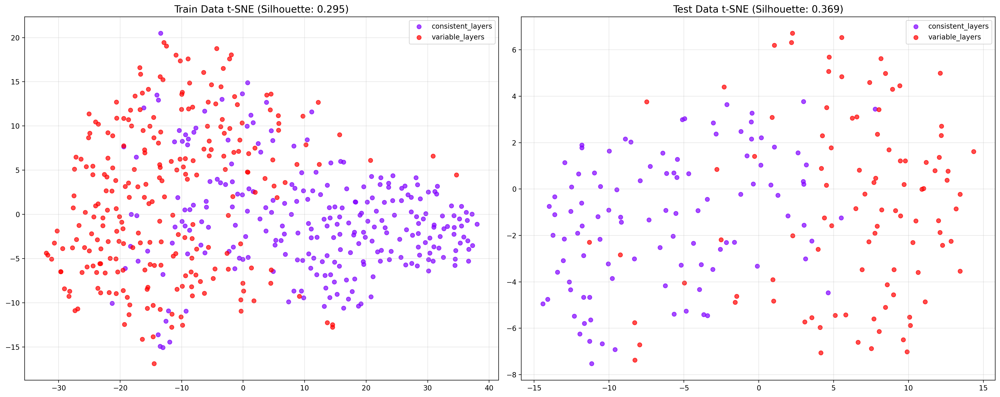

Epoch 0/2 completed | Train loss: 0.2340 | Test loss: 0.2083
Epoch: 1, Step: 0 | train loss: 0.2132 | test loss: 0.2057


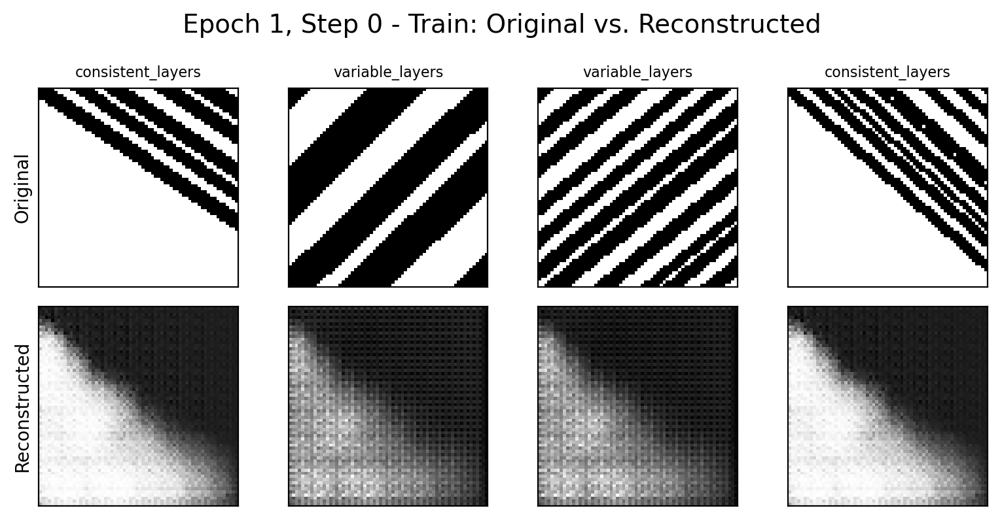

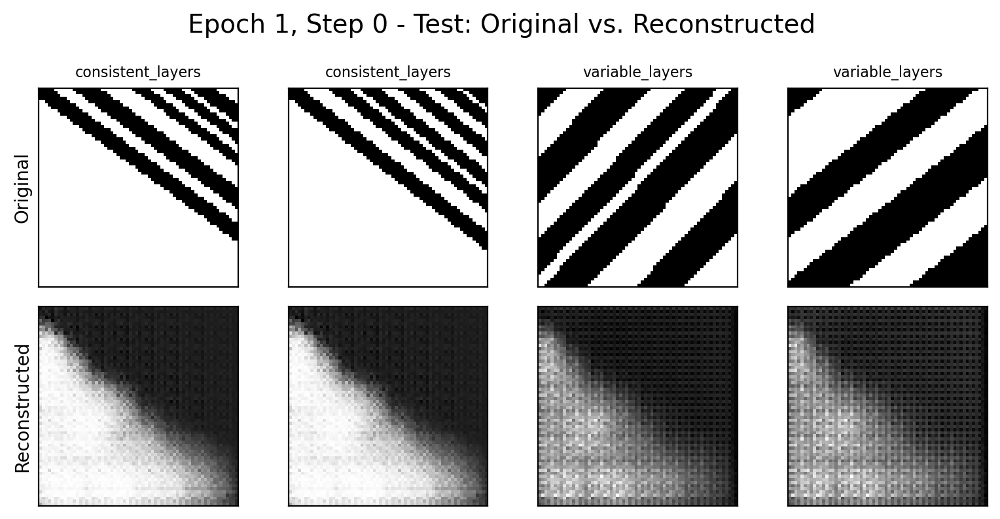

Train t-SNE Silhouette Score: 0.669
Test t-SNE Silhouette Score: 0.879


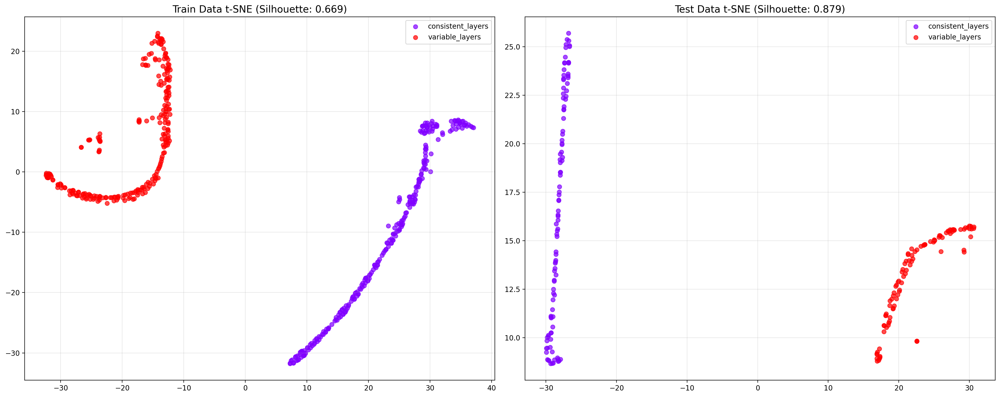

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2018 | test loss: 0.1944


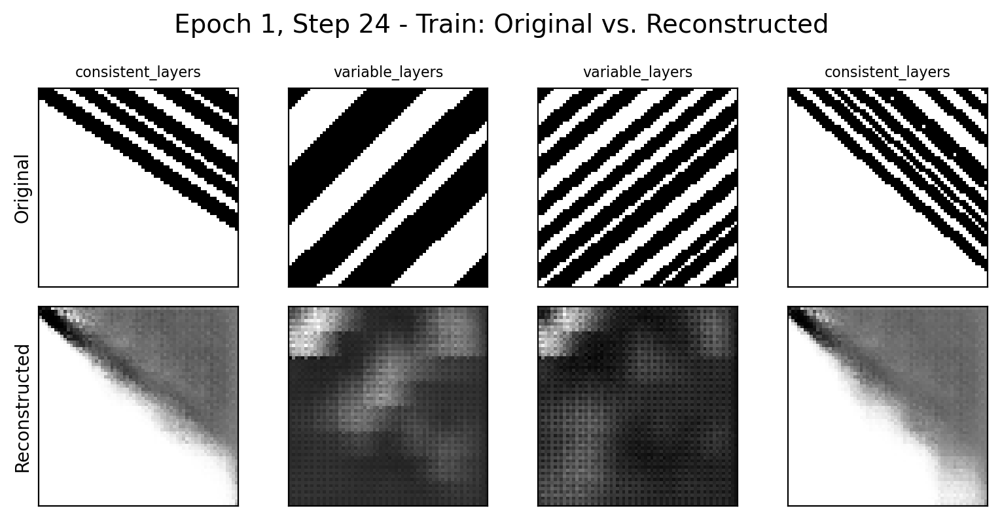

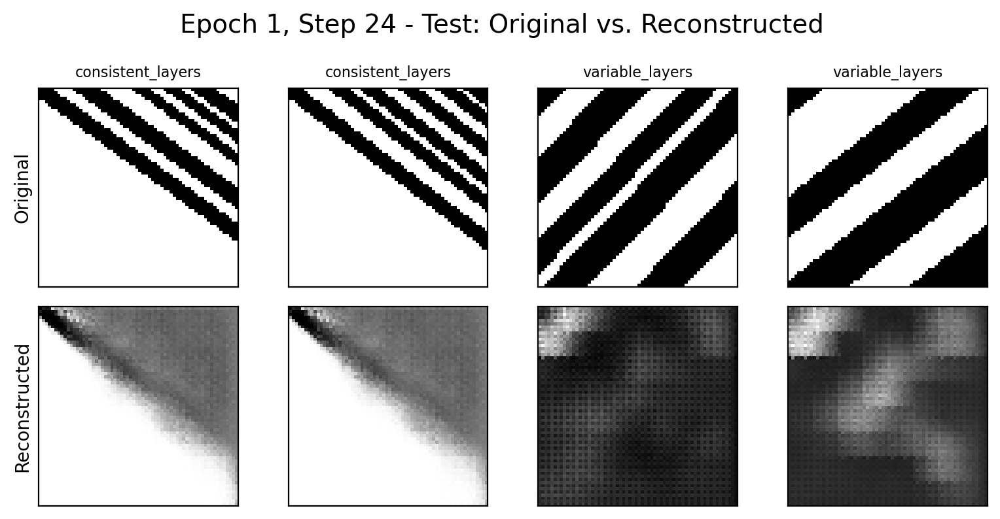

Epoch 1/2 completed | Train loss: 0.2033 | Test loss: 0.1944
Training completed in 17.11 seconds
Final train loss: 0.1949
Final test loss: 0.1944
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.580
Final Train Silhouette Score: 0.546
Model saved to latent_dim_exploration_results_layered_geology\deeper_convolutional_8d_20250513_222913_model.pth

==================== Running deeper_convolutional with latent_dim=16 ====================
Using device: cpu
Created model: DeeperConvAutoencoder with latent dimension 16
Using pre-loaded data
Training DeeperConvAutoencoder for 2 epochs on cpu
Learning rate: 0.001
Visualizing at epochs: [0, 1]
Epoch: 0, Step: 0 | train loss: 0.2585 | test loss: 0.2564


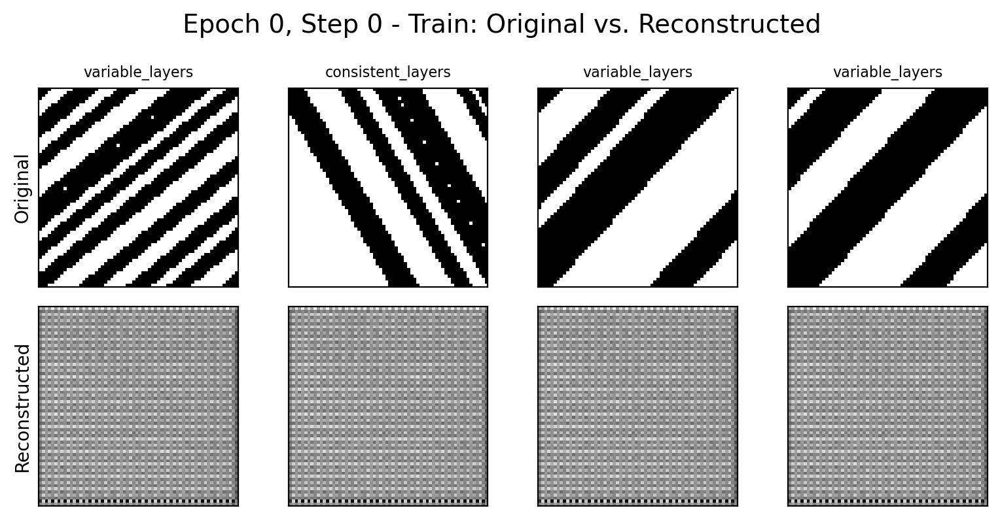

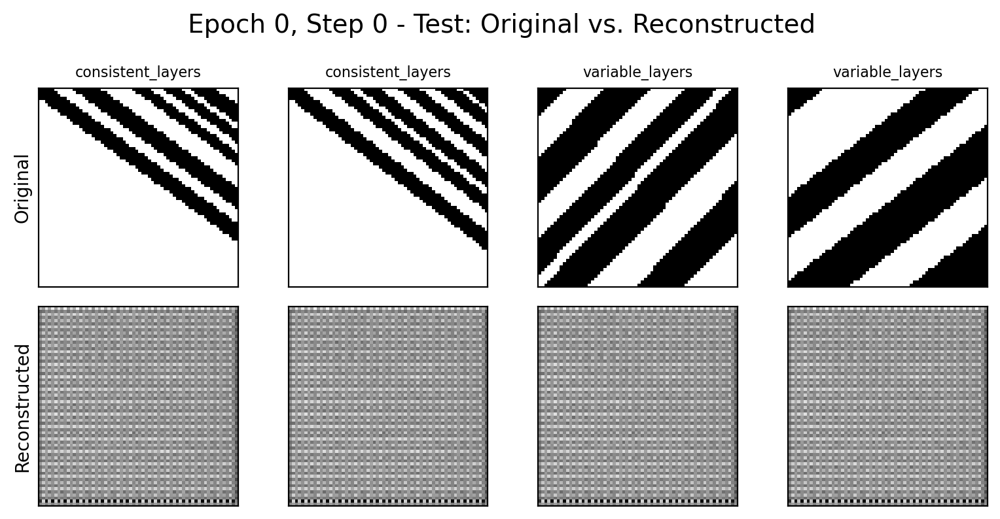

Train t-SNE Silhouette Score: 0.620
Test t-SNE Silhouette Score: 0.661


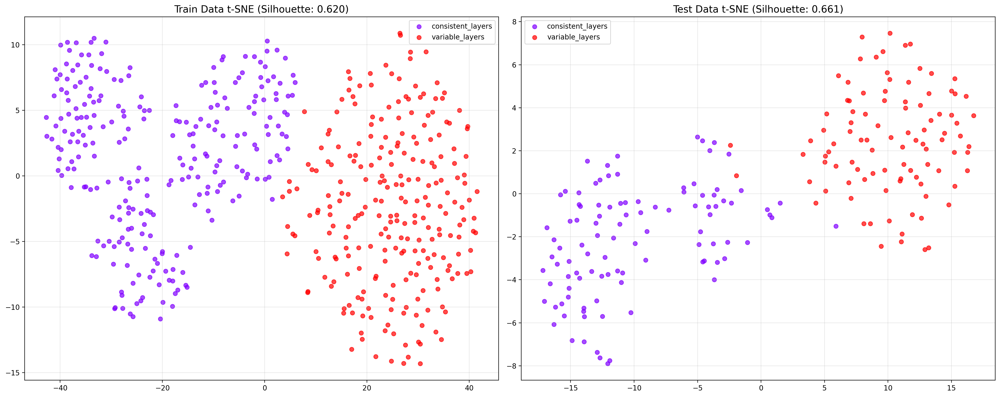

Epoch 0/2 completed | Train loss: 0.2278 | Test loss: 0.2057
Epoch: 1, Step: 0 | train loss: 0.2169 | test loss: 0.2027


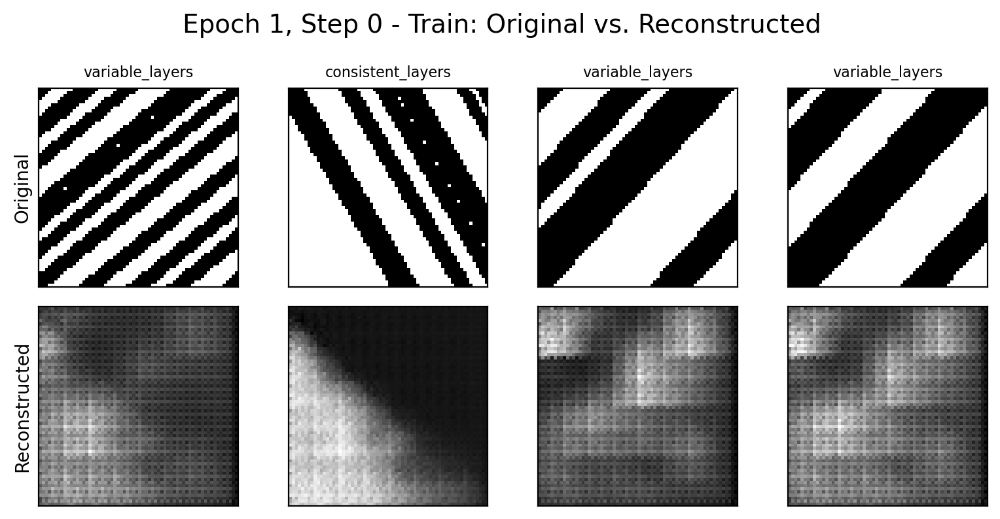

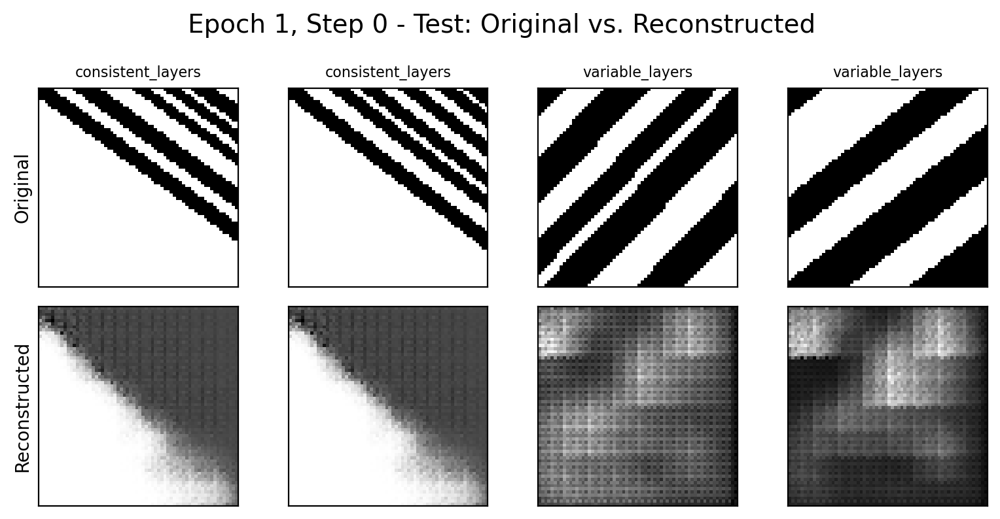

Train t-SNE Silhouette Score: 0.663
Test t-SNE Silhouette Score: 0.838


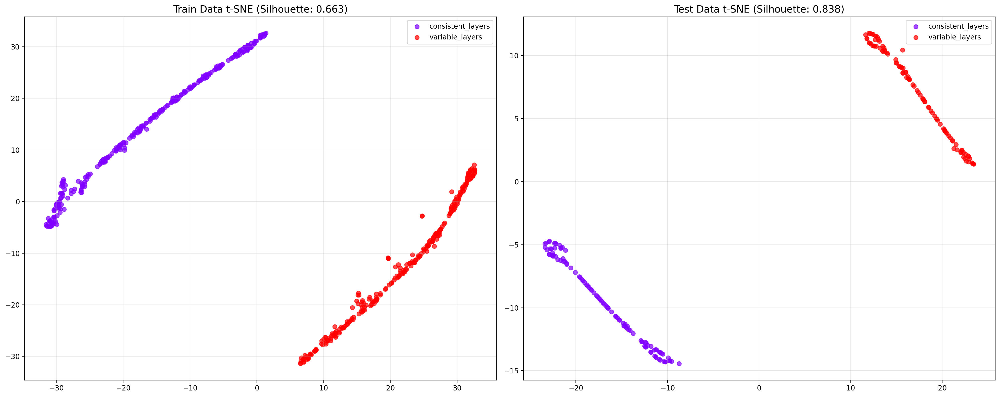

Performing final visualization at epoch 1, step 24
Epoch: 1, Step: 24 | train loss: 0.2017 | test loss: 0.1935


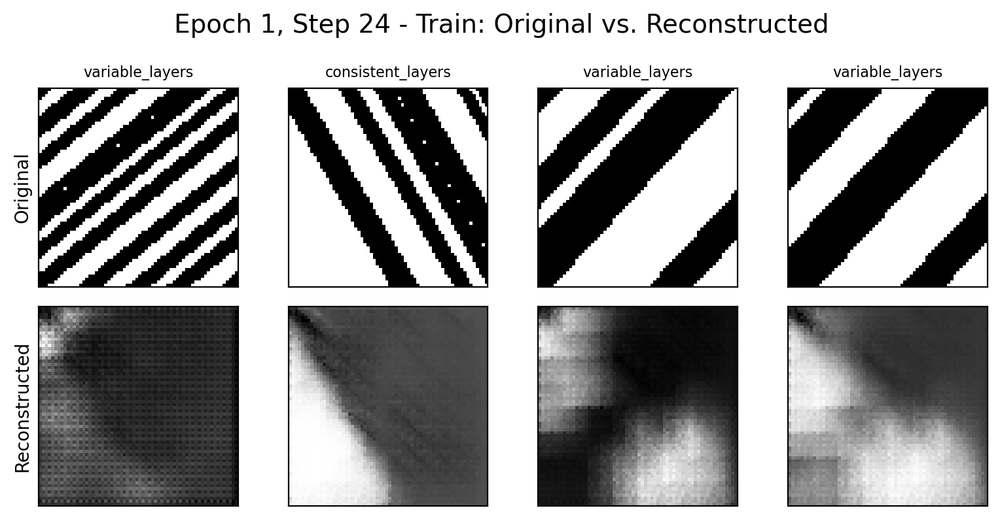

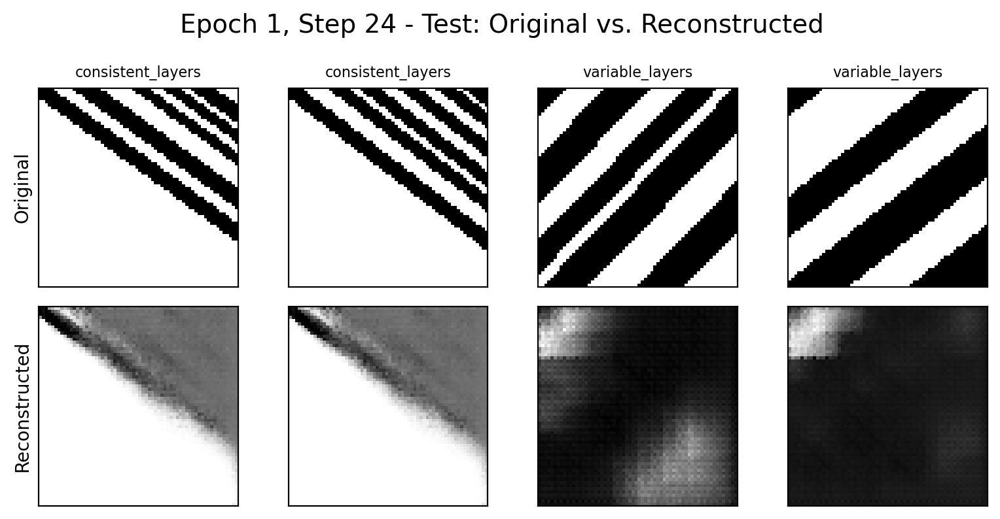

Epoch 1/2 completed | Train loss: 0.1994 | Test loss: 0.1935
Training completed in 17.87 seconds
Final train loss: 0.1917
Final test loss: 0.1935
Generating final latent space visualization and metrics
Final Test Silhouette Score: 0.507
Final Train Silhouette Score: 0.482
Model saved to latent_dim_exploration_results_layered_geology\deeper_convolutional_16d_20250513_222913_model.pth
Generating training curves for simple_linear...


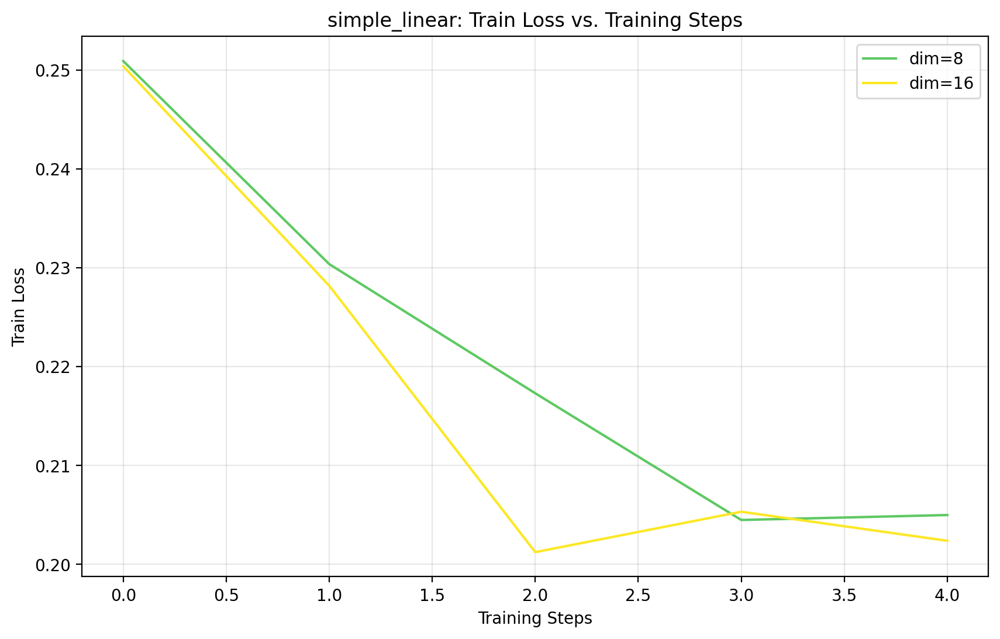

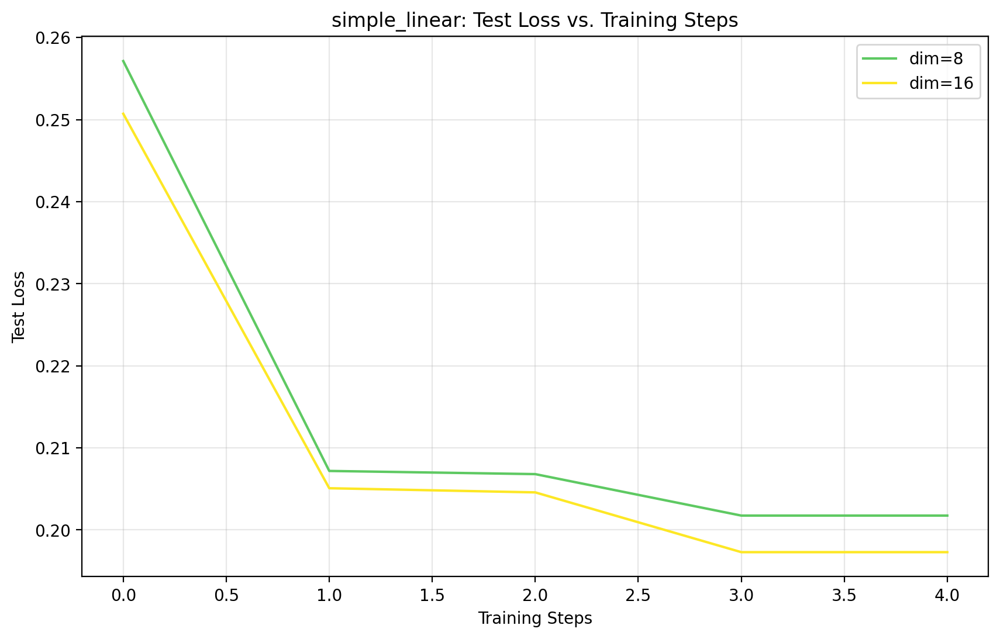

Generating training curves for deeper_linear...


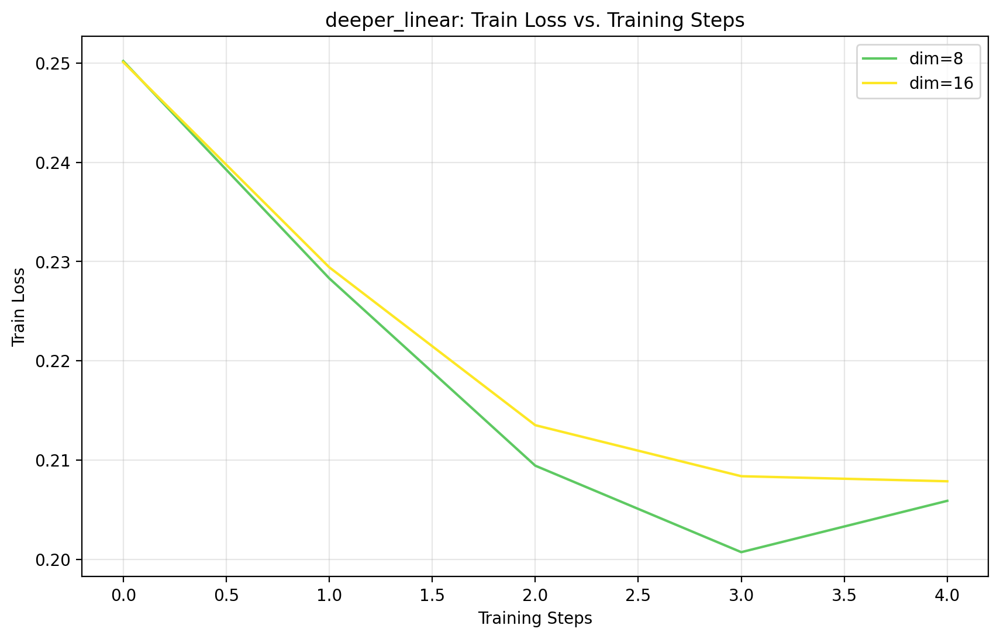

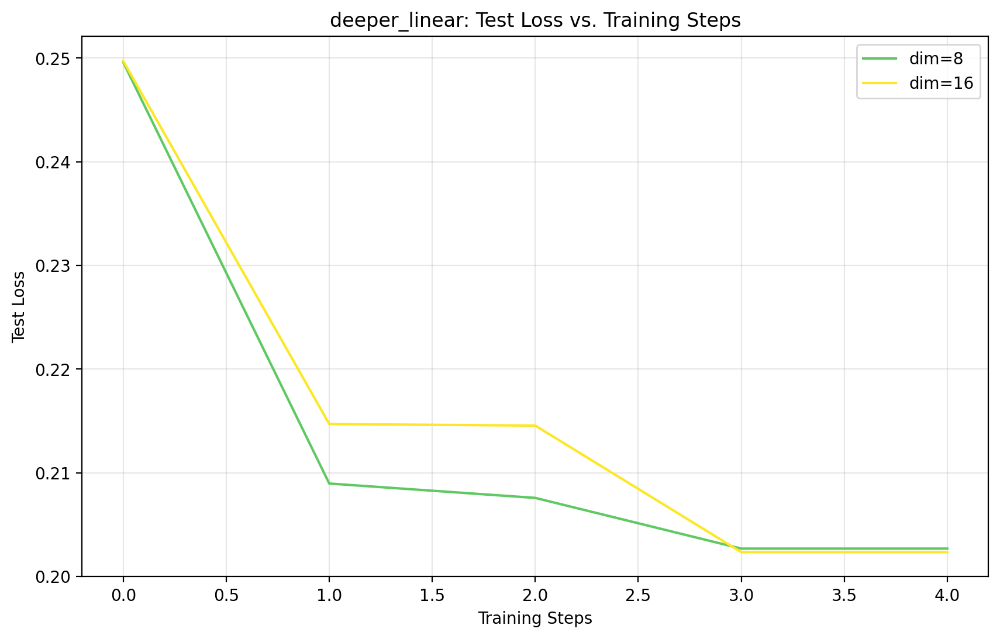

Generating training curves for convolutional...


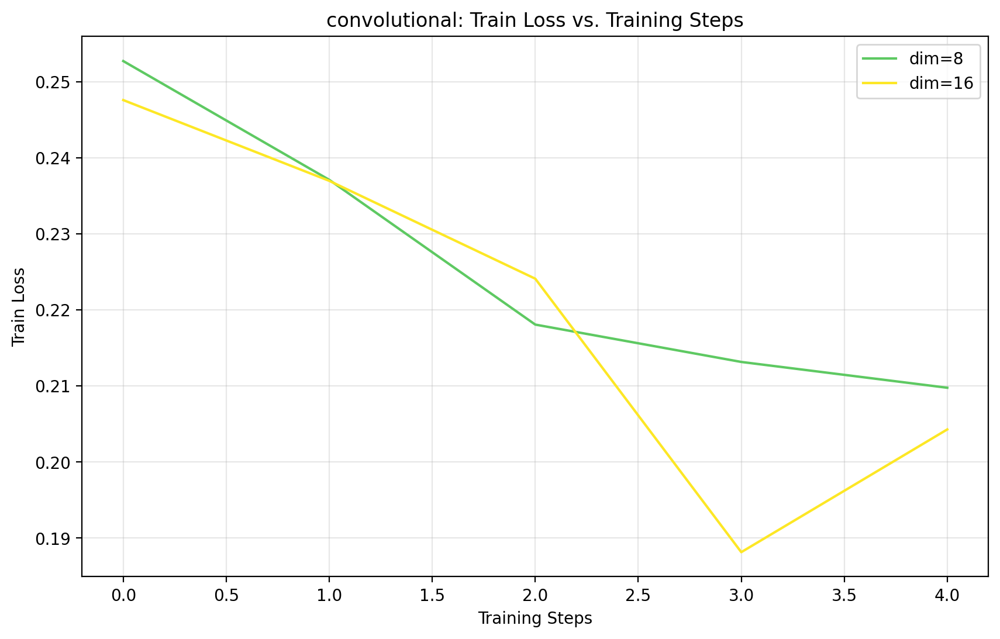

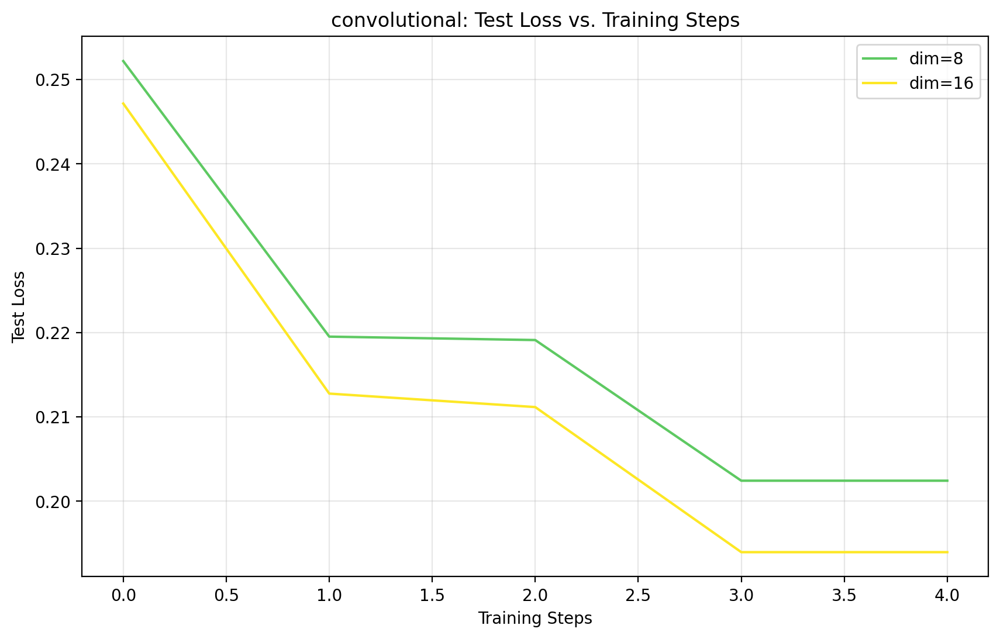

Generating training curves for deeper_convolutional...


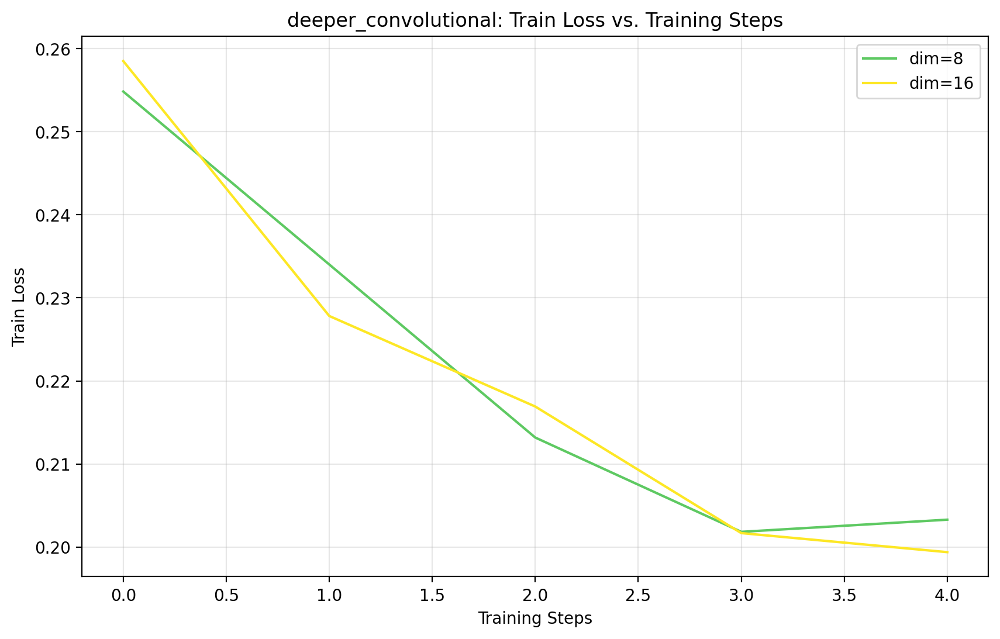

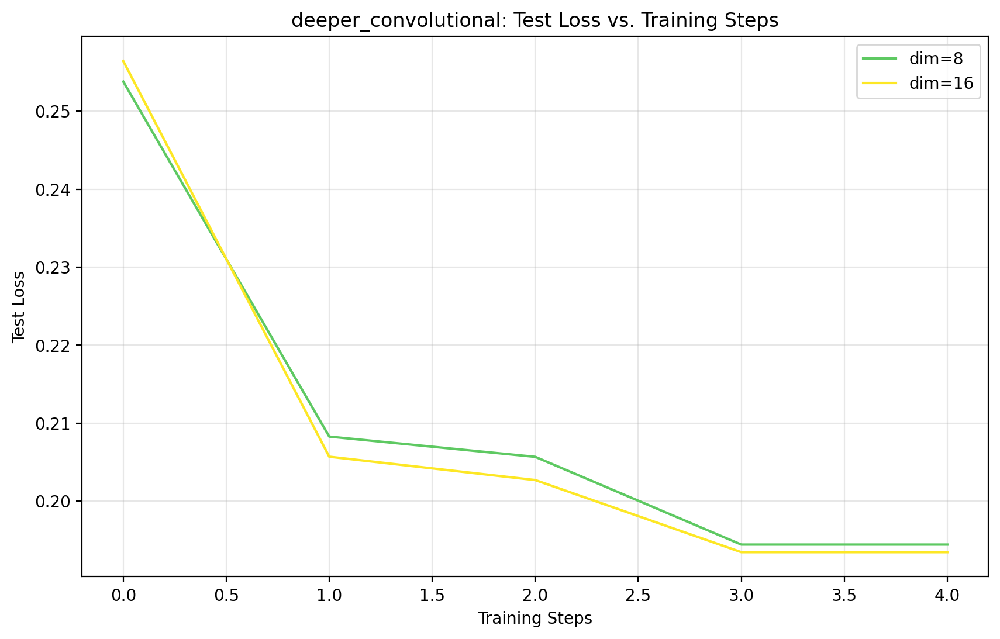

Creating metric comparison plots...


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_30204\373792028.py:319: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  ax.plot(latent_dims, metric_values, 'o-',


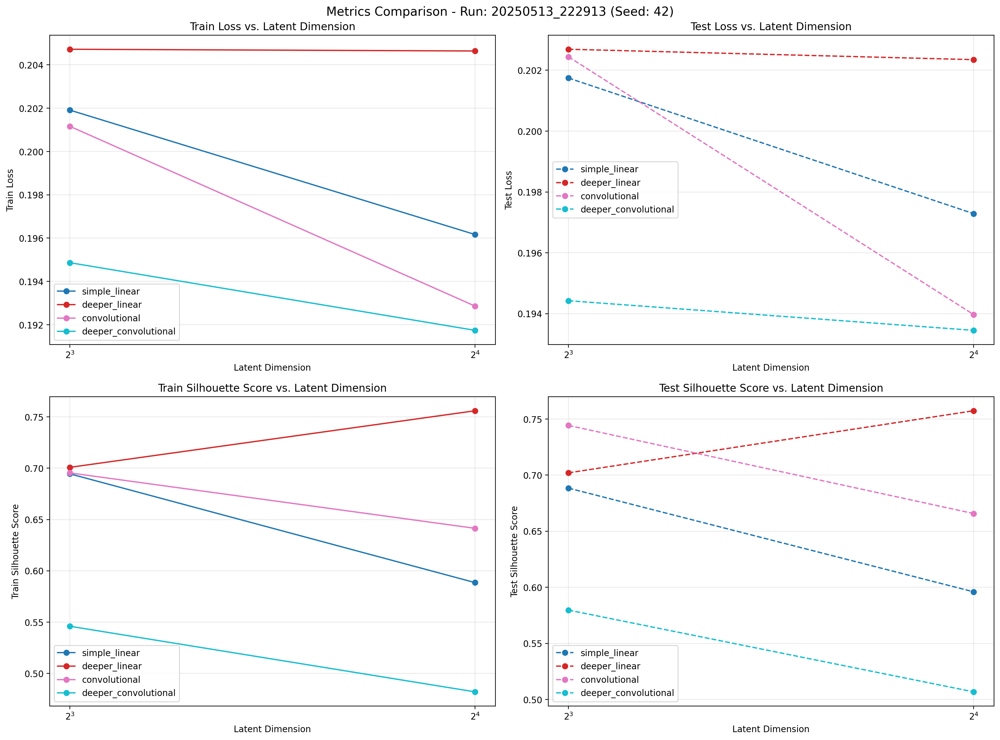

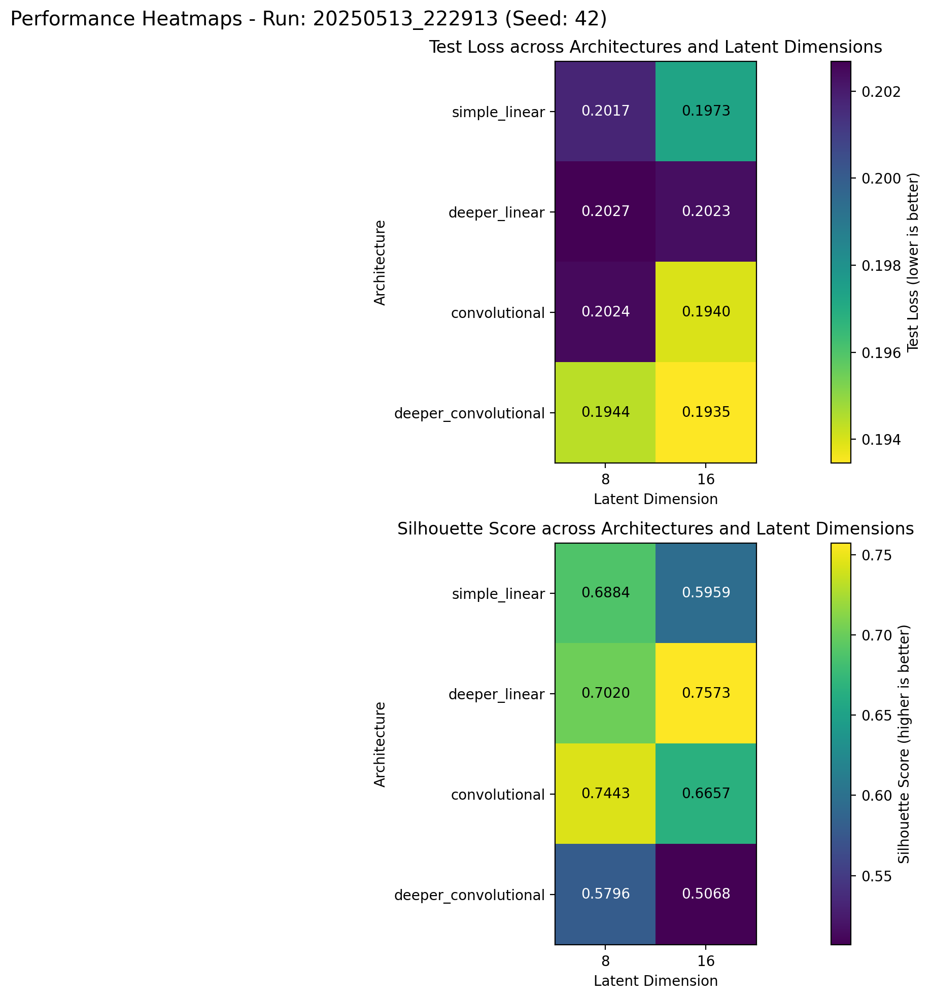


==================== simple_linear Results ====================
Latent Dim   Train Loss   Test Loss    Train Silh.  Test Silh.   Train Time  
---------------------------------------------------------------------------
8            0.2019       0.2017       0.6945003271102905 0.6883675456047058 16.51s      
16           0.1962       0.1973       0.5884666442871094 0.595928966999054 14.33s      

==================== deeper_linear Results ====================
Latent Dim   Train Loss   Test Loss    Train Silh.  Test Silh.   Train Time  
---------------------------------------------------------------------------
8            0.2047       0.2027       0.7008650302886963 0.7020231485366821 15.65s      
16           0.2046       0.2023       0.7560129761695862 0.7573424577713013 12.53s      

==================== convolutional Results ====================
Latent Dim   Train Loss   Test Loss    Train Silh.  Test Silh.   Train Time  
------------------------------------------------------------

In [4]:
"""
Systematic exploration of latent dimensions across different autoencoder architectures.

This script tests multiple latent space dimensions for each model architecture
to find the optimal combination for shape separation.
"""
# Import the updated autoencoder code directly
# #from modified_autoencoder_code import (
#     run_autoencoder_experiment, 
#     compare_models,
#     ShapeDataset,
#     load_or_create_data_split,
#     get_train_test_data,
#     seed_worker,
#     memory_efficient_evaluation,
#     visualize_reconstructions,
#     visualize_latent_space
# )
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import time
import os
import torch
import pandas as pd 
from torch.utils.data import DataLoader
from datetime import datetime
from matplotlib.colors import LogNorm

# ======================================================
# Configuration
# ======================================================

# Generate a single timestamp for the entire run session
SESSION_TIMESTAMP = datetime.now().strftime("%Y%m%d_%H%M%S")
print(f"Using session timestamp for all models: {SESSION_TIMESTAMP}")

# Set a consistent random seed for reproducibility
RANDOM_SEED = 42

# Model architectures to test
ARCHITECTURES = [
    'simple_linear',
    'deeper_linear', 
    'convolutional',
    'deeper_convolutional'
]

# Latent dimensions to test for each architecture
LATENT_DIMS = [8,16]#[8, 16, 32, 64, 128, 256, 512] #up to 4096

# Training parameters
EPOCHS = 2#100
BATCH_SIZE = 32
LEARNING_RATE = 0.001

# Dataset directory configuration
DATASET_PATH = 'layered_geologic_patterns_dataset/dataset_info.npy'

# Output directory for results
OUTPUT_DIR = "latent_dim_exploration_results_layered_geology"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Path for the consistent data split
SPLIT_PATH = os.path.join(OUTPUT_DIR, f"data_split_{SESSION_TIMESTAMP}.json")

# Data split configuration for consistency
USE_FIXED_SPLIT = True  # Whether to use a fixed train/test split
SAVE_SPLIT = True       # Whether to save the split for future runs
SPLIT_PATH = os.path.join(OUTPUT_DIR, "data_split.npy")  # Path to save/load the split
print(f"Using consistent data split: {SPLIT_PATH}")

# Create consistent dataset split once
def prepare_consistent_dataset(dataset_path, split_path, random_seed=42):
    """
    Load the dataset and create a consistent train/test split.
    
    Returns:
        train_info, test_info, dataset_info - The split dataset information
    """
    print(f"Loading dataset from {dataset_path}")
    dataset_info = np.load(dataset_path, allow_pickle=True).item()
    
    # Create the split
    print(f"Creating consistent data split at {split_path}")
    split_info = load_or_create_data_split(
        dataset_info, 
        split_path=split_path, 
        test_ratio=0.2, 
        seed=random_seed
    )
    
    # Get train/test data using the split
    train_info, test_info = get_train_test_data(dataset_info, split_info)
    
    return train_info, test_info, dataset_info

# ======================================================
# Experiment Functions
# ======================================================

def run_latent_dim_experiment(architecture, latent_dim, train_info, test_info, dataset_info, output_dir=None):
    """
    Run an autoencoder experiment with the specified architecture and latent dimension.
    
    Args:
        architecture: Model architecture name
        latent_dim: Dimension of the latent space
        train_info: Training data info dictionary
        test_info: Test data info dictionary
        dataset_info: Complete dataset information dictionary
        output_dir: Directory to save the model and results
        
    Returns:
        model, history: The trained model and its training history
    """
    # Create a descriptive experiment name with consistent timestamp
    experiment_name = f"{architecture}_{latent_dim}d_{SESSION_TIMESTAMP}"
    
    print(f"\n{'='*20} Running {architecture} with latent_dim={latent_dim} {'='*20}")
    
    # Create datasets and dataloaders
    train_dataset = ShapeDataset(train_info)
    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    
    # Load test data into memory for visualization
    test_dataset = ShapeDataset(test_info)
    all_test_data = []
    all_test_labels = []
    
    for i in range(len(test_dataset)):
        img, _, label = test_dataset[i]
        all_test_data.append(img)
        all_test_labels.append(label)
    
    test_data = torch.stack(all_test_data)
    test_labels = torch.tensor(all_test_labels)
    
    # Get class names
    class_names = dataset_info.get('label_names', [f"Class {i}" for i in range(len(np.unique(dataset_info['labels'])))])
    
    # Create the model using the existing run_autoencoder_experiment but with manually prepared datasets
    model, history = run_autoencoder_experiment(
        architecture_name=architecture,
        latent_dim=latent_dim,
        epochs=EPOCHS,
        batch_size=BATCH_SIZE,
        learning_rate=LEARNING_RATE,
        experiment_name=experiment_name,
        output_dir=output_dir,
        visualize_final=False,  # We'll handle visualization separately
        train_loader=train_loader,
        test_data=test_data,
        test_labels=test_labels,
        class_names=class_names#,
        # calculate_train_silhouette=True,  # Ensure we calculate train silhouette
        # calculate_test_silhouette=True    # Ensure we calculate test silhouette
    )
    
    # Add session timestamp to history for reference
    if history is not None:
        history['session_timestamp'] = SESSION_TIMESTAMP
    
    return model, history

def run_all_latent_dim_experiments():
    """
    Run experiments for all combinations of architectures and latent dimensions.
    
    Returns:
        Dictionary mapping architecture -> list of (model, history) tuples
    """
    # Load dataset using the global dataset path
    dataset_info = np.load(DATASET_PATH, allow_pickle=True).item()
    
    # Create train/test split
    total_samples = len(dataset_info['filenames'])
    
    # Use a fixed split if available, otherwise create a new one
    if USE_FIXED_SPLIT and os.path.exists(SPLIT_PATH):
        print(f"Loading fixed data split from {SPLIT_PATH}")
        split_data = np.load(SPLIT_PATH, allow_pickle=True).item()
        train_indices = split_data['train_indices']
        test_indices = split_data['test_indices']
    else:
        # Create a new random split
        indices = np.random.permutation(total_samples)
        split_idx = int(total_samples * 0.8)  # 80% for training
        train_indices = indices[:split_idx]
        test_indices = indices[split_idx:]
        
        # Save the split if needed
        if SAVE_SPLIT:
            split_data = {
                'train_indices': train_indices,
                'test_indices': test_indices
            }
            np.save(SPLIT_PATH, split_data)
            print(f"Saved data split to {SPLIT_PATH}")
    
    # Create separate dataset info for train and test
    train_info = {
        'filenames': [dataset_info['filenames'][i] for i in train_indices],
        'labels': [dataset_info['labels'][i] for i in train_indices]
    }
    
    test_info = {
        'filenames': [dataset_info['filenames'][i] for i in test_indices],
        'labels': [dataset_info['labels'][i] for i in test_indices]
    }
    
    # Dictionary to store results for each architecture
    all_results = {arch: [] for arch in ARCHITECTURES}
    
    # Run experiments for each architecture and latent dimension
    for architecture in ARCHITECTURES:
        for latent_dim in LATENT_DIMS:
            model, history = run_latent_dim_experiment(
                architecture=architecture,
                latent_dim=latent_dim,
                train_info=train_info,
                test_info=test_info,
                dataset_info=dataset_info,
                output_dir=OUTPUT_DIR
            )
            
            # Store the results
            all_results[architecture].append((model, history))
    
    return all_results

# ======================================================
# Analysis and Visualization
# ======================================================

def get_architecture_color_map():
    """
    Get a consistent color mapping for architectures using tab10 colormap.
    
    Returns:
        Dictionary mapping architecture name to RGB color
    """
    cmap = plt.cm.tab10
    arch_colors = {}
    
    for i, arch in enumerate(ARCHITECTURES):
        arch_colors[arch] = cmap(i % 10)
    
    return arch_colors

def get_latent_dim_color_map(latent_dims):
    """
    Get a consistent color mapping for latent dimensions using viridis colormap with log scale.
    
    Args:
        latent_dims: List of latent dimensions to map
    
    Returns:
        Dictionary mapping latent dimension to RGB color
    """
    cmap = plt.cm.viridis
    
    # Create a log-scaled normalization for better color distribution
    min_dim = min(latent_dims)
    max_dim = max(latent_dims)
    norm = LogNorm(vmin=min_dim, vmax=max_dim)
    
    # Map each dimension to a color
    dim_colors = {}
    for dim in latent_dims:
        # Normalize the dimension in the range [0, 1]
        norm_dim = norm(dim)
        dim_colors[dim] = cmap(norm_dim)
    
    return dim_colors

def plot_metrics_vs_latent_dim(all_results):
    """
    Plot metrics (test/train loss and silhouette scores) versus latent dimension for each architecture.
    
    Args:
        all_results: Dictionary mapping architecture -> list of (model, history) tuples
    """
    # Get list of architectures and create color array (same approach as plot_latent_dim_comparison)
    architectures = list(all_results.keys())
    colors = plt.cm.tab10(np.linspace(0, 1, len(architectures)))
    
    # Create a 2x2 subplot grid for different metrics
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Define the metrics to plot
    metrics = [
        ('final_train_loss', 'Train Loss', axes[0, 0], '-'),  # Solid line for train metrics
        ('final_test_loss', 'Test Loss', axes[0, 1], '--'),   # Dashed line for test metrics
        ('final_train_silhouette', 'Train Silhouette Score', axes[1, 0], '-'),  # Solid line for train metrics
        ('final_silhouette', 'Test Silhouette Score', axes[1, 1], '--')   # Dashed line for test metrics
    ]
    
    for i, (architecture, results) in enumerate(all_results.items()):
        # Sort results by latent dimension
        sorted_results = sorted(results, key=lambda x: x[1].get('latent_dim', 0))
        
        for metric_key, metric_label, ax, linestyle in metrics:
            latent_dims = []
            metric_values = []
            
            # Use a set to track unique latent dimensions
            seen_dims = set()
            
            for model, history in sorted_results:
                latent_dim = history.get('latent_dim', 0)
                if latent_dim not in seen_dims and metric_key in history:
                    seen_dims.add(latent_dim)
                    latent_dims.append(latent_dim)
                    metric_values.append(history.get(metric_key, 0))
            
            # Plot with consistent colors and specified linestyle
            if latent_dims and metric_values:
                ax.plot(latent_dims, metric_values, 'o-', 
                        label=architecture, 
                        color=colors[i],  # Index-based color assignment like in plot_latent_dim_comparison
                        linestyle=linestyle)  # Use different linestyles for train vs test
                
                ax.set_title(f'{metric_label} vs. Latent Dimension')
                ax.set_xlabel('Latent Dimension')
                ax.set_ylabel(metric_label)
                ax.grid(True, alpha=0.3)
                ax.set_xscale('log', base=2)  # Log scale for latent dimensions
                ax.legend()
    
    # Add session timestamp and seed information
    plt.suptitle(f"Metrics Comparison - Run: {SESSION_TIMESTAMP} (Seed: {RANDOM_SEED})", fontsize=14)
    plt.tight_layout()
    
    # Save the figure
    plt.savefig(os.path.join(OUTPUT_DIR, f'metrics_vs_latent_dim_comparison_{SESSION_TIMESTAMP}.png'), dpi=300)
    plt.show()

def plot_latent_dim_comparison(all_results):
    """
    Create plots comparing the effect of latent dimension on each architecture.
    
    Args:
        all_results: Dictionary mapping architecture -> list of (model, history) tuples
    """
    # Get list of architectures and create color array
    architectures = list(all_results.keys())
    colors = plt.cm.tab10(np.linspace(0, 1, len(architectures)))
    
    # Plot test loss vs. latent dimension
    plt.figure(figsize=(12, 8))
    
    # Create subplots for test loss and silhouette score
    plt.subplot(2, 1, 1)
    
    for i, (architecture, results) in enumerate(all_results.items()):
        latent_dims = []
        test_losses = []
        
        # Sort results by latent dimension
        sorted_results = sorted(results, key=lambda x: x[1].get('latent_dim', 0))
        
        # Use a set to track unique latent dimensions for this architecture
        seen_dims = set()
        
        for model, history in sorted_results:
            latent_dim = history.get('latent_dim', 0)
            if latent_dim not in seen_dims:
                seen_dims.add(latent_dim)
                latent_dims.append(latent_dim)
                test_losses.append(history.get('final_test_loss', 0))
        
        plt.plot(latent_dims, test_losses, 'o-', 
                 label=architecture, 
                 color=colors[i],  # Using index-based color assignment
                 linestyle='--')
    
    plt.title('Test Loss vs. Latent Dimension')
    plt.xlabel('Latent Dimension')
    plt.ylabel('Final Test Loss')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xscale('log', base=2)  # Log scale for latent dimensions
    
    # Plot silhouette score vs. latent dimension
    plt.subplot(2, 1, 2)
    
    for i, (architecture, results) in enumerate(all_results.items()):
        latent_dims = []
        silhouette_scores = []
        
        # Sort results by latent dimension
        sorted_results = sorted(results, key=lambda x: x[1].get('latent_dim', 0))
        
        # Use a set to track unique latent dimensions for this architecture
        seen_dims = set()
        
        for model, history in sorted_results:
            latent_dim = history.get('latent_dim', 0)
            if latent_dim not in seen_dims:
                seen_dims.add(latent_dim)
                latent_dims.append(latent_dim)
                silhouette_scores.append(history.get('final_silhouette', 0))
        
        plt.plot(latent_dims, silhouette_scores, 'o-', 
                 label=architecture,
                 color=colors[i],  # Using index-based color assignment
                 linestyle='--')
    
    plt.title('Cluster Separation (Silhouette Score) vs. Latent Dimension')
    plt.xlabel('Latent Dimension')
    plt.ylabel('Silhouette Score')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xscale('log', base=2)  # Log scale for latent dimensions
    
    # Add session timestamp and seed information to the plot
    plt.suptitle(f"Run: {SESSION_TIMESTAMP} (Seed: {RANDOM_SEED})", fontsize=12)
    
    plt.tight_layout()
    # Include timestamp in the output filename
    plt.savefig(os.path.join(OUTPUT_DIR, f'latent_dim_comparison_{SESSION_TIMESTAMP}.png'), dpi=300)
    plt.show()

def create_performance_heatmaps(all_results):
    """
    Create heatmaps showing performance metrics across architectures and latent dimensions.
    
    Args:
        all_results: Dictionary mapping architecture -> list of (model, history) tuples
    """
    # Get all unique latent dimensions
    all_dims = set()
    for results in all_results.values():
        for _, history in results:
            all_dims.add(history.get('latent_dim', 0))
    
    all_dims = sorted(list(all_dims))
    
    # Prepare data for heatmaps
    test_loss_data = np.zeros((len(ARCHITECTURES), len(all_dims)))
    silhouette_data = np.zeros((len(ARCHITECTURES), len(all_dims)))
    
    # Fill in the data
    for i, architecture in enumerate(ARCHITECTURES):
        results = all_results[architecture]
        for _, history in results:
            latent_dim = history.get('latent_dim', 0)
            dim_idx = all_dims.index(latent_dim)
            
            test_loss_data[i, dim_idx] = history.get('final_test_loss', 0)
            silhouette_data[i, dim_idx] = history.get('final_silhouette', 0)
    
    # Create heatmap figures
    fig, axes = plt.subplots(2, 1, figsize=(15, 10))
    
    # Test Loss Heatmap
    im1 = axes[0].imshow(test_loss_data, cmap='viridis_r')  # Using viridis_r so lower values (better) are darker
    axes[0].set_title('Test Loss across Architectures and Latent Dimensions')
    axes[0].set_xlabel('Latent Dimension')
    axes[0].set_ylabel('Architecture')
    axes[0].set_xticks(np.arange(len(all_dims)))
    axes[0].set_yticks(np.arange(len(ARCHITECTURES)))
    axes[0].set_xticklabels(all_dims)
    axes[0].set_yticklabels(ARCHITECTURES)
    
    # Add color bar
    cbar1 = fig.colorbar(im1, ax=axes[0])
    cbar1.set_label('Test Loss (lower is better)')
    
    # Add test loss values to the heatmap
    for i in range(len(ARCHITECTURES)):
        for j in range(len(all_dims)):
            text = axes[0].text(j, i, f"{test_loss_data[i, j]:.4f}",
                               ha="center", va="center", color="w" if test_loss_data[i, j] > np.mean(test_loss_data) else "black")
    
    # Silhouette Score Heatmap
    im2 = axes[1].imshow(silhouette_data, cmap='viridis')  # Using viridis so higher values (better) are darker
    axes[1].set_title('Silhouette Score across Architectures and Latent Dimensions')
    axes[1].set_xlabel('Latent Dimension')
    axes[1].set_ylabel('Architecture')
    axes[1].set_xticks(np.arange(len(all_dims)))
    axes[1].set_yticks(np.arange(len(ARCHITECTURES)))
    axes[1].set_xticklabels(all_dims)
    axes[1].set_yticklabels(ARCHITECTURES)
    
    # Add color bar
    cbar2 = fig.colorbar(im2, ax=axes[1])
    cbar2.set_label('Silhouette Score (higher is better)')
    
    # Add silhouette values to the heatmap
    for i in range(len(ARCHITECTURES)):
        for j in range(len(all_dims)):
            text = axes[1].text(j, i, f"{silhouette_data[i, j]:.4f}",  # Changed from .3f to .4f
                               ha="center", va="center", color="w" if silhouette_data[i, j] < np.mean(silhouette_data) else "black")
    
    # Add session timestamp and seed information
    plt.suptitle(f"Performance Heatmaps - Run: {SESSION_TIMESTAMP} (Seed: {RANDOM_SEED})", fontsize=14)
    
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, f'performance_heatmaps_{SESSION_TIMESTAMP}.png'), dpi=300)
    plt.show()

def create_comparison_tables(all_results):
    """
    Create comparison tables for each architecture across different latent dimensions.
    
    Args:
        all_results: Dictionary mapping architecture -> list of (model, history) tuples
    """
    for architecture, results in all_results.items():
        print(f"\n{'='*20} {architecture} Results {'='*20}")
        
        # Sort results by latent dimension
        sorted_results = sorted(results, key=lambda x: x[1].get('latent_dim', 0))
        
        # Print header
        print(f"{'Latent Dim':<12} {'Train Loss':<12} {'Test Loss':<12} {'Train Silh.':<12} {'Test Silh.':<12} {'Train Time':<12}")
        print("-" * 75)
        
        # Print results for each latent dimension
        for model, history in sorted_results:
            latent_dim = history.get('latent_dim', 'N/A')
            train_loss = history.get('final_train_loss', 'N/A')
            test_loss = history.get('final_test_loss', 'N/A')
            train_silhouette = history.get('final_train_silhouette', 'N/A')
            test_silhouette = history.get('final_silhouette', 'N/A')
            train_time = history.get('training_time', 'N/A')
            
            # Format values
            if isinstance(train_loss, (int, float)):
                train_loss = f"{train_loss:.4f}"
            if isinstance(test_loss, (int, float)):
                test_loss = f"{test_loss:.4f}"
            if isinstance(train_silhouette, (int, float)):
                train_silhouette = f"{train_silhouette:.4f}"
            if isinstance(test_silhouette, (int, float)):
                test_silhouette = f"{test_silhouette:.4f}"
            if isinstance(train_time, (int, float)):
                train_time = f"{train_time:.2f}s"
            
            print(f"{latent_dim:<12} {train_loss:<12} {test_loss:<12} {train_silhouette:<12} {test_silhouette:<12} {train_time:<12}")
    
    # Create a list of unique models based on architecture and latent dimension
    all_models = []
    seen_configs = set()
    
    for arch_results in all_results.values():
        for model, history in arch_results:
            model_key = (history['model_name'], history.get('latent_dim', 0))
            if model_key not in seen_configs:
                seen_configs.add(model_key)
                all_models.append((model, history))
    
    # Create a DataFrame with formatted values for best model comparisons
    formatted_df = pd.DataFrame([
        {
            'Model': history.get('model_name', 'Unknown'),
            'Latent Dim': history.get('latent_dim', 'N/A'),
            'Epochs': history.get('epochs', 'N/A'),
            'Final Loss': f"{history.get('final_test_loss', 'N/A'):.4f}" if isinstance(history.get('final_test_loss'), (int, float)) else history.get('final_test_loss'),
            'Train Silh.': f"{history.get('final_train_silhouette', 'N/A'):.4f}" if isinstance(history.get('final_train_silhouette'), (int, float)) else history.get('final_train_silhouette'),
            'Test Silh.': f"{history.get('final_silhouette', 'N/A'):.4f}" if isinstance(history.get('final_silhouette'), (int, float)) else history.get('final_silhouette'),
            'Train Time': f"{history.get('training_time', 'N/A'):.2f}s" if isinstance(history.get('training_time'), (int, float)) else history.get('training_time')
        }
        for model, history in all_models
    ])
    
    # Display tables in sorted order
    print(f"\n\nBest Models by Reconstruction (Test Loss) - Run: {SESSION_TIMESTAMP}:")
    print(formatted_df.sort_values('Final Loss').to_string(index=False))
    
    print(f"\n\nBest Models by Cluster Separation (Silhouette Score) - Run: {SESSION_TIMESTAMP}:")
    print(formatted_df.sort_values('Test Silh.', ascending=False).to_string(index=False))
    
    print(f"\n\nBest Models by Train Cluster Separation (Train Silhouette Score) - Run: {SESSION_TIMESTAMP}:")
    print(formatted_df.sort_values('Train Silh.', ascending=False).to_string(index=False))

def custom_compare_models(models, metric='final_test_loss', top_n=None, ascending=None):
    """
    Custom implementation of compare_models that formats outputs with consistent decimal places.
    
    Args:
        models: List of (model, history) tuples to compare
        metric: Metric to sort by
        top_n: Number of top models to display (None for all)
        ascending: Sort order (True for ascending, False for descending, None for automatic based on metric)
    """
    if ascending is None:
        # Default: ascending=True for loss metrics (lower is better), False otherwise (higher is better)
        ascending = 'loss' in metric.lower()
    
    # Filter out models that don't have the metric
    filtered_models = [(model, history) for model, history in models if metric in history]
    
    if not filtered_models:
        print(f"No models found with metric: {metric}")
        return
    
    # Sort by the specified metric
    sorted_models = sorted(filtered_models, key=lambda x: x[1][metric], reverse=not ascending)
    
    if top_n is not None:
        sorted_models = sorted_models[:top_n]
    
    # Print the comparison table header
    print(f"Model Comparison by {metric}:")
    print("-" * 80)
    print(f"{'Model':<25} {'Latent Dim':<12} {'Epochs':<8} {'Final Loss':<12} {'Train Silh.':<12} {'Test Silh.':<12} {'Train Time':<12}")
    print("-" * 80)
    
    # Print each model's metrics
    for model, history in sorted_models:
        model_name = history.get('model_name', 'Unknown')
        latent_dim = history.get('latent_dim', 'N/A')
        epochs = history.get('epochs', 'N/A')
        final_loss = history.get('final_test_loss', 'N/A')
        train_silhouette = history.get('final_train_silhouette', 'N/A')
        test_silhouette = history.get('final_silhouette', 'N/A')
        train_time = history.get('training_time', 'N/A')
        
        # Format values to consistent decimal places
        if isinstance(final_loss, (int, float)):
            final_loss = f"{final_loss:.4f}"
        if isinstance(train_silhouette, (int, float)):
            train_silhouette = f"{train_silhouette:.4f}"
        if isinstance(test_silhouette, (int, float)):
            test_silhouette = f"{test_silhouette:.4f}"
        if isinstance(train_time, (int, float)):
            train_time = f"{train_time:.2f}s"
        
        print(f"{model_name:<25} {latent_dim:<12} {epochs:<8} {final_loss:<12} {train_silhouette:<12} {test_silhouette:<12} {train_time:<12}")

def save_experiment_summary(all_results):
    """
    Save a summary of all experiment results to a CSV file.
    
    Args:
        all_results: Dictionary mapping architecture -> list of (model, history) tuples
    """
    import csv
    
    # Prepare CSV file with timestamp in the filename
    summary_filename = os.path.join(OUTPUT_DIR, f'experiment_summary_{SESSION_TIMESTAMP}.csv')
    with open(summary_filename, 'w', newline='') as csvfile:
        fieldnames = [
            'Architecture', 'Latent Dim', 'Train Loss', 'Test Loss',
            'Train Silhouette', 'Test Silhouette', 
            'Training Time (s)', 'Timestamp', 'Random Seed'
        ]
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        
        writer.writeheader()
        
        # Write results for each experiment
        for architecture, results in all_results.items():
            for model, history in results:
                # Format numeric values consistently before writing to CSV
                train_loss = history.get('final_train_loss', 'N/A')
                if isinstance(train_loss, (int, float)):
                    train_loss = f"{train_loss:.4f}"
                    
                test_loss = history.get('final_test_loss', 'N/A')
                if isinstance(test_loss, (int, float)):
                    test_loss = f"{test_loss:.4f}"
                    
                train_silhouette = history.get('final_train_silhouette', 'N/A')
                if isinstance(train_silhouette, (int, float)):
                    train_silhouette = f"{train_silhouette:.4f}"
                    
                test_silhouette = history.get('final_silhouette', 'N/A')
                if isinstance(test_silhouette, (int, float)):
                    test_silhouette = f"{test_silhouette:.4f}"
                    
                train_time = history.get('training_time', 'N/A')
                if isinstance(train_time, (int, float)):
                    train_time = f"{train_time:.2f}"
                
                writer.writerow({
                    'Architecture': architecture,
                    'Latent Dim': history.get('latent_dim', 'N/A'),
                    'Train Loss': train_loss,
                    'Test Loss': test_loss,
                    'Train Silhouette': train_silhouette,
                    'Test Silhouette': test_silhouette,
                    'Training Time (s)': train_time,
                    'Timestamp': SESSION_TIMESTAMP,
                    'Random Seed': RANDOM_SEED
                })
    
    print(f"Experiment summary saved to {summary_filename}")

def plot_training_metrics(architecture, results, metrics=['train_loss', 'test_loss']):
    """
    Plot training metrics for different latent dimensions of the same architecture.
    
    Args:
        architecture: Name of the architecture
        results: List of (model, history) tuples for this architecture
        metrics: List of metrics to plot
    """
    # Sort results by latent dimension
    sorted_results = sorted(results, key=lambda x: x[1].get('latent_dim', 0))
    
    # # Get a color map for latent dimensions
    latent_dims = [r[1].get('latent_dim', 0) for r in sorted_results]
    unique_dims = sorted(set(latent_dims))
    # dim_colors = get_latent_dim_color_map(latent_dims)
    # Map from log2 scale to color map index
    color_indices = [np.log2(dim)/np.log2(max(unique_dims)) for dim in unique_dims]
    color_map = plt.cm.viridis  # Using viridis for a sequential colormap
    dim_colors = {dim: color_map(idx) for dim, idx in zip(unique_dims, color_indices)}
    if not sorted_results:
        print(f"No results to plot for {architecture}")
        return
    
    # Create plots for each metric
    for metric in metrics:
        plt.figure(figsize=(10, 6))
        
        for model, history in sorted_results:
            latent_dim = history.get('latent_dim', 'Unknown')
            if metric in history and len(history[metric]) > 0:
                plt.plot(
                    history[metric], 
                    label=f"dim={latent_dim}",
                    color=dim_colors.get(latent_dim, 'blue')
                )
        
        plt.title(f"{architecture}: {metric.replace('_', ' ').title()} vs. Training Steps")
        plt.xlabel("Training Steps")
        plt.ylabel(metric.replace('_', ' ').title())
        plt.legend()
        plt.grid(alpha=0.3)
        
        # Save the plot
        plt.savefig(os.path.join(OUTPUT_DIR, f"{architecture}_{metric}_{SESSION_TIMESTAMP}.png"), dpi=300)
        plt.show()


# ======================================================
# Main Execution
# ======================================================

if __name__ == "__main__":
    print("Starting systematic latent dimension exploration...")
    print(f"Testing architectures: {ARCHITECTURES}")
    print(f"Testing latent dimensions: {LATENT_DIMS}")
    print(f"Using dataset: {DATASET_PATH}")
    print(f"Using random seed: {RANDOM_SEED}")
    print(f"Using consistent data split: {SPLIT_PATH}")
    
    # Run all experiments
    results = run_all_latent_dim_experiments()
    
    # Generate training metrics plots for each architecture
    for architecture, arch_results in results.items():
        print(f"Generating training curves for {architecture}...")
        plot_training_metrics(architecture, arch_results, metrics=['train_loss', 'test_loss'])
    
    # Create comparison visualizations
    print("Creating metric comparison plots...")
    plot_metrics_vs_latent_dim(results)
    
    # Create the standard plots and tables
    # plot_latent_dim_comparison(results)
    create_performance_heatmaps(results)
    create_comparison_tables(results)
    save_experiment_summary(results)
    
    print("\nLatent dimension exploration complete!")
    print(f"Results saved to {OUTPUT_DIR}/ with timestamp {SESSION_TIMESTAMP}")

Using random seed: 42 for consistent results
Analyzing models in latent_dim_exploration_results_layered_geology matching pattern '20250507_225424'
Found 8 model files in 'latent_dim_exploration_results_layered_geology' (sorted by file creation time):
1. simple_linear_8d_20250507_225424_model.pth (created: 2025-05-07 22:54:40)
2. simple_linear_16d_20250507_225424_model.pth (created: 2025-05-07 22:54:58)
3. deeper_linear_8d_20250507_225424_model.pth (created: 2025-05-07 22:55:17)
4. deeper_linear_16d_20250507_225424_model.pth (created: 2025-05-07 22:55:34)
5. convolutional_8d_20250507_225424_model.pth (created: 2025-05-07 22:55:51)
6. convolutional_16d_20250507_225424_model.pth (created: 2025-05-07 22:56:10)
7. deeper_convolutional_8d_20250507_225424_model.pth (created: 2025-05-07 22:56:31)
8. deeper_convolutional_16d_20250507_225424_model.pth (created: 2025-05-07 22:56:54)
Found 8 model files (sorted by timestamp, architecture, and latent dimension)
Loading dataset from layered_geologic

C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

<Figure size 640x480 with 0 Axes>

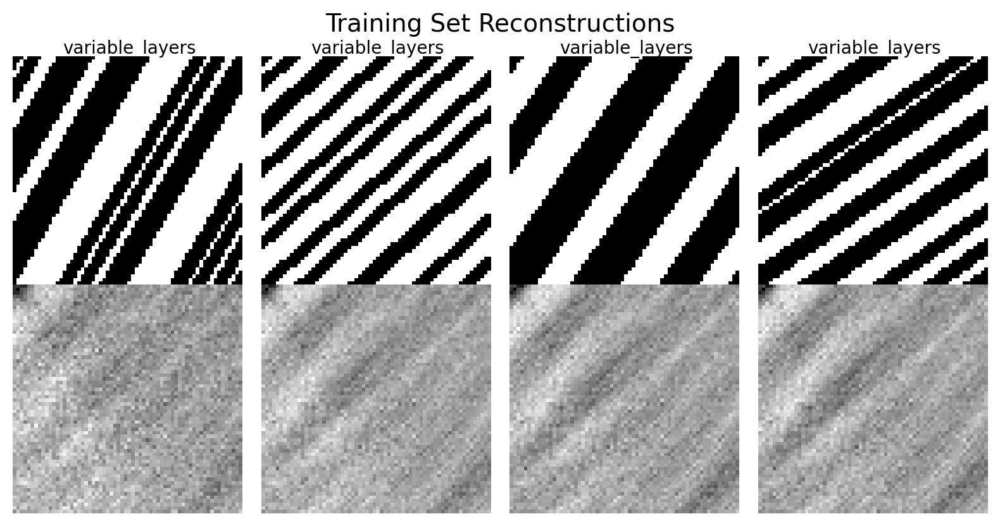

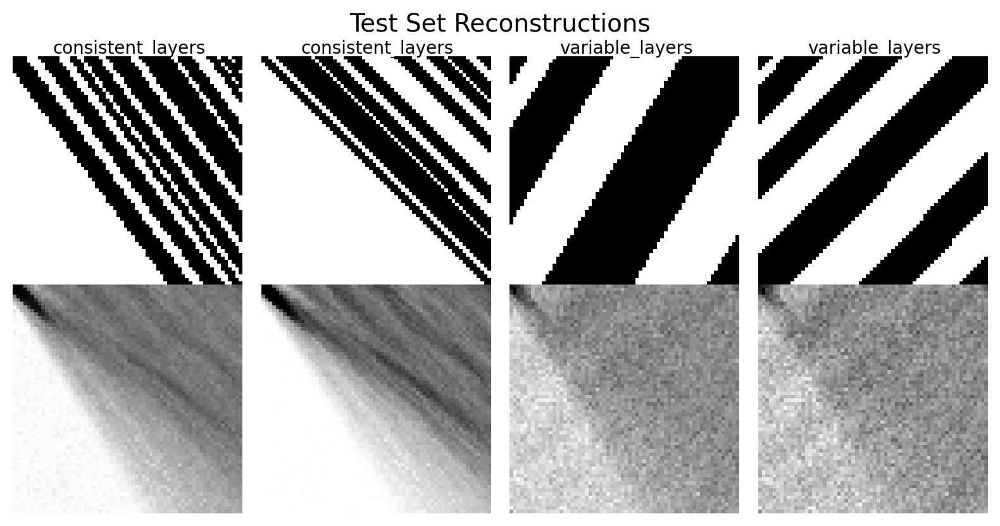


Visualizing latent spaces (train and test):
Train data silhouette score: 0.688053
Test data silhouette score: 0.723245
Similarity to original score: 91.86%


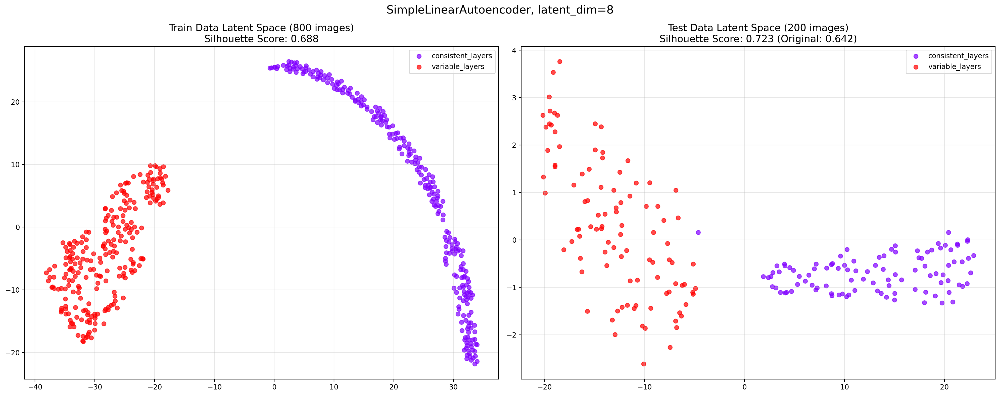


--------------------------------------------------
Evaluating simple_linear_16d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\simple_linear_16d_20250507_225424_model.pth
Architecture: simple_linear, Latent dimension: 16
Model was trained for 2 epochs
Final test loss from training: 0.20595264315605163
Original silhouette score: 0.5774067044258118
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.202158
Final test loss from training history: 0.205953
Final train silhouette score from training history: 0.604347
Final test silhouette score from training history: 0.577407
Recalculated test loss using original evaluation function: 0.198413

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

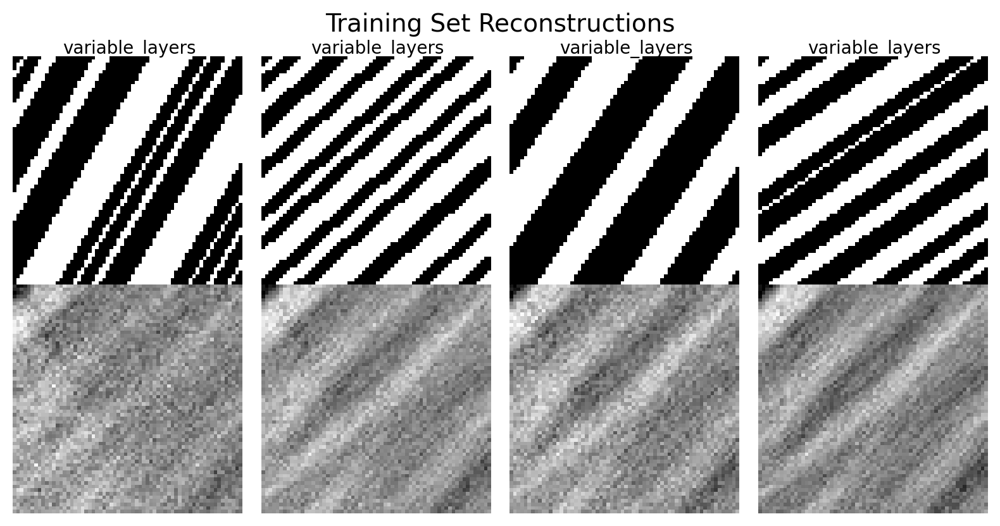

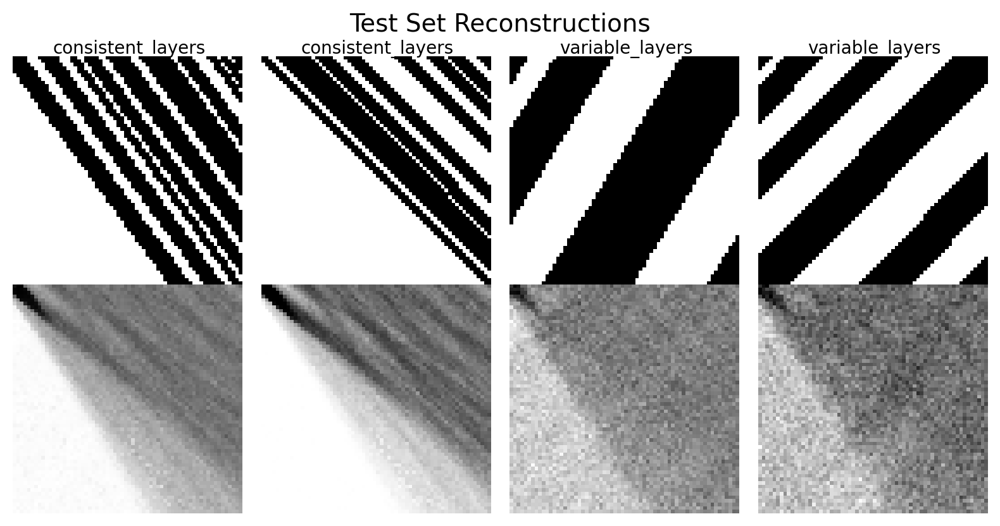


Visualizing latent spaces (train and test):
Train data silhouette score: 0.677838
Test data silhouette score: 0.713801
Similarity to original score: 86.36%


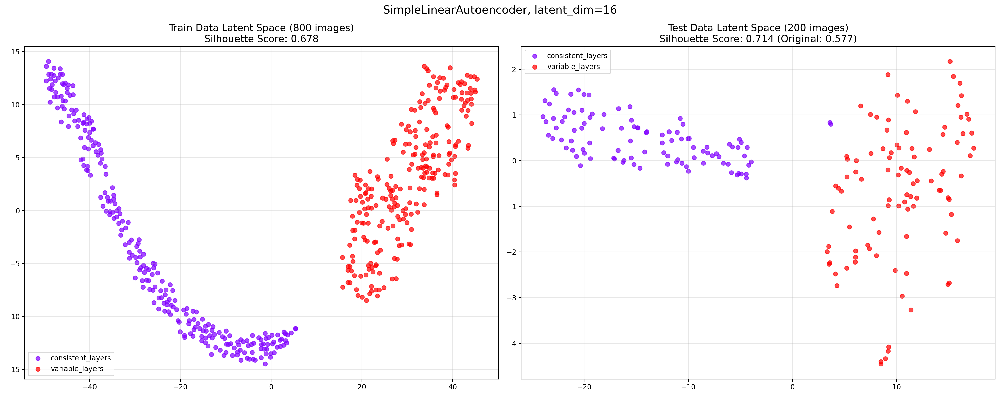


--------------------------------------------------
Evaluating deeper_linear_8d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\deeper_linear_8d_20250507_225424_model.pth
Architecture: deeper_linear, Latent dimension: 8
Model was trained for 2 epochs
Final test loss from training: 0.20799065113067627
Original silhouette score: 0.6717325448989868
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.205152
Final test loss from training history: 0.207991
Final train silhouette score from training history: 0.660821
Final test silhouette score from training history: 0.671733
Recalculated test loss using original evaluation function: 0.200697

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

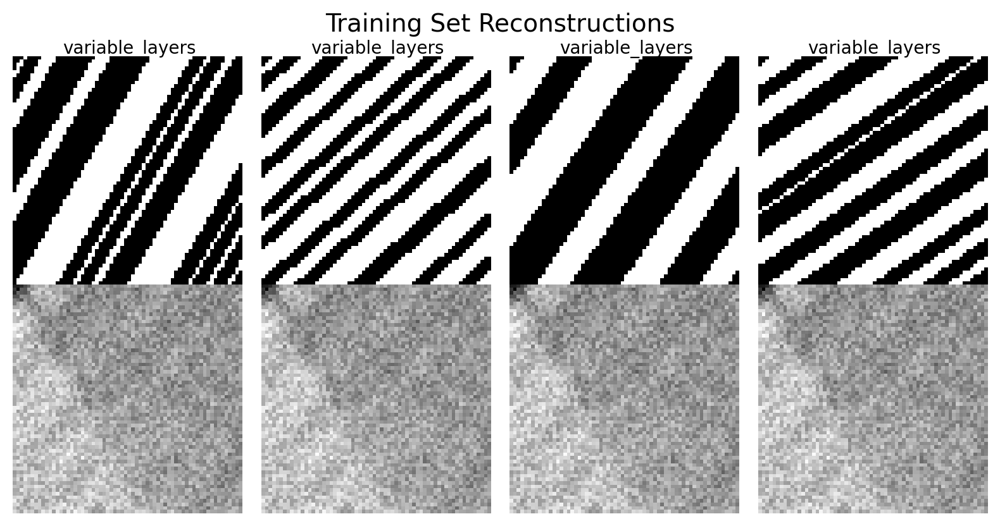

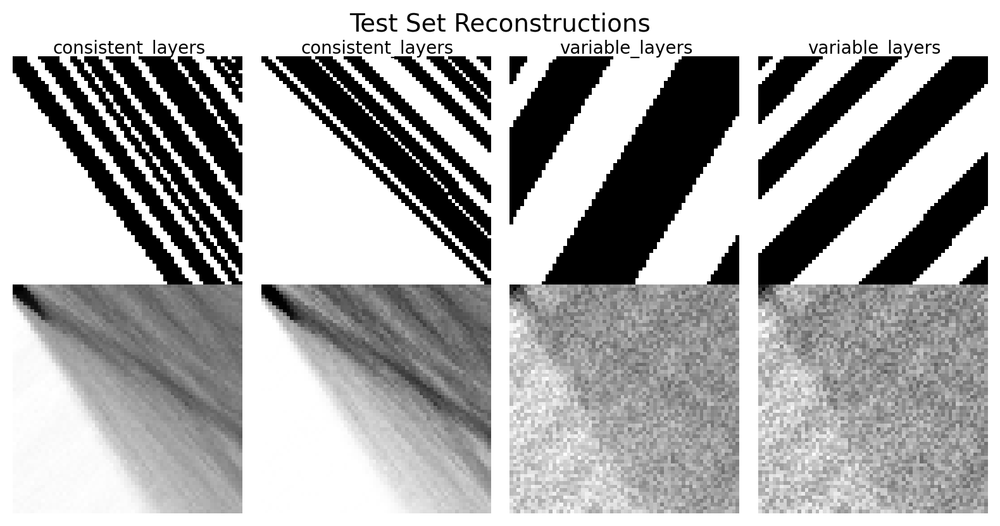


Visualizing latent spaces (train and test):
Train data silhouette score: 0.706558
Test data silhouette score: 0.738075
Similarity to original score: 93.37%


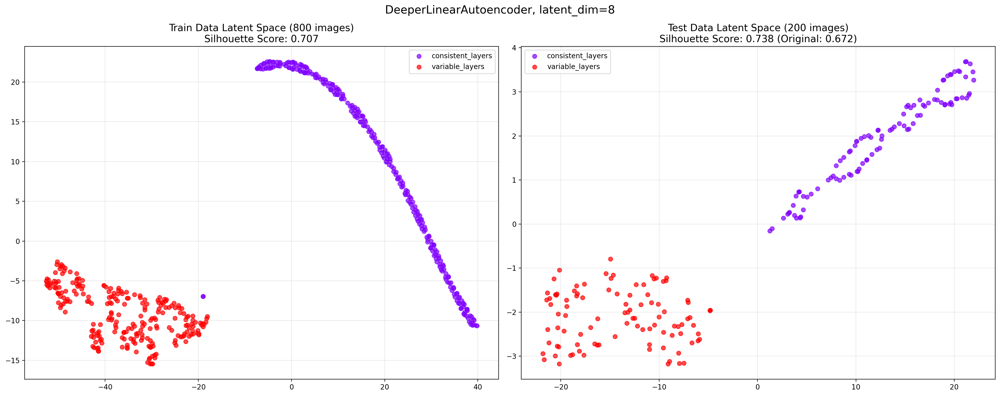


--------------------------------------------------
Evaluating deeper_linear_16d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\deeper_linear_16d_20250507_225424_model.pth
Architecture: deeper_linear, Latent dimension: 16
Model was trained for 2 epochs
Final test loss from training: 0.20772655069828033
Original silhouette score: 0.6888983249664307
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.204881
Final test loss from training history: 0.207727
Final train silhouette score from training history: 0.695788
Final test silhouette score from training history: 0.688898
Recalculated test loss using original evaluation function: 0.200266

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

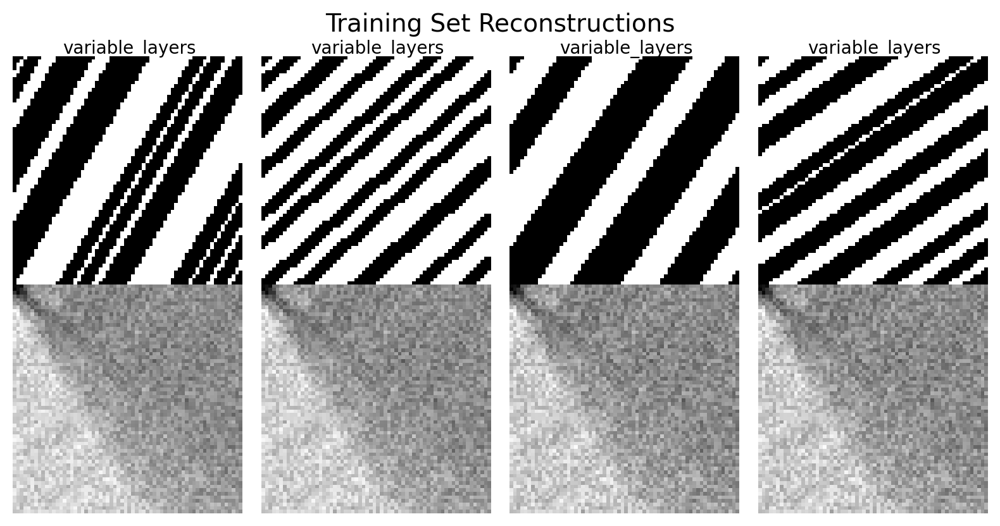

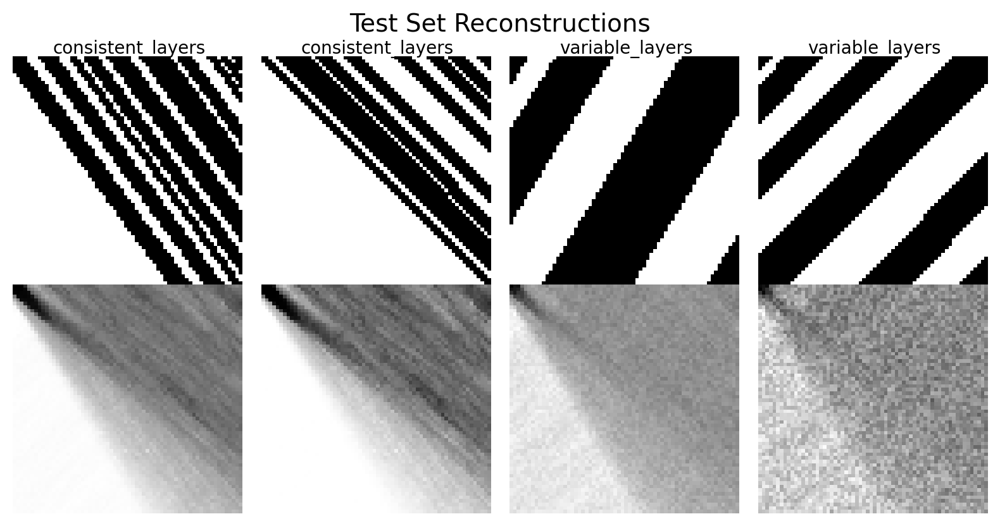


Visualizing latent spaces (train and test):
Train data silhouette score: 0.734640
Test data silhouette score: 0.756431
Similarity to original score: 93.25%


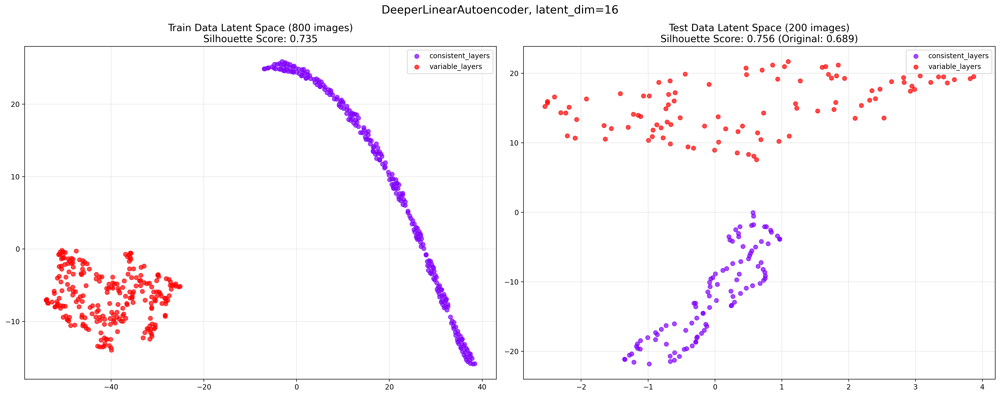


--------------------------------------------------
Evaluating convolutional_8d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\convolutional_8d_20250507_225424_model.pth
Architecture: convolutional, Latent dimension: 8
Model was trained for 2 epochs
Final test loss from training: 0.20710030376911162
Original silhouette score: 0.6757588386535645
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.204859
Final test loss from training history: 0.207100
Final train silhouette score from training history: 0.704379
Final test silhouette score from training history: 0.675759
Recalculated test loss using original evaluation function: 0.199817

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

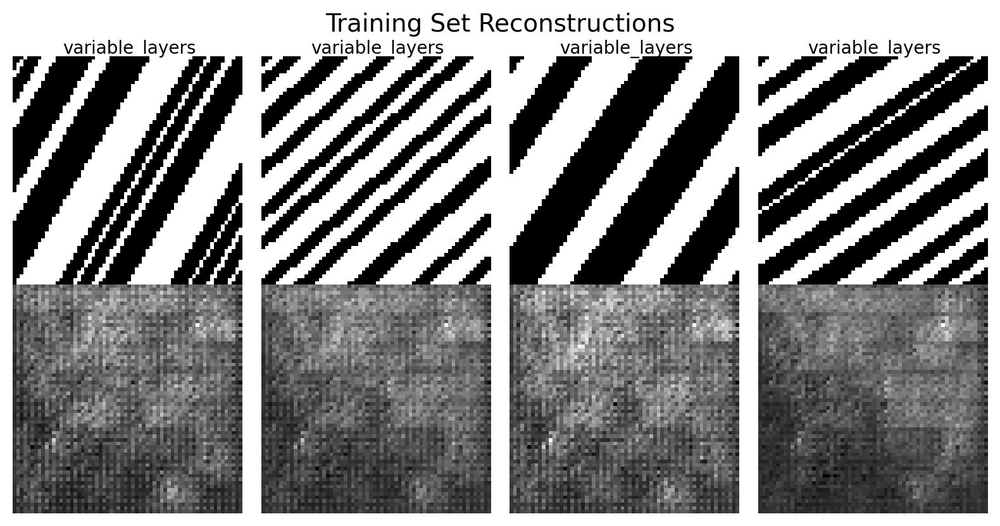

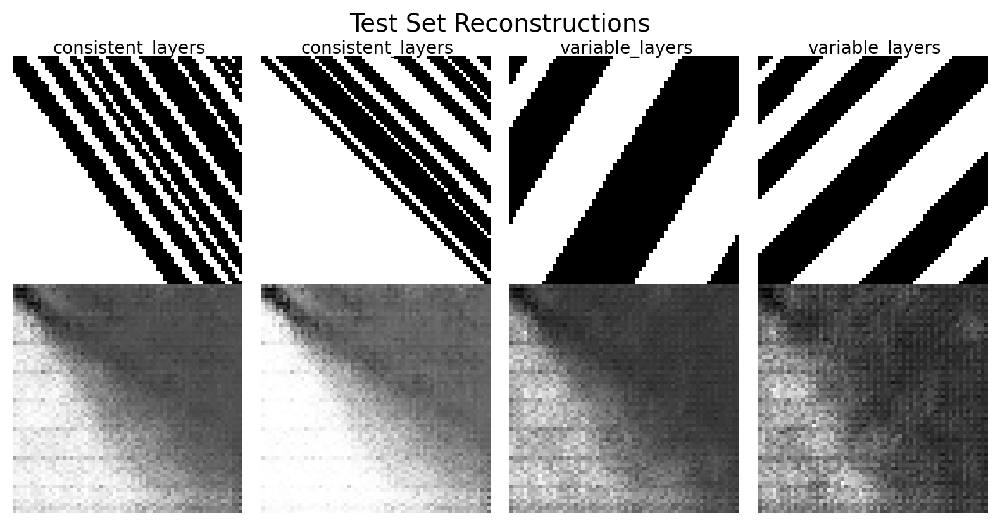


Visualizing latent spaces (train and test):
Train data silhouette score: 0.638314
Test data silhouette score: 0.714559
Similarity to original score: 96.12%


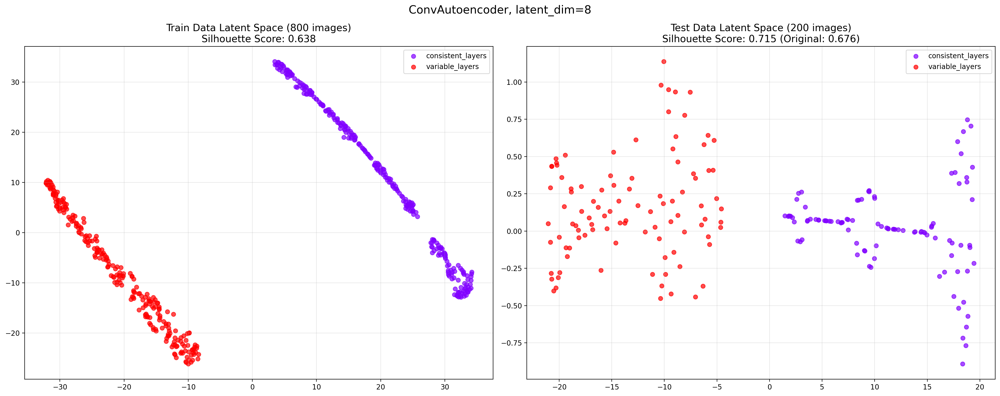


--------------------------------------------------
Evaluating convolutional_16d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\convolutional_16d_20250507_225424_model.pth
Architecture: convolutional, Latent dimension: 16
Model was trained for 2 epochs
Final test loss from training: 0.20697668492794036
Original silhouette score: 0.646809995174408
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.204870
Final test loss from training history: 0.206977
Final train silhouette score from training history: 0.645367
Final test silhouette score from training history: 0.646810
Recalculated test loss using original evaluation function: 0.200783

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

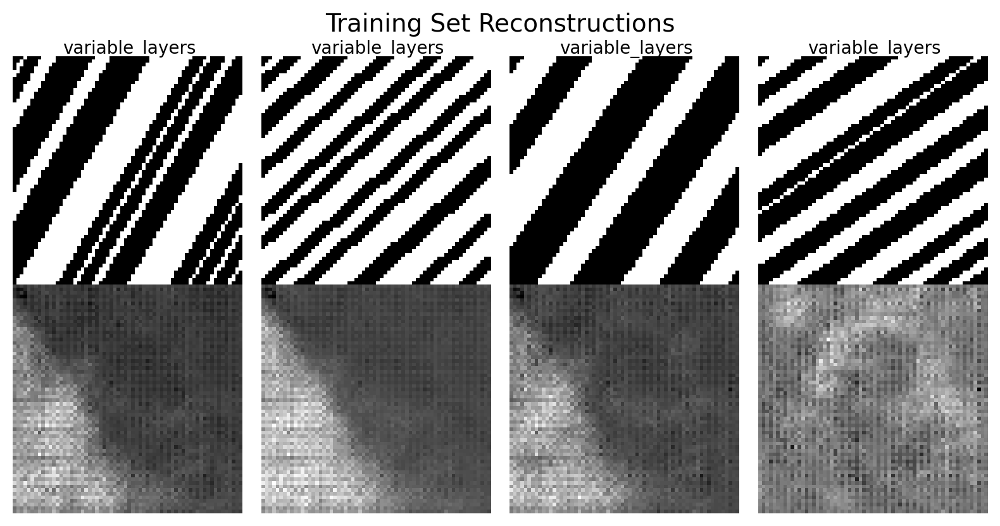

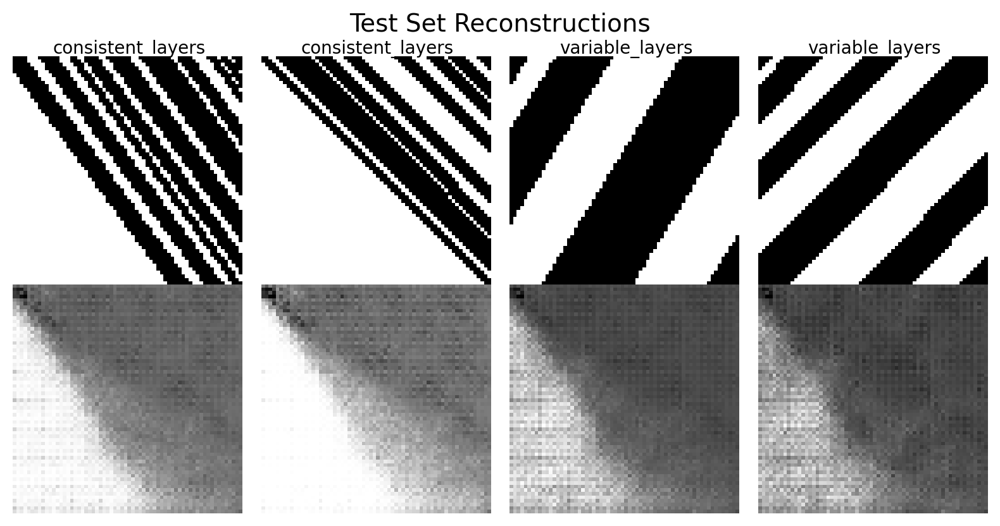


Visualizing latent spaces (train and test):
Train data silhouette score: 0.715372
Test data silhouette score: 0.730956
Similarity to original score: 91.59%


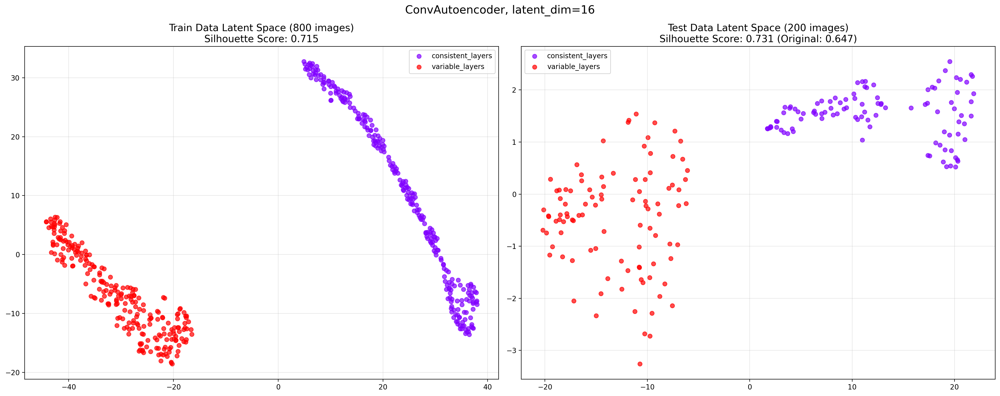


--------------------------------------------------
Evaluating deeper_convolutional_8d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\deeper_convolutional_8d_20250507_225424_model.pth
Architecture: deeper_convolutional, Latent dimension: 8
Model was trained for 2 epochs
Final test loss from training: 0.20149317264556885
Original silhouette score: 0.4959673285484314
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.198391
Final test loss from training history: 0.201493
Final train silhouette score from training history: 0.535300
Final test silhouette score from training history: 0.495967


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

Recalculated test loss using original evaluation function: 0.194972

Showing sample reconstructions for both training and test sets:


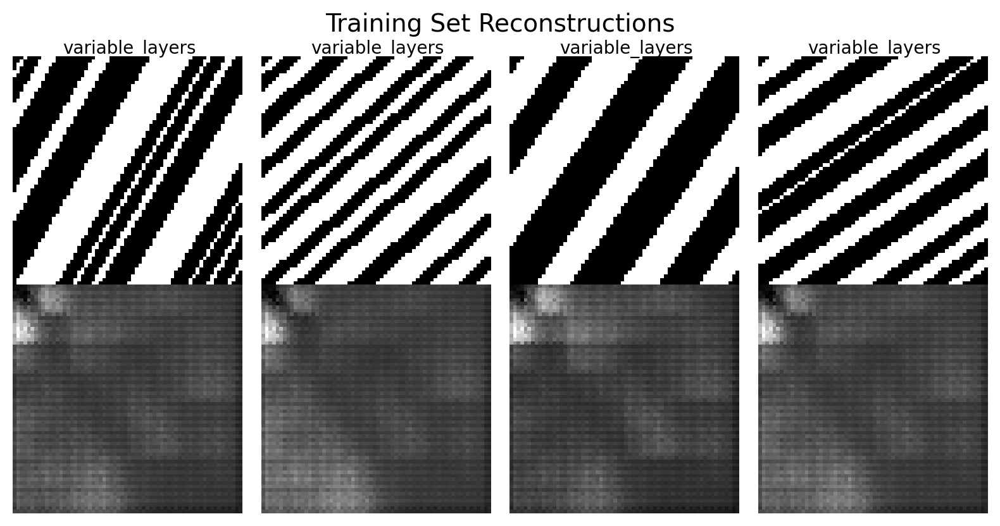

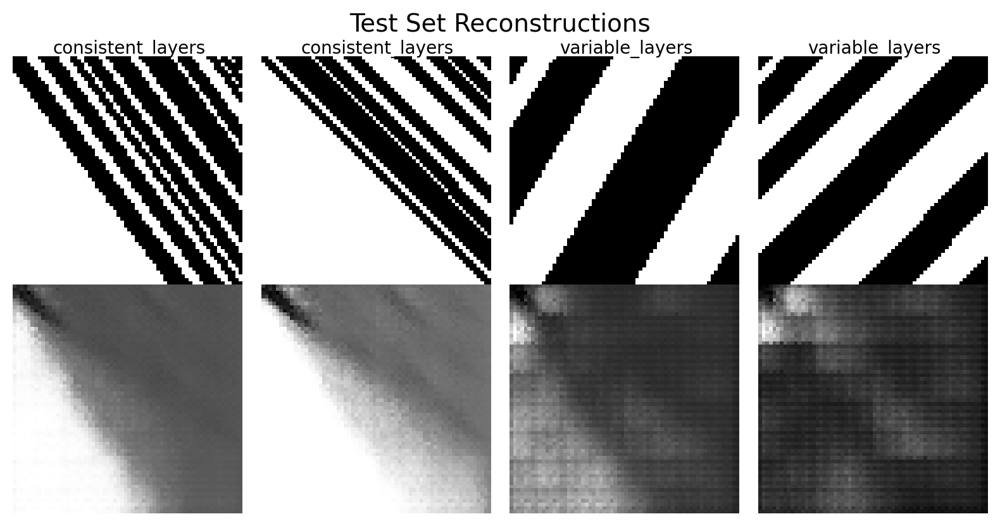


Visualizing latent spaces (train and test):
Train data silhouette score: 0.659732
Test data silhouette score: 0.720188
Similarity to original score: 77.58%


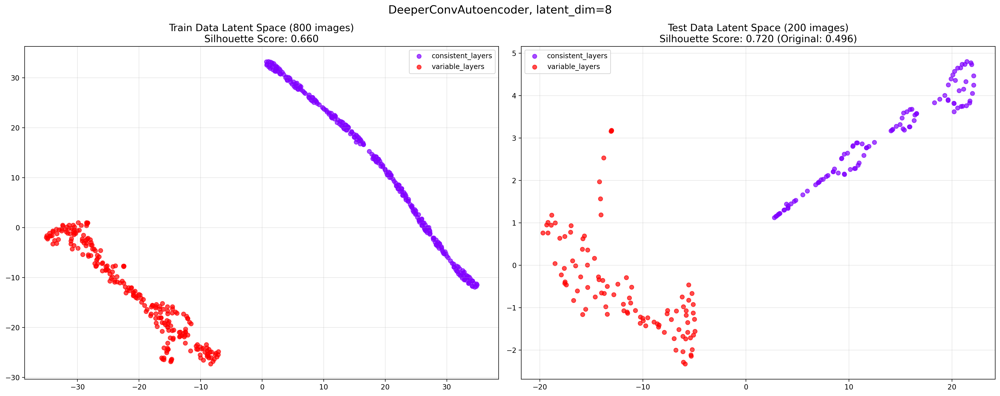


--------------------------------------------------
Evaluating deeper_convolutional_16d_20250507_225424_model.pth
Loading model: latent_dim_exploration_results_layered_geology\deeper_convolutional_16d_20250507_225424_model.pth
Architecture: deeper_convolutional, Latent dimension: 16
Model was trained for 2 epochs
Final test loss from training: 0.19910594463348388
Original silhouette score: 0.6602363586425781
Model loaded successfully

Performing exact evaluation using original training methodology...
Final train loss from training history: 0.198147
Final test loss from training history: 0.199106
Final train silhouette score from training history: 0.671000
Final test silhouette score from training history: 0.660236
Recalculated test loss using original evaluation function: 0.192851

Showing sample reconstructions for both training and test sets:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:574: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=torc

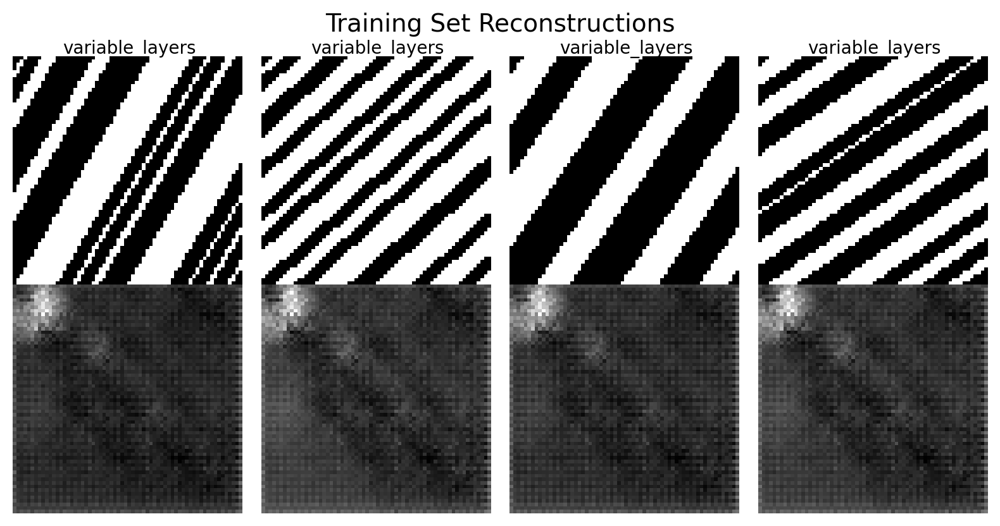

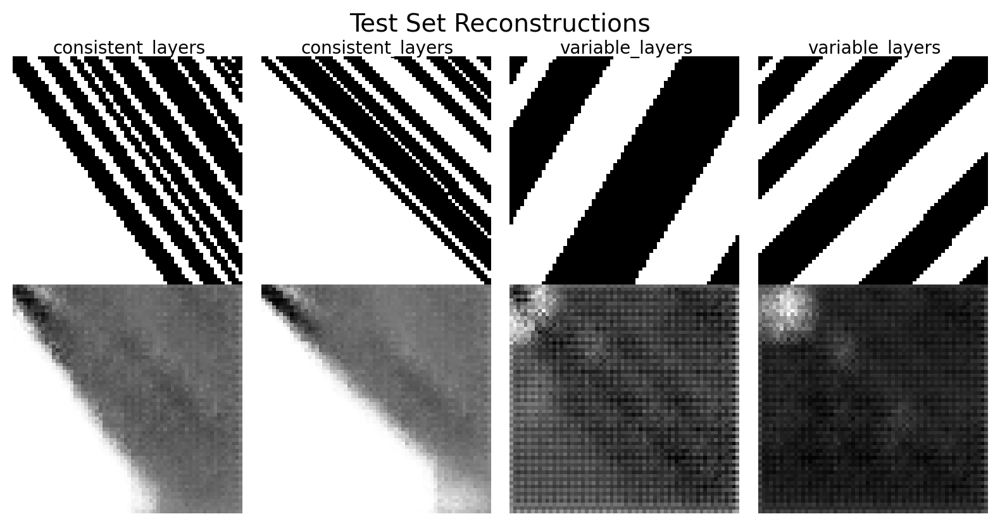


Visualizing latent spaces (train and test):
Train data silhouette score: 0.667098
Test data silhouette score: 0.837307
Similarity to original score: 82.29%


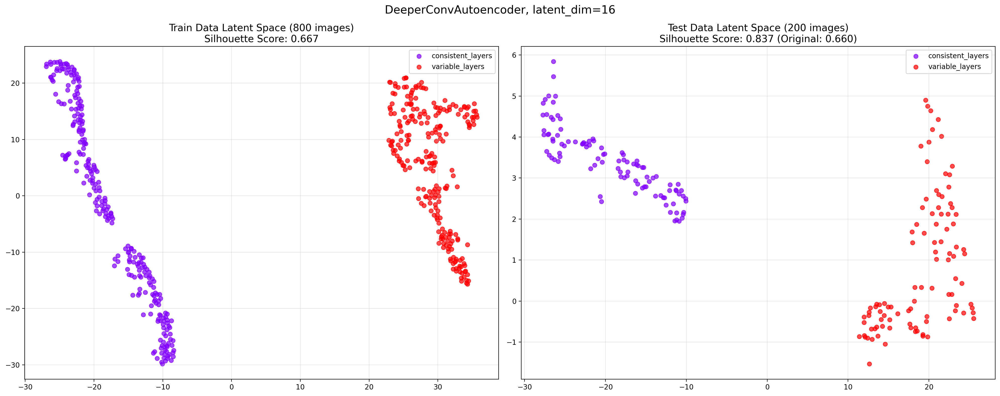


Generating training metrics plots for all models:

Plotting training metrics for simple_linear architecture:


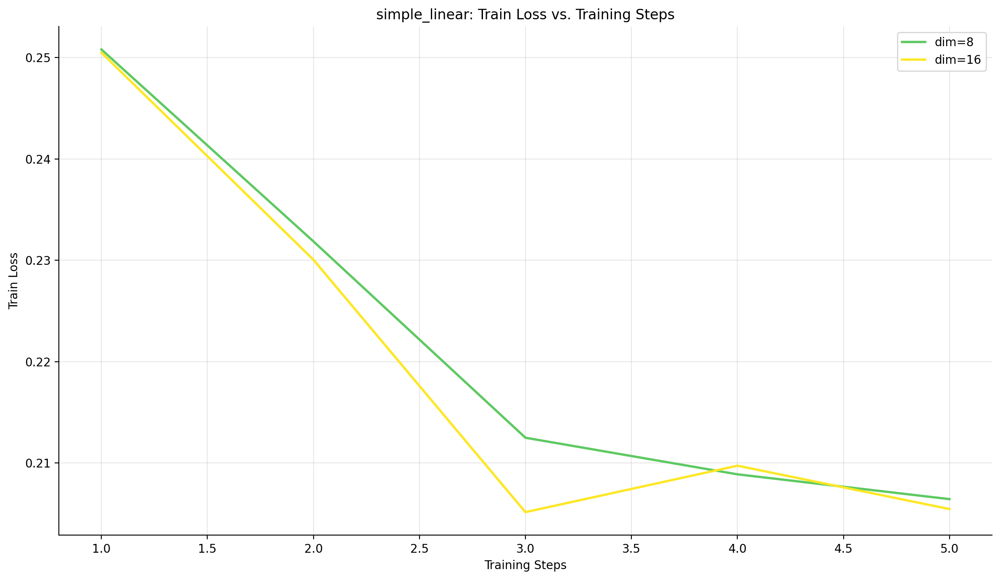

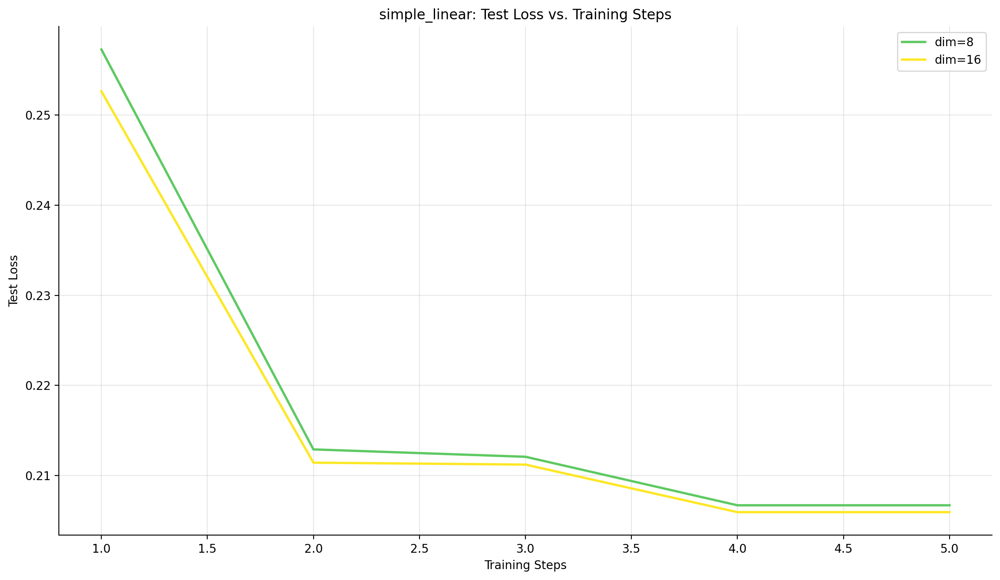


Plotting training metrics for deeper_linear architecture:


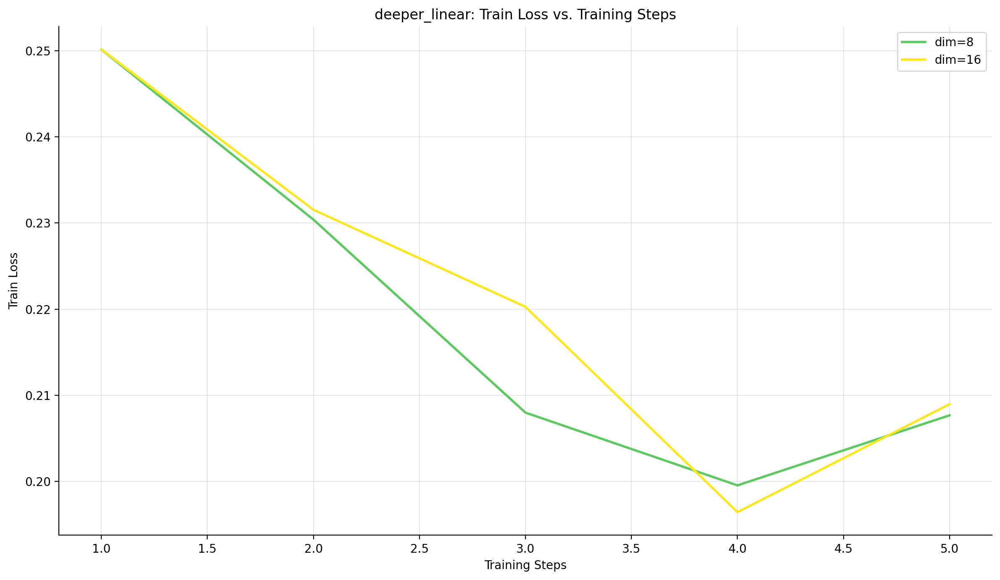

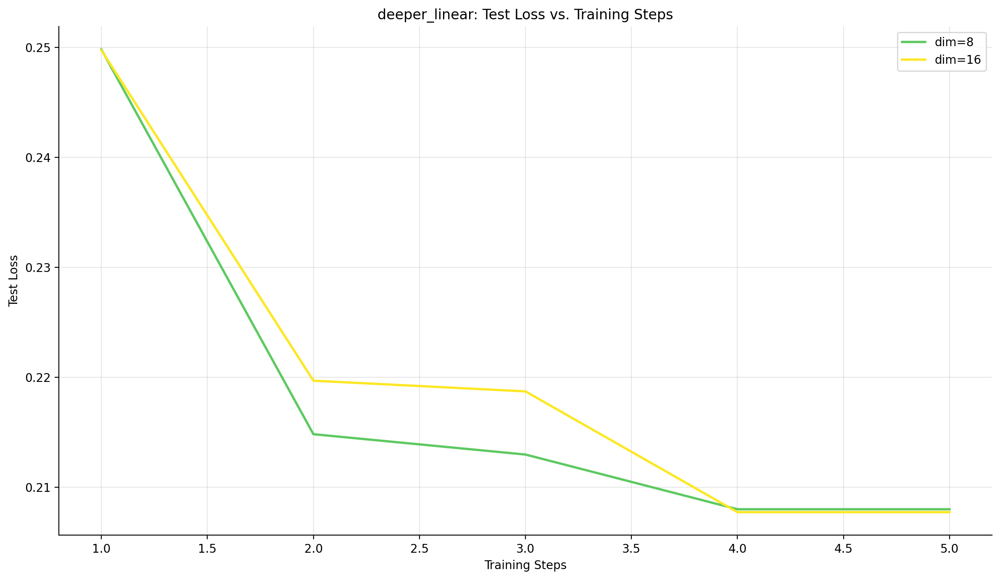


Plotting training metrics for convolutional architecture:


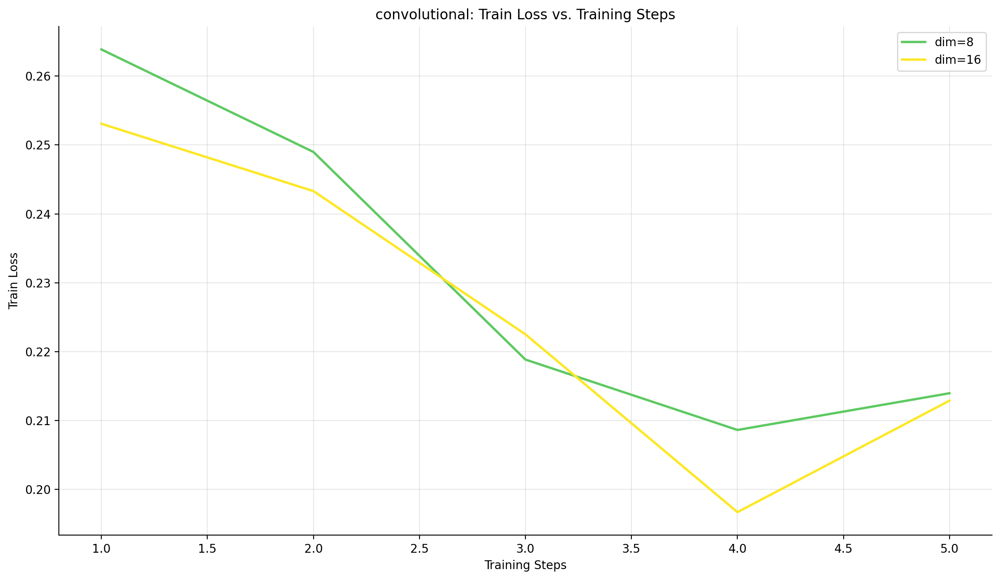

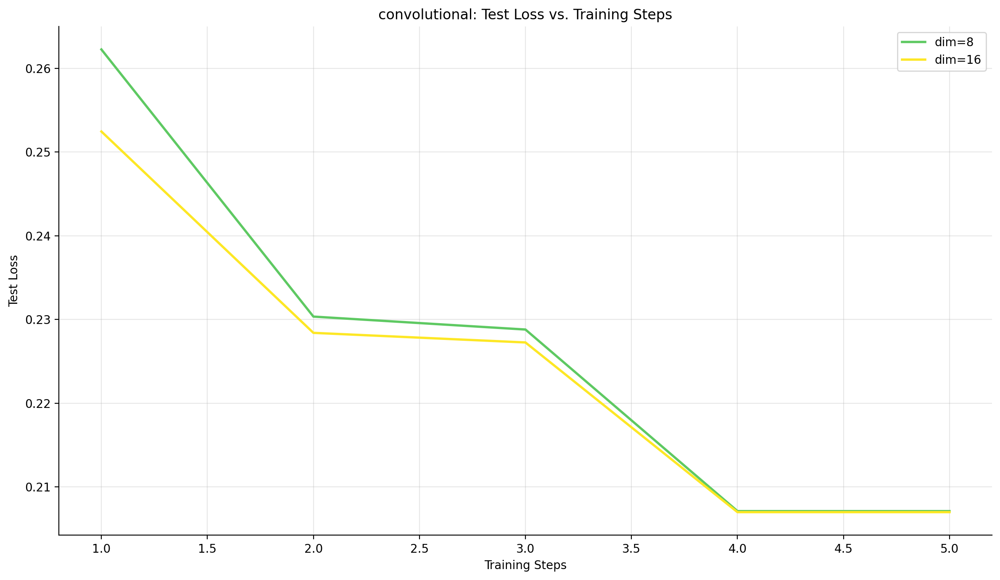


Plotting training metrics for deeper_convolutional architecture:


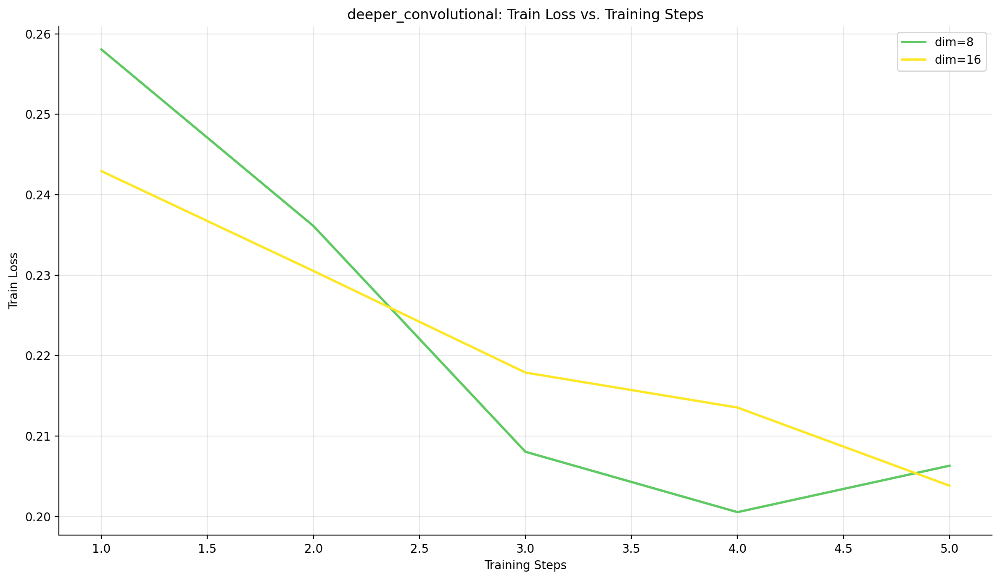

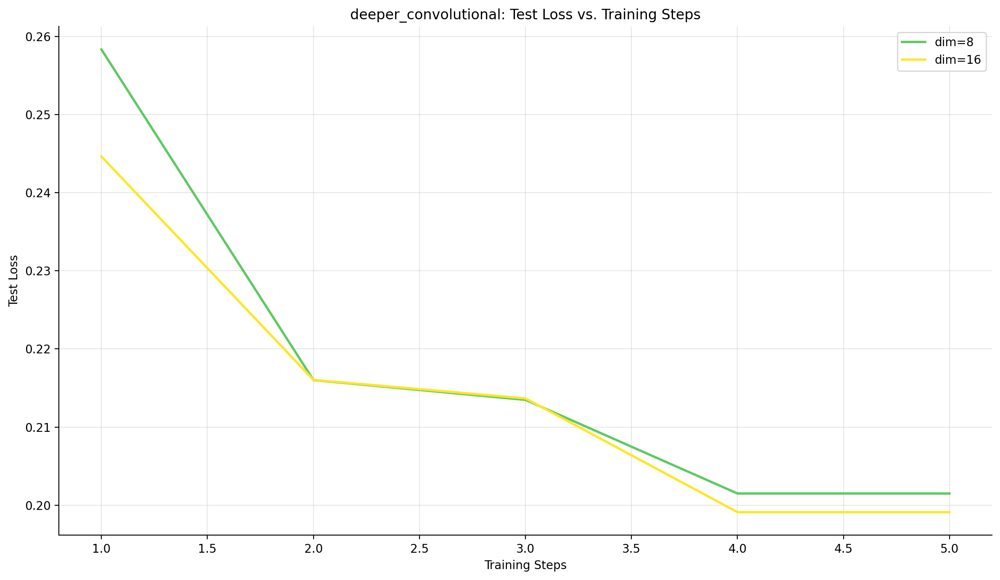



Results Summary:


,Architecture,Latent_Dim,Train_Loss,Reconstruction_Loss,Train_Silhouette,Silhouette_Score,Recalculated_Test_Loss,Recalculated_Test_Silhouette
0,SimpleLinearAutoencoder,8,0.202255,0.206713,0.650736,0.641802,0.199109,0.723245
1,SimpleLinearAutoencoder,16,0.202158,0.205953,0.604347,0.577407,0.198413,0.713801
2,DeeperLinearAutoencoder,8,0.205152,0.207991,0.660821,0.671733,0.200697,0.738075
3,DeeperLinearAutoencoder,16,0.204881,0.207727,0.695788,0.688898,0.200266,0.756431
4,ConvAutoencoder,8,0.204859,0.207100,0.704379,0.675759,0.199817,0.714559
5,ConvAutoencoder,16,0.204870,0.206977,0.645367,0.646810,0.200783,0.730956
6,DeeperConvAutoencoder,8,0.198391,0.201493,0.535300,0.495967,0.194972,0.720188
7,DeeperConvAutoencoder,16,0.198147,0.199106,0.671000,0.660236,0.192851,0.837307


Results saved to latent_dim_exploration_results_layered_geology\model_evaluation_20250507_225424.csv

Generating performance vs. latent dimension plots:


C:\Users\cjh5690.PSU\AppData\Local\Temp\ipykernel_33264\575310328.py:878: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  ax.plot(latent_dims, metric_values, 'o-', label=architecture, linestyle=linestyle, color=colors[i])


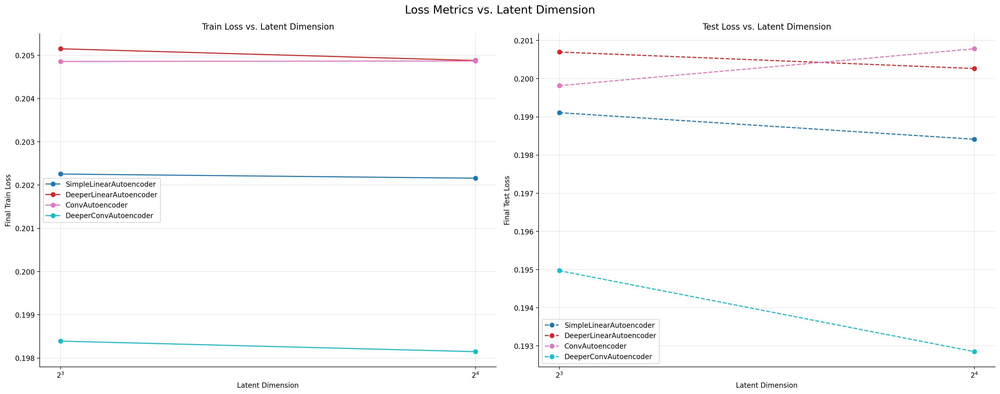

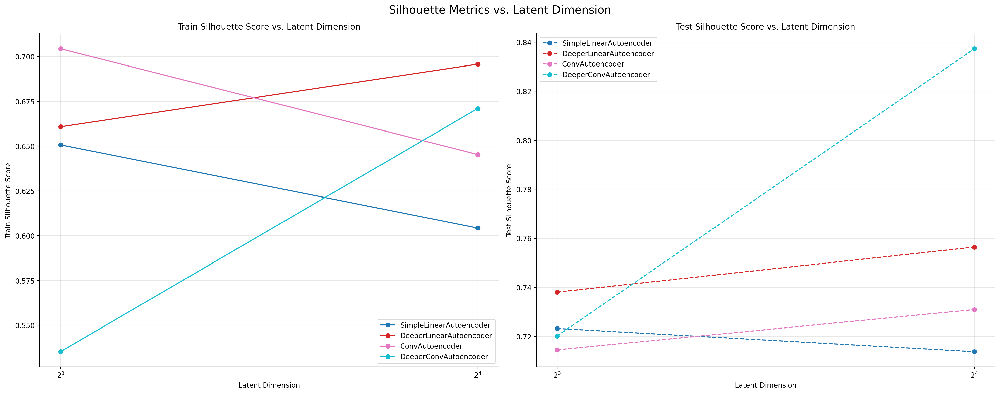

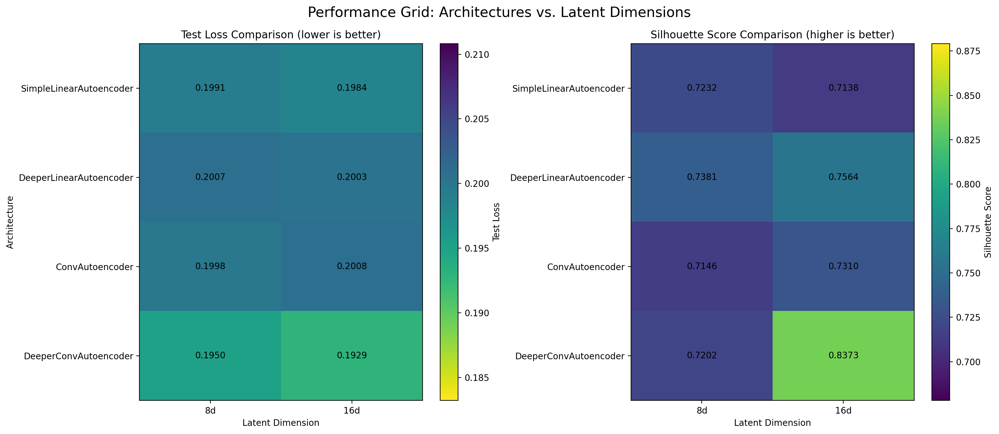

In [3]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
import os
import glob
import re
import time
import json
from PIL import Image
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
import pandas as pd
from IPython.display import display, HTML
from torch.utils.data import Dataset, DataLoader

# Settings
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)  # Larger default figure size
#torch.serialization.add_safe_globals(['numpy.core.multiarray.scalar'])

# Define the timestamp pattern to match (e.g., '001552')
TIMESTAMP_PATTERN = '20250507_225424'  # Change this to match your models

# Define the dataset directory (change this to your dataset location)
DATASET_DIR = 'layered_geologic_patterns_dataset'  # Default dataset directory

# Define the models directory (change this to your models location)
MODELS_DIR = 'latent_dim_exploration_results_layered_geology'  # Default to current directory

# Define the consistent random seed (matching original code)
RANDOM_SEED = 42

# ===============================================
# 1. MODEL DEFINITIONS - Imported from original code
# ===============================================

class SimpleLinearAutoencoder(nn.Module):
    def __init__(self, input_size=64*64, latent_dim=10):
        super(SimpleLinearAutoencoder, self).__init__()
        # Encoder (simple linear layers)
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(input_size, 128),
            nn.ReLU(),
            nn.Linear(128, latent_dim)
        )
        
        # Decoder (simple linear layers)
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.ReLU(),
            nn.Linear(128, input_size),
            nn.Sigmoid(),
            nn.Unflatten(1, (1, 64, 64))  # Reshape back to image dimensions
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


class DeeperLinearAutoencoder(nn.Module):
    def __init__(self, input_size=64*64, latent_dim=10):
        super(DeeperLinearAutoencoder, self).__init__()
        # Encoder with more layers
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(input_size, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, latent_dim)
        )
        
        # Decoder with more layers
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, input_size),
            nn.Sigmoid(),
            nn.Unflatten(1, (1, 64, 64))
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


class ConvAutoencoder(nn.Module):
    def __init__(self, input_channels=1, latent_dim=10):
        super(ConvAutoencoder, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(input_channels, 16, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            # Second convolutional layer
            nn.Conv2d(16, 32, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            # Third convolutional layer
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
        )
        
        # Calculate the size of the flattened features after convolutions
        # For 64x64 input with 3 stride-2 convs: 64 -> 32 -> 16 -> 8
        # So the flattened size is 64 channels * 8 * 8 = 4096
        self.flatten_size = 64 * 8 * 8
        
        # Latent space mapping
        self.fc_encoder = nn.Linear(self.flatten_size, latent_dim)
        self.fc_decoder = nn.Linear(latent_dim, self.flatten_size)
        
        # Decoder
        self.decoder = nn.Sequential(
            # First transpose convolutional layer
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            # Second transpose convolutional layer
            nn.ConvTranspose2d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            # Third transpose convolutional layer
            nn.ConvTranspose2d(16, input_channels, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        # Encode
        x = self.encoder(x)
        
        # Flatten and project to latent space
        x_flattened = x.view(x.size(0), -1)
        encoded = self.fc_encoder(x_flattened)
        
        # Project from latent space and reshape
        x_projected = self.fc_decoder(encoded)
        x_reshaped = x_projected.view(x.size(0), 64, 8, 8)
        
        # Decode
        decoded = self.decoder(x_reshaped)
        
        return encoded, decoded


class DeeperConvAutoencoder(nn.Module):
    """
    An improved convolutional autoencoder with:
    1. An additional conv/deconv layer for deeper feature learning
    2. More channels per layer (32, 64, 128, 256 vs 16, 32, 64)
    3. Mixture of 3x3 and 5x5 kernels to capture different spatial contexts
    """
    def __init__(self, input_channels=1, latent_dim=32):
        super(DeeperConvAutoencoder, self).__init__()
        
        # Encoder with larger filters and more channels
        self.encoder = nn.Sequential(
            # First convolutional layer with larger 5x5 kernel to capture more spatial context
            nn.Conv2d(input_channels, 32, kernel_size=5, stride=2, padding=2),
            nn.ReLU(),
            
            # Second convolutional layer
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            
            # Third convolutional layer
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            
            # Fourth convolutional layer (new)
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
        )
        
        # Calculate the size of the flattened features after convolutions
        # For 64x64 input with 4 stride-2 convs: 64 -> 32 -> 16 -> 8 -> 4
        # So the flattened size is 256 channels * 4 * 4 = 4096
        self.flatten_size = 256 * 4 * 4
        
        # Latent space mapping with an additional non-linearity
        self.fc_encoder = nn.Sequential(
            nn.Linear(self.flatten_size, 512),
            nn.ReLU(),
            nn.Linear(512, latent_dim)
        )
        
        self.fc_decoder = nn.Sequential(
            nn.Linear(latent_dim, 512),
            nn.ReLU(),
            nn.Linear(512, self.flatten_size)
        )
        
        # Decoder with matching architecture
        self.decoder = nn.Sequential(
            # First transpose convolutional layer
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Second transpose convolutional layer
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Third transpose convolutional layer
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            
            # Fourth transpose convolutional layer with larger kernel to match the encoder
            nn.ConvTranspose2d(32, input_channels, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        # Encode
        x = self.encoder(x)
        
        # Flatten and project to latent space
        x_flattened = x.view(x.size(0), -1)
        encoded = self.fc_encoder(x_flattened)
        
        # Project from latent space and reshape
        x_projected = self.fc_decoder(encoded)
        x_reshaped = x_projected.view(x.size(0), 256, 4, 4)
        
        # Decode
        decoded = self.decoder(x_reshaped)
        
        return encoded, decoded


# Dictionary mapping architecture names to model classes
MODEL_ARCHITECTURES = {
    'simple_linear': SimpleLinearAutoencoder,
    'deeper_linear': DeeperLinearAutoencoder,
    'convolutional': ConvAutoencoder,
    'deeper_convolutional': DeeperConvAutoencoder
}

# ===============================================
# 2. ORIGINAL EVALUATION FUNCTIONS FROM TRAINING CODE
# ===============================================

class ShapeDataset(Dataset):
    def __init__(self, dataset_info):
        """
        Initialize the dataset.
        
        Args:
            dataset_info: Either a path to the dataset directory or a dictionary
                         containing 'filenames' and 'labels'
        """
        # Check if dataset_info is a string (directory path) or a dictionary
        if isinstance(dataset_info, dict):
            # It's already a dictionary with filenames and labels
            self.filenames = dataset_info['filenames']
            self.labels = dataset_info['labels']
            self.from_directory = False
        else:
            # It's a directory path - load from there
            self.dataset_dir = dataset_info
            self.classes = self._get_classes()
            self.filenames = []
            self.labels = []
            self._load_from_directory()
            self.from_directory = True
    
    def _get_classes(self):
        """Get class folders in the dataset directory"""
        class_dirs = [d for d in os.listdir(self.dataset_dir) 
                if os.path.isdir(os.path.join(self.dataset_dir, d))]
        print(f"Found classes: {class_dirs}")
        return class_dirs
    
    def _load_from_directory(self):
        """Load all images from the directory structure"""
        for i, class_name in enumerate(self.classes):
            class_dir = os.path.join(self.dataset_dir, class_name)
            class_files = glob.glob(os.path.join(class_dir, '*.png'))
            
            for file in class_files:
                self.filenames.append(file)
                self.labels.append(i)
    
    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        img_path = self.filenames[idx]
        img = Image.open(img_path).convert('L')  # Convert to grayscale
        label = self.labels[idx]
        
        # Transform to tensor and normalize
        img = np.array(img)
        img = img / 255.0  # Normalize to [0, 1]
        img = torch.tensor(img).float().unsqueeze(0)  # Add channel dimension [1, H, W]
        
        return img, img, label  # Return (input, target, label)

def memory_efficient_evaluation(model, test_data, loss_func, batch_size=64, device='cpu'):
    """
    Evaluate model on test data in a memory-efficient way - 
    This is exactly the same function used during training
    """
    model.eval()
    n_samples = test_data.size(0)
    total_loss = 0.0
    
    with torch.no_grad():
        for i in range(0, n_samples, batch_size):
            batch = test_data[i:i+batch_size].to(device)
            encoded, decoded = model(batch)
            loss = loss_func(decoded, batch)
            total_loss += loss.item() * batch.size(0)
    
    avg_loss = total_loss / n_samples
    return avg_loss, None, None  # Return placeholders for compatibility

# ===============================================
# 3. HELPER FUNCTIONS
# ===============================================

def extract_timestamp_from_filename(filename):
    """Extract timestamp from filename for sorting models by creation date"""
    # Look for pattern like YYYYMMDD_HHMMSS in the filename
    timestamp_match = re.search(r'(\d{8}_\d{6})', os.path.basename(filename))
    if timestamp_match:
        return timestamp_match.group(1)
    return ""  # Return empty string if no timestamp found

def create_fallback_split(dataset_info, test_ratio=0.2):
    """Create a fallback train/test split if the original split file isn't available"""
    print("Creating fallback train/test split")
    
    # Set random seed for reproducibility - use EXACT same seed as training code
    np.random.seed(RANDOM_SEED)
    
    total_samples = len(dataset_info['filenames'])
    indices = np.random.permutation(total_samples)
    split_idx = int(total_samples * (1 - test_ratio))
    
    train_indices = indices[:split_idx].tolist()
    test_indices = indices[split_idx:].tolist()
    
    return {
        'train_indices': train_indices,
        'test_indices': test_indices,
        'seed': RANDOM_SEED,
        'test_ratio': test_ratio,
        'created_at': time.strftime("%Y-%m-%d %H:%M:%S")
    }

def load_exact_dataset(dataset_path, split_path):
    """
    Load the dataset using exact same split as the original training code
    
    Args:
        dataset_path: Path to the dataset info file (numpy file)
        split_path: Path to the data split file (npy)
    
    Returns:
        Dictionary with dataset information
    """
    print(f"Loading dataset from {dataset_path}")
    
    # Set random seed for reproducibility - use EXACT same seed as training code
    np.random.seed(RANDOM_SEED)
    torch.manual_seed(RANDOM_SEED)
    
    # Check if dataset info exists
    if not os.path.exists(dataset_path):
        print(f"Dataset info file not found at {dataset_path}")
        return None
    
    # Load dataset info
    try:
        dataset_info = np.load(dataset_path, allow_pickle=True).item()
        print(f"Loaded dataset info with {len(dataset_info['filenames'])} samples")
    except Exception as e:
        print(f"Error loading dataset info: {e}")
        return None
    
    # Ensure we're using the .npy extension for split file
    split_path = split_path.replace('.json', '.npy')
    print(f"Will attempt to load split from: {split_path}")
    
    # Load split info if it exists
    if os.path.exists(split_path):
        try:
            # Load split_info from NPY file
            split_info = np.load(split_path, allow_pickle=True).item()
            print(f"Loaded existing data split from {split_path}")
            print(f"Split info contains {len(split_info['train_indices'])} train and {len(split_info['test_indices'])} test samples")
        except Exception as e:
            print(f"Error loading split info: {e}")
            # Create a fallback split
            split_info = create_fallback_split(dataset_info)
    else:
        print(f"Split file not found at {split_path}, creating fallback split")
        split_info = create_fallback_split(dataset_info)
    
    # Get class names
    class_names = dataset_info.get('label_names', [f"Class {i}" for i in range(len(np.unique(dataset_info['labels'])))])
    print(f"Found {len(class_names)} classes: {class_names}")
    
    # Get train and test data
    train_indices = split_info['train_indices']
    test_indices = split_info['test_indices']
    
    # Prepare train data
    train_filenames = [dataset_info['filenames'][i] for i in train_indices]
    train_labels = [dataset_info['labels'][i] for i in train_indices]
    
    # Prepare test data
    test_filenames = [dataset_info['filenames'][i] for i in test_indices]
    test_labels = [dataset_info['labels'][i] for i in test_indices]
    
    # Load train images
    train_data = []
    train_label_tensors = []
    
    for filename, label in zip(train_filenames, train_labels):
        try:
            img = Image.open(filename).convert('L')  # Convert to grayscale
            img_array = np.array(img) / 255.0  # Normalize to [0, 1]
            img_tensor = torch.tensor(img_array).float().unsqueeze(0)  # Add channel dimension
            
            train_data.append(img_tensor)
            train_label_tensors.append(label)
        except Exception as e:
            print(f"Error loading train image {filename}: {e}")
    
    # Load test images
    test_data = []
    test_label_tensors = []
    
    for filename, label in zip(test_filenames, test_labels):
        try:
            img = Image.open(filename).convert('L')  # Convert to grayscale
            img_array = np.array(img) / 255.0  # Normalize to [0, 1]
            img_tensor = torch.tensor(img_array).float().unsqueeze(0)  # Add channel dimension
            
            test_data.append(img_tensor)
            test_label_tensors.append(label)
        except Exception as e:
            print(f"Error loading test image {filename}: {e}")
    
    if not test_data:
        print("No test data could be loaded")
        return None
    
    # Stack data into tensors
    if train_data:
        train_data_tensor = torch.stack(train_data)
        train_labels_tensor = torch.tensor(train_label_tensors)
        print(f"Loaded {len(train_data_tensor)} train images")
    else:
        print("No train data could be loaded")
        return None
    
    test_data_tensor = torch.stack(test_data)
    test_labels_tensor = torch.tensor(test_label_tensors)
    print(f"Loaded {len(test_data_tensor)} test images")
    
    # Create DataLoaders for batch evaluation
    train_info_dict = {
        'filenames': train_filenames,
        'labels': train_labels
    }
    train_dataset = ShapeDataset(train_info_dict)
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=False)
    
    test_info_dict = {
        'filenames': test_filenames,
        'labels': test_labels
    }
    test_dataset = ShapeDataset(test_info_dict)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)
    
    # Select visualization samples
    # Try to use samples from each class
    visualization_data = []
    visualization_labels = []
    
    # Group test indices by class
    class_samples = {}
    for i, label in enumerate(test_labels):
        if label not in class_samples:
            class_samples[label] = []
        class_samples[label].append(i)
    
    # Select 2 samples from each class for visualization
    samples_per_class = 2
    visualization_indices = []
    
    for label in sorted(class_samples.keys()):
        indices = class_samples[label]
        # Take first few samples (deterministic)
        selected = indices[:min(samples_per_class, len(indices))]
        visualization_indices.extend(selected)
    
    # Create visualization tensors
    for idx in visualization_indices:
        visualization_data.append(test_data[idx])
        visualization_labels.append(test_label_tensors[idx])
    
    visualization_data_tensor = torch.stack(visualization_data)
    visualization_labels_tensor = torch.tensor(visualization_labels)
    
    print(f"Selected {len(visualization_data_tensor)} samples for visualization")
    
    return {
        'samples': visualization_data_tensor,
        'sample_labels': visualization_labels_tensor,
        'train_data': train_data_tensor,
        'train_labels': train_labels_tensor,
        'test_data': test_data_tensor,
        'test_labels': test_labels_tensor,
        'train_loader': train_loader,
        'test_loader': test_loader,
        'class_names': class_names,
        'visualization_indices': visualization_indices,
        'dataset_info': dataset_info,
        'split_info': split_info
    }

def load_model(model_path):
    """Load a saved model and extract history directly from checkpoint"""
    print(f"Loading model: {model_path}")
    
    # Get architecture and latent dim from filename
    filename = os.path.basename(model_path)
    
    # Identify architecture from filename
    if 'simple_linear' in filename:
        architecture = 'simple_linear'
    elif 'deeper_linear' in filename:
        architecture = 'deeper_linear'
    elif 'deeper_convolutional' in filename:
        architecture = 'deeper_convolutional'
    elif 'convolutional' in filename:
        architecture = 'convolutional'
    else:
        print(f"Cannot determine architecture from filename: {filename}")
        return None, None, None
    
    # Extract latent dimension from filename (e.g., "32d")
    latent_match = re.search(r'(\d+)d', filename)
    if latent_match:
        latent_dim = int(latent_match.group(1))
    else:
        print("Cannot determine latent dimension from filename")
        return None, None, None
    
    print(f"Architecture: {architecture}, Latent dimension: {latent_dim}")
    
    # Create model instance
    if architecture in MODEL_ARCHITECTURES:
        # Initialize with appropriate parameters based on architecture
        if 'convolutional' in architecture:
            model = MODEL_ARCHITECTURES[architecture](input_channels=1, latent_dim=latent_dim)
        else:
            model = MODEL_ARCHITECTURES[architecture](input_size=64*64, latent_dim=latent_dim)
        
        # Load the saved weights
        try:
            checkpoint = torch.load(model_path, map_location=torch.device('cpu'))
            model.load_state_dict(checkpoint['model_state_dict'])
            model.eval()  # Set to evaluation mode
            
            # Extract history information directly from the checkpoint
            history = checkpoint.get('history', {})
            
            # If we have history, print some info about the model's training
            if history:
                print(f"Model was trained for {history.get('epochs', 'unknown')} epochs")
                print(f"Final test loss from training: {history.get('final_test_loss', 'unknown')}")
                print(f"Original silhouette score: {history.get('final_silhouette', 'unknown')}")
            
            print("Model loaded successfully")
            return model, history, (architecture, latent_dim)
        except Exception as e:
            print(f"Error loading model: {e}")
            return None, None, None
    else:
        print(f"Architecture {architecture} not found in MODEL_ARCHITECTURES")
        return None, None, None

# def visualize_reconstructions(model, images, labels=None, class_names=None):
#     """Visualize original and reconstructed images"""
#     with torch.no_grad():
#         # Get reconstructions
#         _, reconstructions = model(images)
        
#         # Plot
#         fig, axes = plt.subplots(2, len(images), figsize=(len(images)*2, 4))
        
#         # Original images on top row
#         for i in range(len(images)):
#             axes[0, i].imshow(images[i, 0].numpy(), cmap='gray')
#             axes[0, i].axis('off')
            
#             # Add class label if available
#             if labels is not None and class_names is not None:
#                 class_idx = labels[i].item()
#                 if class_idx < len(class_names):
#                     axes[0, i].set_title(class_names[class_idx])
        
#         # Add row labels
#         axes[0, 0].set_ylabel('Original', fontsize=12)
        
#         # Reconstructed images on bottom row
#         for i in range(len(images)):
#             axes[1, i].imshow(reconstructions[i, 0].numpy(), cmap='gray')
#             axes[1, i].axis('off')
        
#         axes[1, 0].set_ylabel('Reconstructed', fontsize=12)
        
#         plt.tight_layout()
#         plt.show()
def visualize_reconstructions_both_sets(model, train_images, train_labels, test_images, test_labels, class_names=None, num_samples=4):
    """Visualize original and reconstructed images for both training and test sets"""
    with torch.no_grad():
        # Limit the number of samples to display
        train_images = train_images[:num_samples]
        train_labels = train_labels[:num_samples]
        test_images = test_images[:num_samples]
        test_labels = test_labels[:num_samples]
        
        # Get reconstructions for training set
        _, train_reconstructions = model(train_images)
        
        # Get reconstructions for test set
        _, test_reconstructions = model(test_images)
        
        # Plot training set reconstructions
        fig_train, axes_train = plt.subplots(2, len(train_images), figsize=(len(train_images)*2, 4.5))
        
        # Original training images on top row
        for i in range(len(train_images)):
            axes_train[0, i].imshow(train_images[i, 0].numpy(), cmap='gray')
            axes_train[0, i].axis('off')
            
            # Add class label if available
            if train_labels is not None and class_names is not None:
                class_idx = train_labels[i].item()
                if class_idx < len(class_names):
                    # Add class name as text instead of title to avoid overlap
                    axes_train[0, i].text(32, -5, class_names[class_idx], 
                                          ha='center', va='top', fontsize=10)
        
        # Add row labels
        axes_train[0, 0].set_ylabel('Original', fontsize=12)
        
        # Reconstructed training images on bottom row
        for i in range(len(train_images)):
            axes_train[1, i].imshow(train_reconstructions[i, 0].numpy(), cmap='gray')
            axes_train[1, i].axis('off')
        
        axes_train[1, 0].set_ylabel('Reconstructed', fontsize=12)
        
        # Add suptitle with proper padding
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)  # Increase space at the top
        fig_train.suptitle("Training Set Reconstructions", fontsize=14, y=0.92)
        plt.show()
        
        # Plot test set reconstructions
        fig_test, axes_test = plt.subplots(2, len(test_images), figsize=(len(test_images)*2, 4.5))
        
        # Original test images on top row
        for i in range(len(test_images)):
            axes_test[0, i].imshow(test_images[i, 0].numpy(), cmap='gray')
            axes_test[0, i].axis('off')
            
            # Add class label if available
            if test_labels is not None and class_names is not None:
                class_idx = test_labels[i].item()
                if class_idx < len(class_names):
                    # Add class name as text instead of title to avoid overlap
                    axes_test[0, i].text(32, -5, class_names[class_idx], 
                                         ha='center', va='top', fontsize=10)
        
        # Add row labels
        axes_test[0, 0].set_ylabel('Original', fontsize=12)
        
        # Reconstructed test images on bottom row
        for i in range(len(test_images)):
            axes_test[1, i].imshow(test_reconstructions[i, 0].numpy(), cmap='gray')
            axes_test[1, i].axis('off')
        
        axes_test[1, 0].set_ylabel('Reconstructed', fontsize=12)
        
        # Add suptitle with proper padding
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)  # Increase space at the top
        fig_test.suptitle("Test Set Reconstructions", fontsize=14, y=0.92)
        plt.show()
        
# Function to visualize train and test latent spaces side by side
def visualize_side_by_side_latent_spaces(model, train_data, train_labels, test_data, test_labels, 
                                         class_names=None, title_suffix="", orig_silhouette=None):
    """
    Compute and visualize t-SNE projections of train and test data side by side
    
    Args:
        model: Loaded model
        train_data: Training data tensor
        train_labels: Training labels tensor
        test_data: Test data tensor
        test_labels: Test labels tensor
        class_names: List of class names for visualization
        title_suffix: Additional text for plot title
        orig_silhouette: Original silhouette score from training
        
    Returns:
        train_silhouette, test_silhouette: Computed silhouette scores
    """
    with torch.no_grad():
        # Process train data
        encoded_train, _ = model(train_data)
        encoded_train = encoded_train.view(encoded_train.size(0), -1).detach().cpu().numpy()
        train_labels_np = train_labels.numpy()
        
        # Process test data
        encoded_test, _ = model(test_data)
        encoded_test = encoded_test.view(encoded_test.size(0), -1).detach().cpu().numpy()
        test_labels_np = test_labels.numpy()
        
        # Restrict to max 500 samples for each as in training code
        train_plot_only = min(500,encoded_train.shape[0])
        test_plot_only = min(500,encoded_test.shape[0])
        
        # Apply t-SNE with EXACT same parameters as in training code
        # Train data t-SNE
        train_tsne = TSNE(perplexity=min(30, len(encoded_train)-1), n_components=2, 
                          init='pca', max_iter=5000, random_state=42)
        train_low_dim_embs = train_tsne.fit_transform(encoded_train[:train_plot_only])
        train_plot_labels = train_labels_np[:train_plot_only]
        
        # Test data t-SNE
        test_tsne = TSNE(perplexity=min(30, len(encoded_test)-1), n_components=2, 
                         init='pca', max_iter=5000, random_state=42)
        test_low_dim_embs = test_tsne.fit_transform(encoded_test[:test_plot_only])
        test_plot_labels = test_labels_np[:test_plot_only]
        
        # Calculate silhouette scores exactly as in training code
        train_silhouette = None
        if len(np.unique(train_plot_labels)) > 1:
            try:
                train_silhouette = silhouette_score(train_low_dim_embs, train_plot_labels)
                print(f"Train data silhouette score: {train_silhouette:.6f}")
            except Exception as e:
                print(f"Could not calculate train silhouette score: {e}")
        
        test_silhouette = None
        if len(np.unique(test_plot_labels)) > 1:
            try:
                test_silhouette = silhouette_score(test_low_dim_embs, test_plot_labels)
                print(f"Test data silhouette score: {test_silhouette:.6f}")
                
                # Check if it matches original silhouette
                if orig_silhouette is not None:
                    similarity = 100 - abs(test_silhouette - orig_silhouette) * 100
                    print(f"Similarity to original score: {similarity:.2f}%")
            except Exception as e:
                print(f"Could not calculate test silhouette score: {e}")
        
        # Create side-by-side plots
        fig, axes = plt.subplots(1, 2, figsize=(20, 8))
        
        # Plot train data
        unique_train_labels = np.unique(train_plot_labels)
        train_colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_train_labels)))
        
        for i, label in enumerate(unique_train_labels):
            mask = train_plot_labels == label
            axes[0].scatter(
                train_low_dim_embs[mask, 0], 
                train_low_dim_embs[mask, 1],
                c=[train_colors[i]],
                label=class_names[label] if class_names is not None else f"Class {label}",
                alpha=0.7
            )
        
        train_title = f"Train Data Latent Space ({len(train_data)} images)"
        if train_silhouette is not None:
            train_title += f"\nSilhouette Score: {train_silhouette:.3f}"
        axes[0].set_title(train_title, fontsize=14)
        axes[0].legend()
        axes[0].grid(alpha=0.3)
        
        # Plot test data
        unique_test_labels =np.unique(test_plot_labels)
        test_colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_test_labels)))
        
        for i, label in enumerate(unique_test_labels):
            mask = test_plot_labels == label
            axes[1].scatter(
                test_low_dim_embs[mask, 0], 
                test_low_dim_embs[mask, 1],
                c=[test_colors[i]],
                label=class_names[label] if class_names is not None else f"Class {label}",
                alpha=0.7
            )
        
        test_title = f"Test Data Latent Space ({len(test_data)} images)"
        if test_silhouette is not None:
            test_title += f"\nSilhouette Score: {test_silhouette:.3f}"
        if orig_silhouette is not None:
            test_title += f" (Original: {orig_silhouette:.3f})"
        axes[1].set_title(test_title, fontsize=14)
        axes[1].legend()
        axes[1].grid(alpha=0.3)
        
        # Add overall title
        if title_suffix:
            fig.suptitle(title_suffix, fontsize=16)
        
        plt.tight_layout()
        plt.show()
        
        return train_silhouette, test_silhouette

# ===============================================
# 4. EXACT EVALUATION FUNCTIONS
# ===============================================

def plot_metric_on_axis(results_df, metric_name, title, xlabel='Latent Dimension', ylabel=None, is_train=False, ax=None):
    """
    Create a plot showing a specific metric vs. latent dimension for all architectures on a given axis.
    
    Args:
        results_df: DataFrame with results
        metric_name: Column name in the DataFrame for the metric to plot
        title: Title for the plot
        xlabel: X-axis label
        ylabel: Y-axis label (if None, uses metric_name)
        is_train: Whether this is a training metric (affects styling)
        ax: The matplotlib axis to plot on
    """
    if results_df is None or len(results_df) == 0 or metric_name not in results_df.columns:
        print(f"No data available for {metric_name}")
        return
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 6))
    
    # Get unique architectures in their original order
    architectures = results_df['Architecture'].unique()
    
    # Use consistent colors
    colors = plt.cm.tab10(np.linspace(0, 1, len(architectures)))
    
    # Plot each architecture in the original order
    for i, architecture in enumerate(architectures):
        # Filter data for this architecture
        arch_data = results_df[results_df['Architecture'] == architecture]
        # Only sort by latent dimension within each architecture
        arch_data = arch_data.sort_values('Latent_Dim')
        
        # Skip if no data or all values are NaN
        if arch_data.empty or arch_data[metric_name].isna().all():
            continue
            
        latent_dims = arch_data['Latent_Dim'].values
        metric_values = arch_data[metric_name].values
        
        # Plot with different line style for train/test
        linestyle = '-' if is_train else '--'
        ax.plot(latent_dims, metric_values, 'o-', label=architecture, linestyle=linestyle, color=colors[i])
    
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel if ylabel else metric_name)
    ax.legend()
    ax.grid(True, alpha=0.3)
    ax.set_xscale('log', base=2)  # Log scale for latent dimensions
    
    # Add some visual enhancements
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    return ax

def evaluate_model_exactly(model, history, datasets, device='cpu'):
    """
    Evaluate model using the exact same metrics as during training
    
    Args:
        model: Loaded model to evaluate
        history: History dictionary from the checkpoint
        datasets: Dictionary with dataset information
        device: Device to run evaluation on ('cpu' or 'cuda')
        
    Returns:
        Dictionary with evaluation metrics
    """
    print("\nPerforming exact evaluation using original training methodology...")
    
    # Extract key information
    architecture = history.get('model_name', 'unknown')
    latent_dim = history.get('latent_dim', 'unknown')
    
    # Get the original train and test loss from the history
    orig_train_loss = history.get('final_train_loss')
    if orig_train_loss is not None:
        print(f"Final train loss from training history: {orig_train_loss:.6f}")
    
    orig_test_loss = history.get('final_test_loss')
    if orig_test_loss is not None:
        print(f"Final test loss from training history: {orig_test_loss:.6f}")
    
    # Get the original train and test silhouette scores from the history
    orig_train_silhouette = history.get('final_train_silhouette')
    if orig_train_silhouette is not None:
        print(f"Final train silhouette score from training history: {orig_train_silhouette:.6f}")
    
    orig_test_silhouette = history.get('final_silhouette')
    if orig_test_silhouette is not None:
        print(f"Final test silhouette score from training history: {orig_test_silhouette:.6f}")
    
    # Recalculate using the exact same evaluation function from training
    test_data = datasets['test_data']
    
    # Use the same loss function as in training (MSELoss)
    loss_fn = nn.MSELoss()
    test_loss, _, _ = memory_efficient_evaluation(model, test_data, loss_fn, device=device)
    print(f"Recalculated test loss using original evaluation function: {test_loss:.6f}")
    
    # 4. Visualize sample reconstructions for both training and test sets
    print("\nShowing sample reconstructions for both training and test sets:")
    visualize_reconstructions_both_sets(
        model, 
        datasets['train_data'][:8], 
        datasets['train_labels'][:8], 
        datasets['samples'], 
        datasets['sample_labels'],
        datasets['class_names'],
        num_samples=4
    )
    
    # 5. Visualize train and test latent spaces side by side
    print("\nVisualizing latent spaces (train and test):")
    train_silhouette, test_silhouette = visualize_side_by_side_latent_spaces(
        model, 
        datasets['train_data'], 
        datasets['train_labels'],
        datasets['test_data'],
        datasets['test_labels'],
        datasets['class_names'],
        title_suffix=f"{architecture}, latent_dim={latent_dim}",
        orig_silhouette=orig_test_silhouette
    )
    
    # Return the original metrics plus additional calculations
    return {
        'Architecture': architecture,
        'Latent_Dim': latent_dim,
        'Train_Loss': history.get('final_train_loss'),
        'Reconstruction_Loss': orig_test_loss,
        'Train_Silhouette': orig_train_silhouette,
        'Silhouette_Score': orig_test_silhouette,
        'Recalculated_Test_Loss': test_loss,
        'Recalculated_Test_Silhouette': test_silhouette
    }
# ===============================================
# 6. MAIN ANALYSIS SCRIPT
# ===============================================

# Find all model files matching timestamp pattern in the specified directory
def find_models(timestamp_pattern, models_dir=MODELS_DIR):
    """Find all model files matching the timestamp pattern and sort by file creation time"""
    # Create search pattern for models - USING _model.pth EXTENSION TO MATCH TRAINING CODE
    search_pattern = os.path.join(models_dir, f'*{timestamp_pattern}*_model.pth')
    
    # Find all matching files
    model_files = glob.glob(search_pattern)
    
    if not model_files:
        print(f"No model files found matching pattern '{timestamp_pattern}' in '{models_dir}'")
        return []
    
    # Get file creation time for sorting
    model_files_with_time = []
    for file_path in model_files:
        # Get file creation/modification time
        creation_time = os.path.getmtime(file_path)
        model_files_with_time.append((file_path, creation_time))
    
    # Sort by file creation time (oldest first)
    sorted_models = sorted(model_files_with_time, key=lambda x: x[1])
    
    # Extract just the file paths from the sorted list
    sorted_model_files = [m[0] for m in sorted_models]
    
    print(f"Found {len(sorted_model_files)} model files in '{models_dir}' (sorted by file creation time):")
    for i, file in enumerate(sorted_model_files, 1):
        file_time = time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(os.path.getmtime(file)))
        print(f"{i}. {os.path.basename(file)} (created: {file_time})")
    
    return sorted_model_files

# ===============================================
# 7. NEW PLOTTING FUNCTIONS
# ===============================================

def plot_metric_vs_latent_dim(results_df, metric_name, title, xlabel='Latent Dimension', ylabel=None, is_train=False):
    """
    Create a plot showing a specific metric vs. latent dimension for all architectures.
    
    Args:
        results_df: DataFrame with results
        metric_name: Column name in the DataFrame for the metric to plot
        title: Title for the plot
        xlabel: X-axis label
        ylabel: Y-axis label (if None, uses metric_name)
        is_train: Whether this is a training metric (affects styling)
    """
    if results_df is None or len(results_df) == 0 or metric_name not in results_df.columns:
        print(f"No data available for {metric_name}")
        return
    
    plt.figure(figsize=(10, 6))
    
    # Get unique architectures in their original order
    architectures = results_df['Architecture'].unique()
    
    # Use consistent colors
    colors = plt.cm.tab10(np.linspace(0, 1, len(architectures)))
    
    # Plot each architecture in the original order
    for i, architecture in enumerate(architectures):
        # Filter data for this architecture
        arch_data = results_df[results_df['Architecture'] == architecture]
        # Only sort by latent dimension within each architecture
        arch_data = arch_data.sort_values('Latent_Dim')
        
        # Skip if no data or all values are NaN
        if arch_data.empty or arch_data[metric_name].isna().all():
            continue
            
        latent_dims = arch_data['Latent_Dim'].values
        metric_values = arch_data[metric_name].values
        
        # Plot with different line style for train/test
        linestyle = '-' if is_train else '--'
        plt.plot(latent_dims, metric_values, 'o-', label=architecture, linestyle=linestyle, color=colors[i])
    
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel if ylabel else metric_name)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xscale('log', base=2)  # Log scale for latent dimensions
    
    # Add some visual enhancements
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    
    plt.tight_layout()
    plt.show()

def create_performance_heatmap(results_df):
    """Create a heatmap visualization of model performance across architectures and dimensions"""
    if results_df is None or len(results_df) == 0:
        print("No results to plot")
        return
    
    # Get unique architectures in their original order
    architectures = results_df['Architecture'].unique()
    
    # Get sorted latent dimensions
    latent_dims = sorted(results_df['Latent_Dim'].unique())
    
    if len(architectures) > 1 and len(latent_dims) > 1:
        # Create matrices for loss and silhouette values
        test_loss_matrix = np.zeros((len(architectures), len(latent_dims)))
        test_silhouette_matrix = np.zeros((len(architectures), len(latent_dims)))
        
        # Fill matrices with values
        for i, arch in enumerate(architectures):
            for j, dim in enumerate(latent_dims):
                subset = results_df[(results_df['Architecture'] == arch) & 
                                  (results_df['Latent_Dim'] == dim)]
                if not subset.empty:
                    test_loss_matrix[i, j] = subset['Recalculated_Test_Loss'].values[0]
                    test_silhouette_matrix[i, j] = subset['Recalculated_Test_Silhouette'].values[0]
                else:
                    test_loss_matrix[i, j] = np.nan
                    test_silhouette_matrix[i, j] = np.nan
        
        # Create figure with two subplots
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))
        
        # Plot test loss heatmap
        im1 = ax1.imshow(test_loss_matrix, cmap='viridis_r', aspect='auto', 
                        vmin=np.nanmin(test_loss_matrix)*0.95, 
                        vmax=np.nanmax(test_loss_matrix)*1.05)
        ax1.set_title('Test Loss Comparison (lower is better)')
        ax1.set_xticks(range(len(latent_dims)))
        ax1.set_yticks(range(len(architectures)))
        ax1.set_xticklabels([f"{dim}d" for dim in latent_dims])
        ax1.set_yticklabels(architectures)
        ax1.set_xlabel('Latent Dimension')
        ax1.set_ylabel('Architecture')
        
        # Add colorbar
        cbar1 = fig.colorbar(im1, ax=ax1)
        cbar1.set_label('Test Loss')
        
        # Add values in cells
        for i in range(len(architectures)):
            for j in range(len(latent_dims)):
                if not np.isnan(test_loss_matrix[i, j]):
                    text = ax1.text(j, i, f"{test_loss_matrix[i, j]:.4f}",
                                   ha="center", va="center", color="black")
        
        # Plot silhouette heatmap
        im2 = ax2.imshow(test_silhouette_matrix, cmap='viridis', aspect='auto',
                        vmin=np.nanmin(test_silhouette_matrix)*0.95, 
                        vmax=np.nanmax(test_silhouette_matrix)*1.05)
        ax2.set_title('Silhouette Score Comparison (higher is better)')
        ax2.set_xticks(range(len(latent_dims)))
        ax2.set_yticks(range(len(architectures)))
        ax2.set_xticklabels([f"{dim}d" for dim in latent_dims])
        ax2.set_yticklabels(architectures)
        ax2.set_xlabel('Latent Dimension')
        
        # Add colorbar
        cbar2 = fig.colorbar(im2, ax=ax2)
        cbar2.set_label('Silhouette Score')
        
        # Add values in cells
        for i in range(len(architectures)):
            for j in range(len(latent_dims)):
                if not np.isnan(test_silhouette_matrix[i, j]):
                    text = ax2.text(j, i, f"{test_silhouette_matrix[i, j]:.4f}",
                                   ha="center", va="center", color="black")
        
        plt.suptitle("Performance Grid: Architectures vs. Latent Dimensions", fontsize=16)
        plt.tight_layout()
        plt.show()
    else:
        print("Not enough unique architectures or latent dimensions for heatmap visualization")

def plot_training_metrics(histories, metrics=['train_loss', 'test_loss']):
    """
    Plot training metrics for all latent dimensions of each architecture.
    
    Args:
        histories: List of history dictionaries
        metrics: List of metrics to plot
    """
    if not histories:
        print("No training histories to plot")
        return
    
    # Group histories by architecture
    architectures = {}
    for history in histories:
        arch = history.get('architecture', 'unknown')
        if arch not in architectures:
            architectures[arch] = []
        architectures[arch].append(history)
    
    # Get unique architectures in their original order (from histories)
    arch_order = []
    for history in histories:
        arch = history.get('architecture', 'unknown')
        if arch not in arch_order:
            arch_order.append(arch)
    
    # Plot training metrics for each architecture in the original order
    for architecture in arch_order:
        arch_histories = architectures[architecture]
        print(f"\nPlotting training metrics for {architecture} architecture:")
        
        # Only sort by latent dimension within each architecture
        arch_histories.sort(key=lambda x: x.get('latent_dim', 0))
        
        # Use all latent dimensions
        filtered_histories = arch_histories
        
        # Use a color map for different latent dimensions
        latent_dims = [h.get('latent_dim', 0) for h in filtered_histories]
        unique_dims = sorted(set(latent_dims))
        # Map from log2 scale to color map index
        color_indices = [np.log2(dim)/np.log2(max(unique_dims)) for dim in unique_dims]
        color_map = plt.cm.viridis  # Using viridis for a sequential colormap
        dim_colors = {dim: color_map(idx) for dim, idx in zip(unique_dims, color_indices)}
        
        # Create plots for each metric
        for metric in metrics:
            plt.figure(figsize=(12, 7))
            
            for history in filtered_histories:
                latent_dim = history.get('latent_dim', 'Unknown')
                
                if metric in history and len(history[metric]) > 0:
                    steps = range(1, len(history[metric]) + 1)
                    plt.plot(steps, history[metric], 
                             label=f"dim={latent_dim}",
                             linewidth=2,
                             color=dim_colors.get(latent_dim, 'blue')
                            )
            
            plt.title(f"{architecture}: {metric.replace('_', ' ').title()} vs. Training Steps")
            plt.xlabel("Training Steps")
            plt.ylabel(metric.replace('_', ' ').title())
            
            # Sort the legend by latent dimension
            handles, labels = plt.gca().get_legend_handles_labels()
            dim_values = [int(label.split('=')[1]) for label in labels]
            sorted_indices = np.argsort(dim_values)
            plt.legend([handles[i] for i in sorted_indices], [labels[i] for i in sorted_indices])
            
            plt.grid(alpha=0.3)
            # No log scale on y-axis as requested
            
            # Add some visual enhancements
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(False)
            
            plt.tight_layout()
            plt.show()
        
        # If silhouette scores are available, plot them as well
        if any('silhouette_scores' in h for h in filtered_histories):
            plt.figure(figsize=(12, 7))
            
            for history in filtered_histories:
                latent_dim = history.get('latent_dim', 'Unknown')
                
                if 'silhouette_scores' in history and len(history['silhouette_scores']) > 0:
                    steps = range(1, len(history['silhouette_scores']) + 1)
                    plt.plot(steps, history['silhouette_scores'], 
                             label=f"dim={latent_dim}",
                             linewidth=2,
                             color=dim_colors.get(latent_dim, 'blue'))
            
            plt.title(f"{architecture}: Silhouette Score vs. Training Steps")
            plt.xlabel("Training Steps")
            plt.ylabel("Silhouette Score")
            
            # Sort the legend by latent dimension
            handles, labels = plt.gca().get_legend_handles_labels()
            dim_values = [int(label.split('=')[1]) for label in labels]
            sorted_indices = np.argsort(dim_values)
            plt.legend([handles[i] for i in sorted_indices], [labels[i] for i in sorted_indices])
            
            plt.grid(alpha=0.3)
            
            # Add some visual enhancements
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(False)
            
            plt.tight_layout()
            plt.show()

def analyze_all_models(timestamp_pattern=None, models_dir=None, dataset_dir=None):
    """
    Analyze all models matching the timestamp pattern
    
    Args:
        timestamp_pattern: Regex pattern to match model filenames
        models_dir: Directory containing model files
        dataset_dir: Directory containing dataset
        
    Returns:
        DataFrame with results
    """
    # Use default parameters if not provided
    if timestamp_pattern is None:
        timestamp_pattern = TIMESTAMP_PATTERN
    
    if models_dir is None:
        models_dir = MODELS_DIR
        
    if dataset_dir is None:
        dataset_dir = DATASET_DIR
    
    print(f"Analyzing models in {models_dir} matching pattern '{timestamp_pattern}'")
    
    # Use improved find_models to search for files and sort them properly
    model_files = find_models(timestamp_pattern, models_dir)
    
    if not model_files:
        print(f"No model files found matching pattern '{timestamp_pattern}' in {models_dir}")
        return None
    
    print(f"Found {len(model_files)} model files (sorted by timestamp, architecture, and latent dimension)")
    
    # Load dataset using exactly the same split as in the original training
    dataset_info_path = os.path.join(dataset_dir, 'dataset_info.npy')
    split_path = os.path.join(models_dir, 'data_split.npy')
    
    # Load the dataset
    datasets = load_exact_dataset(dataset_info_path, split_path)
    
    if datasets is None:
        print("Failed to load dataset")
        return None
    
    print(f"Successfully loaded dataset with {len(datasets['test_data'])} test samples")
    
    # Evaluate each model
    results = []
    histories = []  # Store training histories for plotting at the end
    
    for model_file in model_files:
        print(f"\n{'-'*50}")
        print(f"Evaluating {os.path.basename(model_file)}")
        
        # Load the model
        model, history, model_info = load_model(model_file)
        
        if model is None:
            print(f"Failed to load model {model_file}, skipping")
            continue
        
        # Store history for later plotting
        if history:
            # Add model info to history for reference
            history['architecture'] = model_info[0] if model_info else 'unknown'
            history['latent_dim'] = model_info[1] if model_info else 'unknown'
            history['model_file'] = os.path.basename(model_file)
            histories.append(history)
        
        # Evaluate the model
        eval_results = evaluate_model_exactly(model, history, datasets)
        
        # Add to results
        results.append(eval_results)
    
    # Convert to DataFrame for easier analysis
    if results:
        results_df = pd.DataFrame(results)
        
        # Don't sort the DataFrame at all to preserve original order
        # results_df = results_df.sort_values(['Architecture', 'Latent_Dim'])
        
        # First, plot training metrics for all latent dimensions (moved before summary table)
        print("\nGenerating training metrics plots for all models:")
        plot_training_metrics(histories)
        
        # Display results summary
        print("\n\nResults Summary:")
        display(results_df)
        
        # Save results to CSV using the original timestamp pattern instead of generating a new one
        csv_path = os.path.join(models_dir, f"model_evaluation_{timestamp_pattern}.csv")
        results_df.to_csv(csv_path, index=False)
        print(f"Results saved to {csv_path}")
        
        # Create side-by-side plots for loss and silhouette scores vs. latent dimension
        print("\nGenerating performance vs. latent dimension plots:")
        
        # Side-by-side plots for Train Loss and Test Loss
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
        
        # Plot train loss vs. latent dimension (left)
        plot_metric_on_axis(
            results_df, 
            'Train_Loss', 
            'Train Loss vs. Latent Dimension', 
            ylabel='Final Train Loss',
            is_train=True,
            ax=ax1
        )
        
        # Plot test loss vs. latent dimension (right)
        plot_metric_on_axis(
            results_df, 
            'Recalculated_Test_Loss', 
            'Test Loss vs. Latent Dimension', 
            ylabel='Final Test Loss',
            is_train=False,
            ax=ax2
        )
        
        plt.suptitle('Loss Metrics vs. Latent Dimension', fontsize=16)
        plt.tight_layout()
        plt.show()
        
        # Side-by-side plots for Train Silhouette and Test Silhouette
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
        
        # Plot train silhouette score vs. latent dimension (left)
        plot_metric_on_axis(
            results_df, 
            'Train_Silhouette', 
            'Train Silhouette Score vs. Latent Dimension', 
            ylabel='Train Silhouette Score',
            is_train=True,
            ax=ax1
        )
        
        # Plot test silhouette score vs. latent dimension (right)
        plot_metric_on_axis(
            results_df, 
            'Recalculated_Test_Silhouette', 
            'Test Silhouette Score vs. Latent Dimension', 
            ylabel='Test Silhouette Score',
            is_train=False,
            ax=ax2
        )
        
        plt.suptitle('Silhouette Metrics vs. Latent Dimension', fontsize=16)
        plt.tight_layout()
        plt.show()
        
        # Create performance heatmap
        create_performance_heatmap(results_df)
        
        return results_df
    
    return None
    
# Function to prompt for parameters (for interactive use)
def run_analysis_with_params():
    # Allow user to change default parameters
    global TIMESTAMP_PATTERN, DATASET_DIR, MODELS_DIR
    
    # Ask for timestamp pattern
    user_timestamp = input(f"Enter timestamp pattern to match [default: {TIMESTAMP_PATTERN}]: ")
    if user_timestamp.strip():
        TIMESTAMP_PATTERN = user_timestamp.strip()
    
    # Ask for models directory
    user_models_dir = input(f"Enter models directory [default: {MODELS_DIR}]: ")
    if user_models_dir.strip():
        MODELS_DIR = user_models_dir.strip()
    
    # Ask for dataset directory
    user_dataset_dir = input(f"Enter dataset directory [default: {DATASET_DIR}]: ")
    if user_dataset_dir.strip():
        DATASET_DIR = user_dataset_dir.strip()
    
    print(f"\nUsing timestamp pattern: '{TIMESTAMP_PATTERN}'")
    print(f"Using models directory: '{MODELS_DIR}'")
    print(f"Using dataset directory: '{DATASET_DIR}'")
    print(f"Using random seed: {RANDOM_SEED} for reproducibility")
    
    # Run the analysis
    return analyze_all_models(
        timestamp_pattern=TIMESTAMP_PATTERN, 
        models_dir=MODELS_DIR,
        dataset_dir=DATASET_DIR
    )


# Direct execution
if __name__ == "__main__":
    # Set the seed for global reproducibility
    np.random.seed(RANDOM_SEED)
    torch.manual_seed(RANDOM_SEED)
    print(f"Using random seed: {RANDOM_SEED} for consistent results")
    
    # Option 1: Run with interactive prompts
    # results_df = run_analysis_with_params()

    # Option 2: Run with specific parameters
    results_df = analyze_all_models(
        timestamp_pattern="20250507_225424",
        models_dir="latent_dim_exploration_results_layered_geology",
        dataset_dir="layered_geologic_patterns_dataset"
    )